In [1]:
from __future__ import absolute_import, division, print_function
import glob
import os
import pdb
import numpy as np
import numpy.random as npr
import tensorflow as tf
import sys
import matplotlib.pyplot as plt
import pdb
import json
import getpass
from scipy import stats
from sklearn import linear_model
from numpy import linalg as LA
import numpy.random as npr
from sklearn.decomposition import PCA

ui = getpass.getuser()
if ui == 'laura':
    p = '/home/laura'
elif ui == 'lauradriscoll':
    p = '/Users/lauradriscoll/Documents'
elif ui == 'lndrisco':
    p = '/home/users/lndrisco'

net = 'stepnet'
PATH_YANGNET = os.path.join(p,'code/multitask-nets',net)

sys.path.insert(0, PATH_YANGNET)
from task import generate_trials, rule_name, rule_index_map, rules_dict
from network import Model
import tools
from tools_lnd import make_Jac_u_dot_delu, make_Jac_x, name_best_ckpt, find_ckpts, generate_Beta_epoch, make_h_combined, same_stim_trial

PATH_TO_RECURRENT_WHISPERER = p+'/code/recurrent-whisperer'#'/home/laura/code/recurrent-whisperer'#
sys.path.insert(0, PATH_TO_RECURRENT_WHISPERER)
from RecurrentWhisperer import RecurrentWhisperer

PATH_TO_FIXED_POINT_FINDER = p+'/code/fixed-point-finder' #'/home/laura/code/fixed-point-finder-experimental'#
sys.path.insert(0, PATH_TO_FIXED_POINT_FINDER)
from FixedPointFinder import FixedPointFinder

No display found. Using non-interactive Agg backend.


/Users/lauradriscoll/Documents/code/recurrent-whisperer/AdaptiveLearningRate.py:18: UserWarning: 
This call to matplotlib.use() has no effect because the backend has already
been chosen; matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

The backend was *originally* set to 'module://ipykernel.pylab.backend_inline' by the following code:
  File "/Users/lauradriscoll/anaconda2/envs/tensorflow/lib/python2.7/runpy.py", line 174, in _run_module_as_main
    "__main__", fname, loader, pkg_name)
  File "/Users/lauradriscoll/anaconda2/envs/tensorflow/lib/python2.7/runpy.py", line 72, in _run_code
    exec code in run_globals
  File "/Users/lauradriscoll/anaconda2/envs/tensorflow/lib/python2.7/site-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/Users/lauradriscoll/anaconda2/envs/tensorflow/lib/python2.7/site-packages/traitlets/config/application.py", line 664, in launch_instance


In [2]:
def make_h_combined_axes(model_dir_all,tasks,epoch,count_back,count_forward,npc = 2,pc_inds = [0,1]):
    h_context_combined = []

    model = Model(model_dir_all)
    with tf.Session() as sess:
        model.restore()#model.saver.restore(sess,ckpt_n_dir)
        # get all connection weights and biases as tensorflow variables
        var_list = model.var_list
        # evaluate the parameters after training
        params = [sess.run(var) for var in var_list]
        # get hparams
        hparams = model.hp

        for r in range(len(tasks)):
            r_all_tasks_ind = tasks[r]

            trial = generate_trials(rules_dict['all'][r_all_tasks_ind], hparams, mode = 'random', batch_size = 100, noise_on = False, delay_fac =1)
            ind_end = np.min(trial.epochs[epoch][1],)
            epoch_inds = range(ind_end-count_back,ind_end+count_forward)

            feed_dict = tools.gen_feed_dict(model, trial, hparams)
            h_tf = sess.run(model.h, feed_dict=feed_dict) #(n_time, n_trials, n_neuron)
            h_context = h_tf[epoch_inds,:,:] # h @ end of context period
            h_context = np.reshape(h_context,(-1,np.shape(h_tf)[2]))

            #concatenate activity states across tasks
            if np.shape(h_context_combined)[0] == 0:
                h_context_combined = h_context
            else:
                h_context_combined = np.concatenate((h_context_combined, h_context), axis=0)

    pca = PCA(n_components = npc,whiten = True)
    X_pca = pca.fit_transform(np.squeeze(h_context_combined))
    print(np.shape(h_context_combined))
    D = pca.components_[pc_inds,:].T
    return D

In [3]:
def plot_h_struct_multi_context(model_dir_all,ckpt_n_dir,tasks,trial_set,trial_master,D,h_epoch,color_inds,rot = 0,dot_alpha = .5):
    
    line_alpha = .1

    T_end = trial_master.epochs[h_epoch][1]
    if T_end is None:
        T_end = np.shape(trial_master.x)[0]-1

    T_start = trial_master.epochs[h_epoch][0]
    if T_start is None:
        T_start = 0
    
    model = Model(model_dir_all)
    with tf.Session() as sess:
        model.saver.restore(sess,ckpt_n_dir)
        hparams = model.hp

        for rule_ind in tasks:
            trial = same_stim_trial(trial_master, rule_ind)
            feed_dict = tools.gen_feed_dict(model, trial, hparams)
            h_tf, _ = sess.run([model.h, model.y_hat], feed_dict=feed_dict) #(n_time, n_condition, n_neuron)

            for s in trial_set:
                c = color_inds[rule_ind]
                X_trial = np.dot(h_tf[range(T_start,T_end),s,:],D)
#                 plt.plot(X_trial[0,0],X_trial[0,1],'^',c = c, linewidth = 1,alpha = line_alpha)
#                 plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 1,alpha = line_alpha)
                
                if s==trial_set[0]:
                    plt.plot(X_trial[-1,0],X_trial[-1,1],'o',c = c,alpha = dot_alpha,label = rule_set_names[rule_ind])
                    plt.text(X_trial[-1,0],X_trial[-1,1],rule_set_names[rule_ind],size=20, rotation=rot,
                             ha="left", va="top",bbox=dict(boxstyle="square",ec='None',fc=c,alpha = dot_alpha))
                else:
                    plt.plot(X_trial[-1,0],X_trial[-1,1],'o',c = c, linewidth = .3,alpha = dot_alpha)
                    

        plt.xlabel('PC 1')
        plt.ylabel('PC 2') 
#         plt.title('Context Activity Colored by Task')

In [4]:
def plot_h_struct_multi_context_mds(model_dir_all,task_id,X_trial,rot = 0,dot_alpha = .5):
    
    line_alpha = .1
    n_trials = np.shape(X_transformed)[0]
    for s in range(n_trials):
                
        c = color_inds[task_id[s]]

        if s == np.argmin(abs(task_id-task_id[s])):
            plt.plot(X_trial[s,0],X_trial[s,1],'o',c = c, markersize = 20,alpha = dot_alpha,label = rules_dict['all'][task_id[s]])
            plt.text(X_trial[s,0],X_trial[s,1],rule_set_names[task_id[s]],size=20, rotation=rot,
                     ha="center", va="bottom",bbox=dict(boxstyle="square",ec='None',fc=c,alpha = dot_alpha))
        else:
            plt.plot(X_trial[s,0],X_trial[s,1],'o',c = c, markersize = 20,alpha = dot_alpha)
             
        plt.xlabel('PC 1')
        plt.ylabel('PC 2') 
        plt.title('Context Activity Colored by Task')

In [5]:
net = 'stepnet'
rule = 'delaygo'
model_n = 0
if net is 'stepnet':
    dir_specific_all = 'multitask/crystals/softplus/l2w0001'#'crystals/softplus/l2h00001'#'stepnet/crystals/softplus/'#grad_norm_both/'#'lowD/combos'#'stepnet/lowD/tanh'#'lowD/grad_norm_l2001' #' #'lowD/armnet_noreg'#lowD/combos' ##grad_norm_l2h000001' /Documents/data/rnn/multitask/varGo/lowD/most/
elif net is 'highd_inputs':
    dir_specific_all = 'multitask/crystals/highd_inputs/all_rules_4/softplus/no_reg_tune_width'#'crystals/softplus/l2h00001'#'stepnet/crystals/softplus/'#grad_norm_both/'#'lowD/combos'#'stepnet/lowD/tanh'#'lowD/grad_norm_l2001' #' #'lowD/armnet_noreg'#lowD/combos' ##grad_norm_l2h000001' /Documents/data/rnn/multitask/varGo/lowD/most/
#     dir_specific_all = 'crystals/highd_inputs/all_rules_32/softplus/l2h00001_l2w0001'#'crystals/softplus/l2h00001'#'stepnet/crystals/softplus/'#grad_norm_both/'#'lowD/combos'#'stepnet/lowD/tanh'#'lowD/grad_norm_l2001' #' #'lowD/armnet_noreg'#lowD/combos' ##grad_norm_l2h000001' /Documents/data/rnn/multitask/varGo/lowD/most/
elif net is 'armnet':
    dir_specific_all = 'multitask/lowD/armnet_noreg/most/'#'crystals/softplus/l2h00001'#'stepnet/crystals/softplus/'#grad_norm_both/'#'lowD/combos'#'stepnet/lowD/tanh'#'lowD/grad_norm_l2001' #' #'lowD/armnet_noreg'#lowD/combos' ##grad_norm_l2h000001' /Documents/data/rnn/multitask/varGo/lowD/most/
#     dir_specific_all = 'crystals/highd_inputs/all_rules_32/softplus/l2h00001_l2w0001'#'crystals/softplus/l2h00001'#'stepnet/crystals/softplus/'#grad_norm_both/'#'lowD/combos'#'stepnet/lowD/tanh'#'lowD/grad_norm_l2001' #' #'lowD/armnet_noreg'#lowD/combos' ##grad_norm_l2h000001' /Documents/data/rnn/multitask/varGo/lowD/most/
model_dir_all = os.path.join(p,'data/rnn/',dir_specific_all,str(model_n))
# ckpt_n = name_best_ckpt(model_dir_all,rule)
# ckpt_n_dir = os.path.join(model_dir_all,'ckpts/model.ckpt-' + str(int(ckpt_n)))

task_list = ['fdgo', 'reactgo', 'delaygo', 'fdanti', 'reactanti', 'delayanti',
              'delaydm1', 'delaydm2', 'contextdelaydm1', 'contextdelaydm2', 'multidelaydm',
              'dmsgo', 'dmsnogo', 'dmcgo', 'dmcnogo']

rule_set_names = ['DelayGo', 'ReactGo', 'MemoryGo', 'DelayAnti', 'ReactAnti', 'MemoryAnti',
              'Decison1', 'Decison2', 'ContextDecison1', 'ContextDecison2', 'MultiDecison',
              'DelayDecison1', 'DelayDecison2', 'ContextDelayDecison1', 'ContextDelayDecison2', 'MultiDelayDecison',
              'DelayMatch2SampleGo', 'DelayMatch2SampleNogo', 'DelayMatch2CategoryGo', 'DelayMatch2CategoryNoGo']

tab20 = plt.get_cmap('tab20')
tab20b = plt.get_cmap('tab20b')
tab20c = plt.get_cmap('tab20c')
color_inds = (tab20c(8/20),tab20c(9/20),tab20c(10/20),tab20c(4/20),tab20c(5/20),tab20c(6/20),
             tab20b(0/20),tab20b(12/20),tab20b(1/20),tab20b(13/20),tab20b(16/20),
             tab20b(2/20),tab20b(14/20),tab20b(3/20),tab20b(15/20),tab20b(17/20),
             tab20(18/20),tab20(19/20),tab20(16/20),tab20(17/20))

# fldr = os.path.join(model_dir_all,'FP_layout/')
# if not os.path.exists(fldr):
#     os.makedirs(fldr)
    
model = Model(model_dir_all)
with tf.Session() as sess:

    model.restore()#model.saver.restore(sess,ckpt_n_dir
    # get all connection weights and biases as tensorflow variables
    var_list = model.var_list
    # evaluate the parameters after training
    params = [sess.run(var) for var in var_list]
    # get hparams
    hparams = model.hp
    trial_master = generate_trials(rule, hparams, mode = 'random', batch_size = 100, noise_on=True, delay_fac =1)   

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
Instructions for updating:
Use `tf.global_variables_initializer` instead.
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt


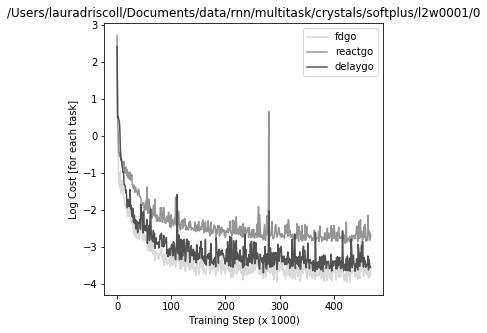

In [8]:
task_set = hparams['rule_trains'][:3]
fig = plt.figure(figsize=(5, 5))
cmap=plt.get_cmap('Greys')
fname = os.path.join(model_dir_all, 'log.json')

with open(fname, 'r') as f:
    log_all = json.load(f)
for r in range(len(task_set)):
    c = cmap((r+1)/(len(task_set)+1))
    ax = fig.add_subplot(1,1,1)
    x = np.log(log_all['cost_'+task_set[r]])
    plt.plot(x,'-',c = c,label = task_set[r])
#     plt.plot(x,'o',c = c,label = task_set[r])
    ax.set_xlabel('Training Step (x 1000)')
    ax.set_ylabel('Log Cost [for each task]')
#     plt.ylim([-6,2])
    
plt.title(model_dir_all)
plt.legend()
plt.show()  

In [35]:
r

2

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt


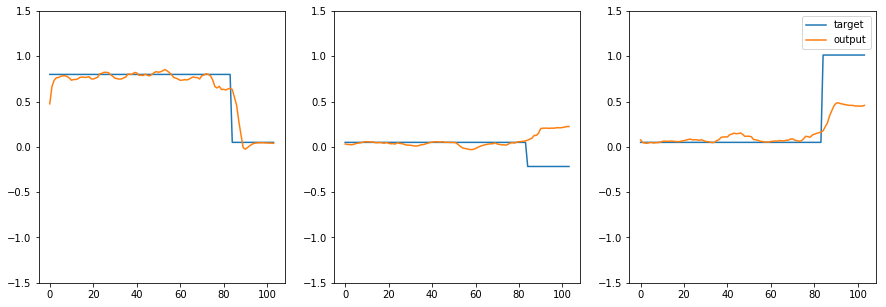

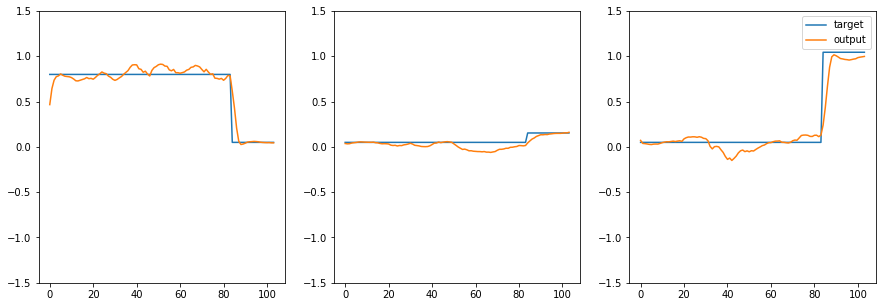

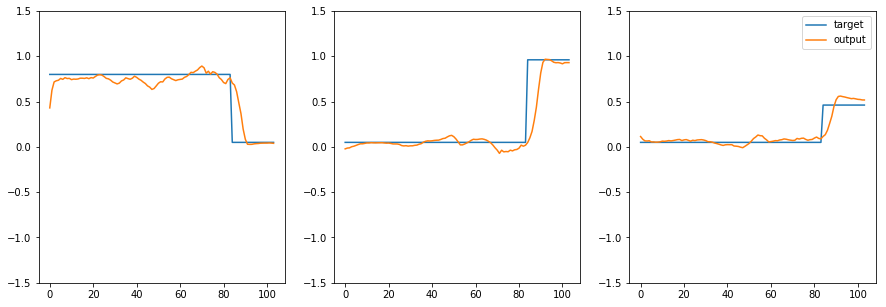

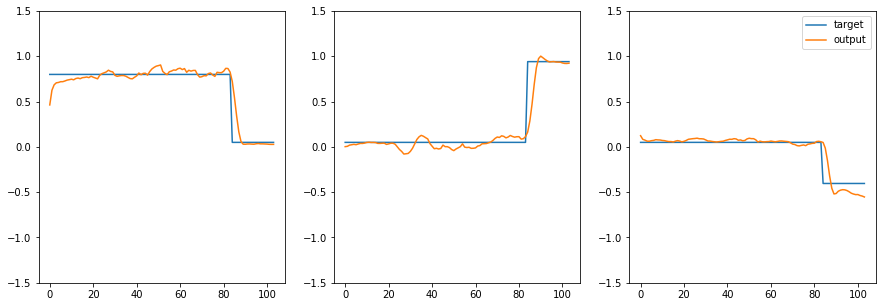

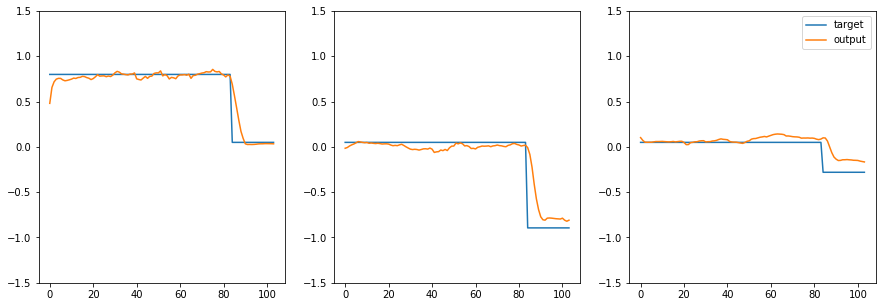

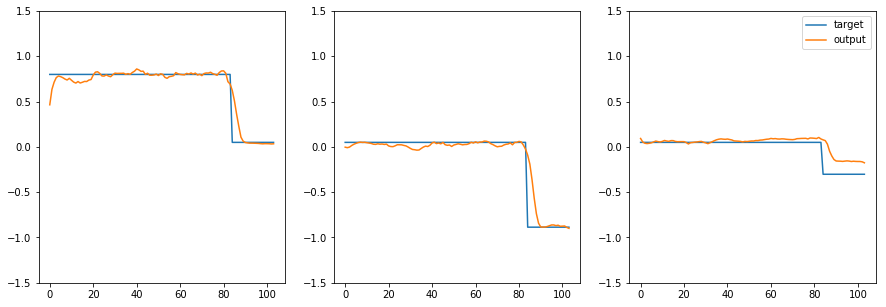

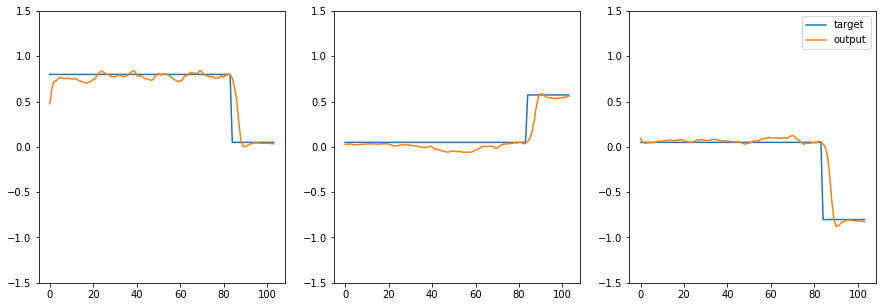

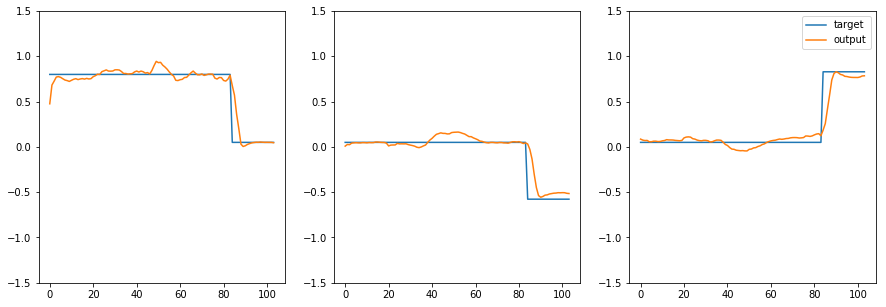

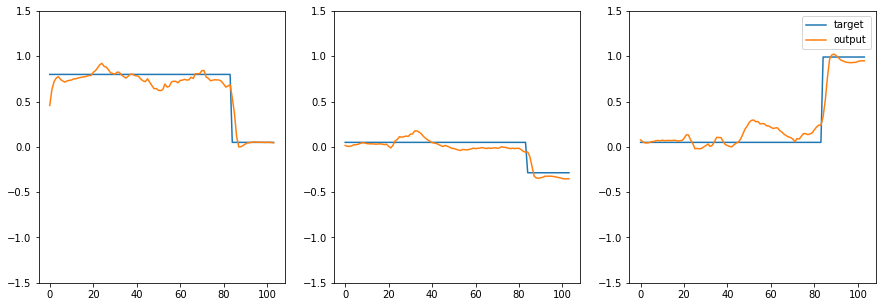

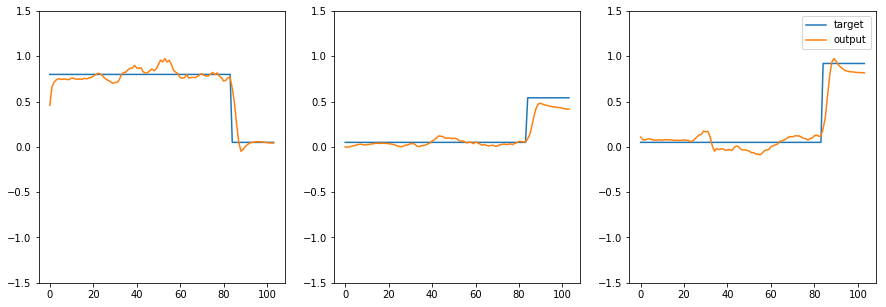

In [8]:
#These plots show some targets and outputs, again to show that the network looks sufficiently trained

rule = rules_dict['all'][13]
# ckpt_n = name_best_ckpt(model_dir_all,rule)
# ckpt_n_dir = os.path.join(model_dir_all,'ckpts/model.ckpt-' + str(int(ckpt_n)))

model = Model(model_dir_all)
with tf.Session() as sess:
    model.restore()#model.saver.restore(sess,ckpt_n_dir)
    model._sigma=0
    var_list = model.var_list
    hparams = model.hp
    trial = generate_trials(rule, hparams, mode='random', noise_on=True, batch_size =100, delay_fac =1)
    feed_dict = tools.gen_feed_dict(model, trial, hparams)
    h_tf, y_hat_tf = sess.run([model.h, model.y_hat], feed_dict=feed_dict) 
    
for y in range(10): # look at outputs compared to targets on 10 trials
    fig = plt.figure(figsize=(15, 5))
    for x in range(1,4): #three outputs
        ax = fig.add_subplot(1,3,x)
        plt.plot(trial.y[:,y,x-1],label = 'target')
        plt.plot(y_hat_tf[:,y,x-1],label = 'output')
        plt.ylim([-1.5,1.5])
        
    plt.legend()
    plt.show()

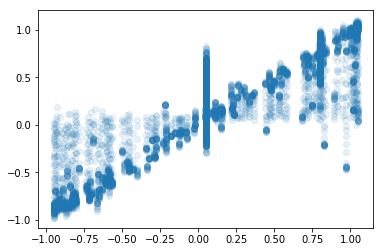

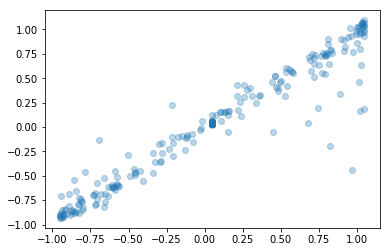

In [12]:
plt.plot(trial.y.flatten(),y_hat_tf.flatten(),'o',alpha = .1)
plt.show()

plt.plot(trial.y[-1,:,:].flatten(),y_hat_tf[-1,:,:].flatten(),'o',alpha = .3)
plt.show()

In [17]:
if net=='stepnet' or net == 'armnet':
    tasks = np.concatenate((range(6),range(11,20))) #
else:
    tasks = range(20)# 
count_back = 3
count_forward = 0
D_fix = make_h_combined_axes(model_dir_all,tasks,'fix1',count_back,count_forward,npc = 3,pc_inds = [0,1])

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/model.ckpt
(4500, 256)


In [24]:
if net=='stepnet' or net == 'armnet':
    tasks = np.concatenate((range(6),range(11,20))) #
else:
    tasks = range(20)# 
    
n_trials = np.shape(trial_master.x)[1]
trial_set = range(n_trials)
if n_trials>100:
    trial_set = range(0,n_trials,int(n_trials/100))
h_epoch = 'fix1'

s_all = np.sort(find_ckpts(model_dir_all))

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-1


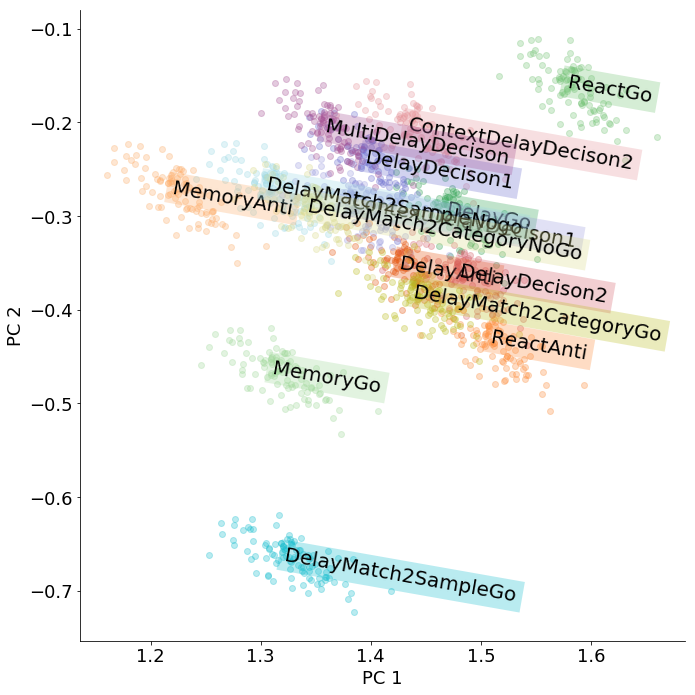

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-15000


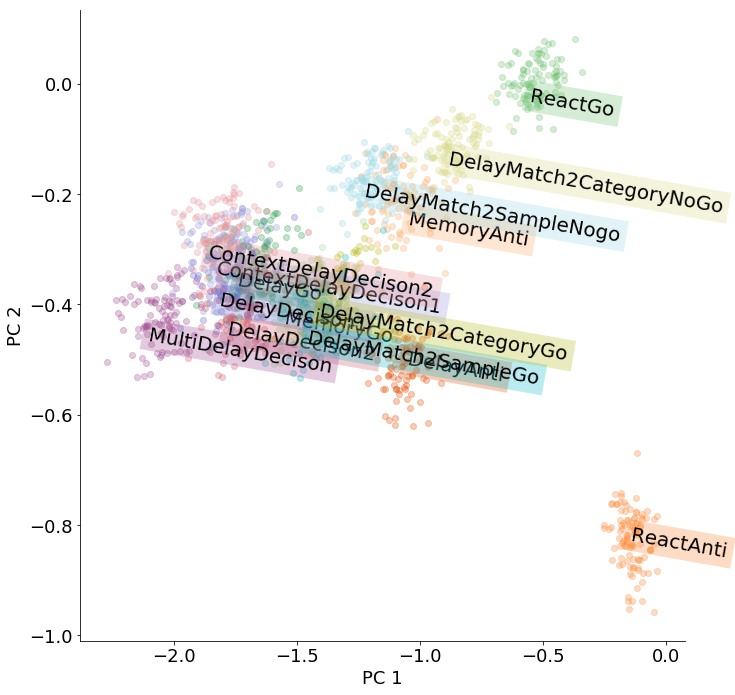

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-38000


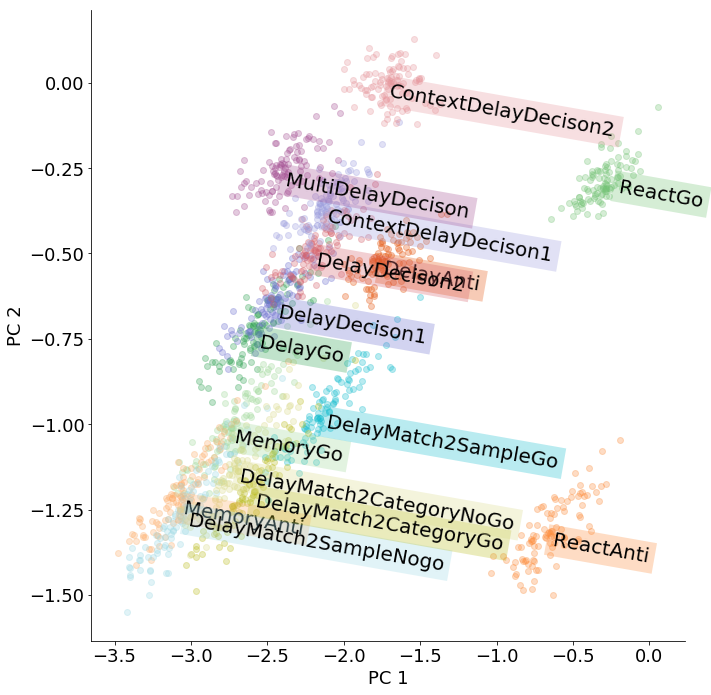

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-61000


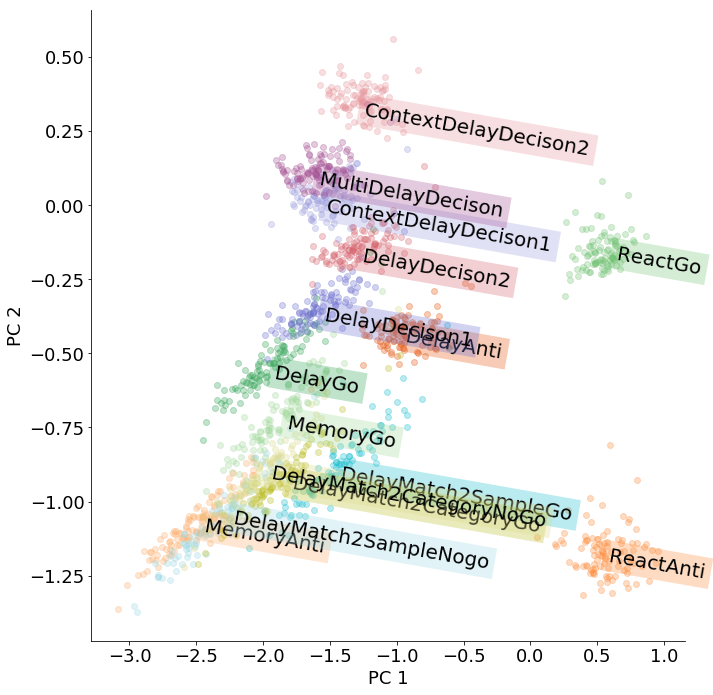

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-84000


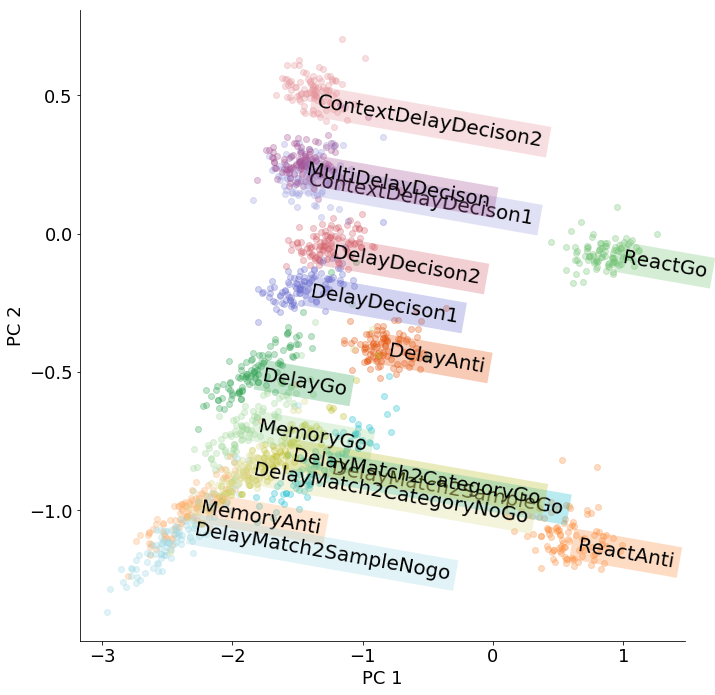

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-107000


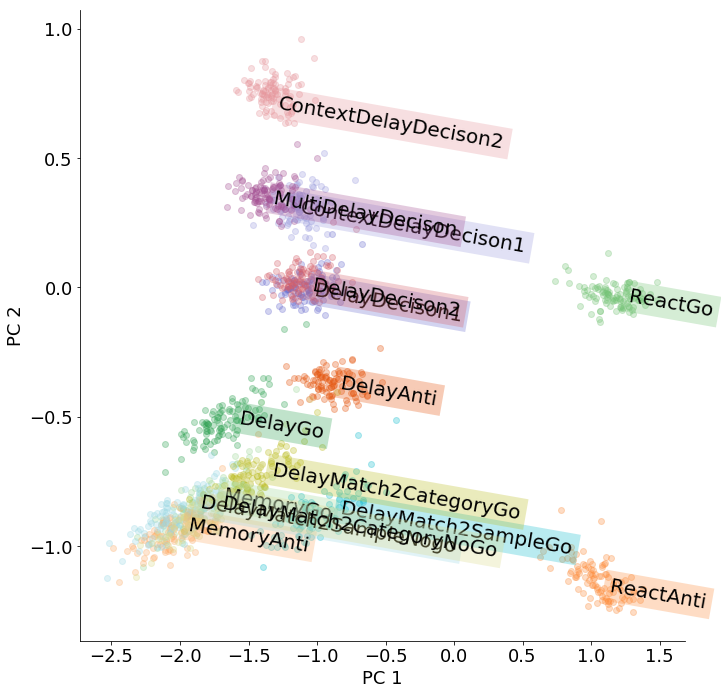

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-130000


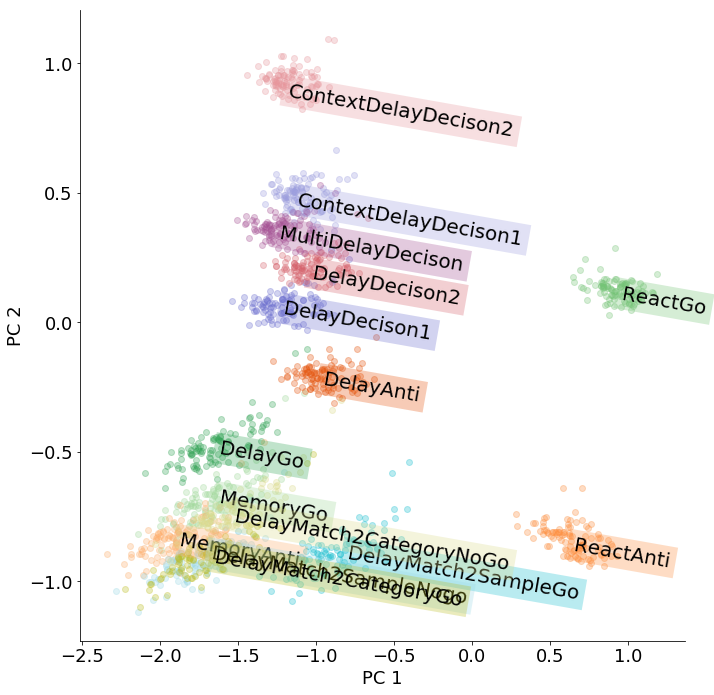

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-153000


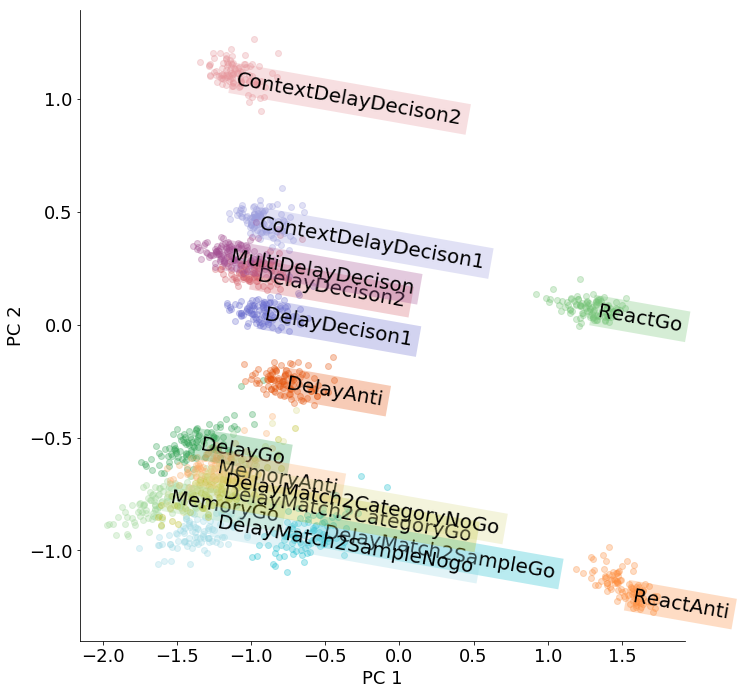

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-176000


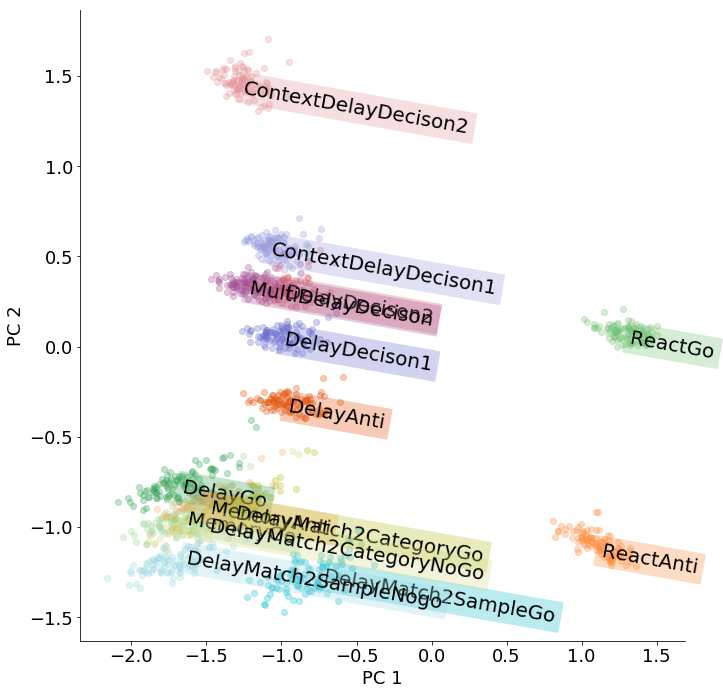

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-199000


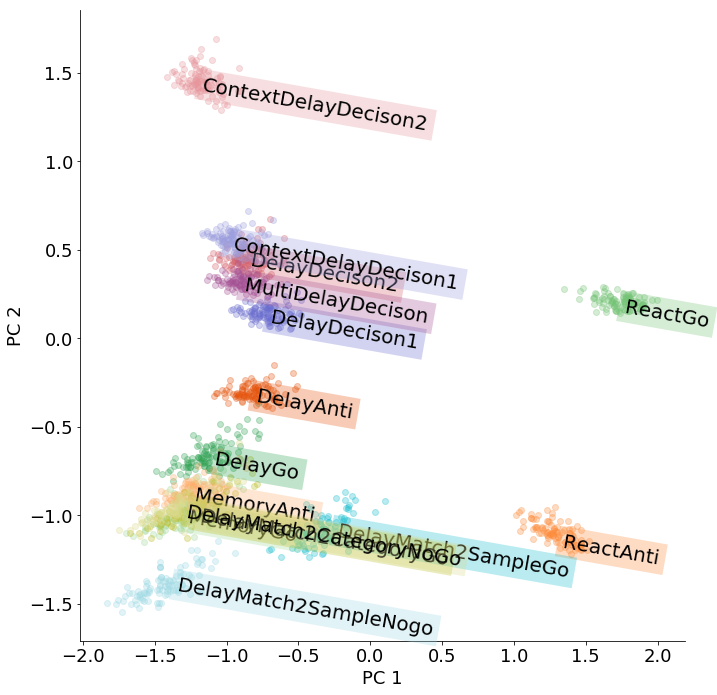

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-222000


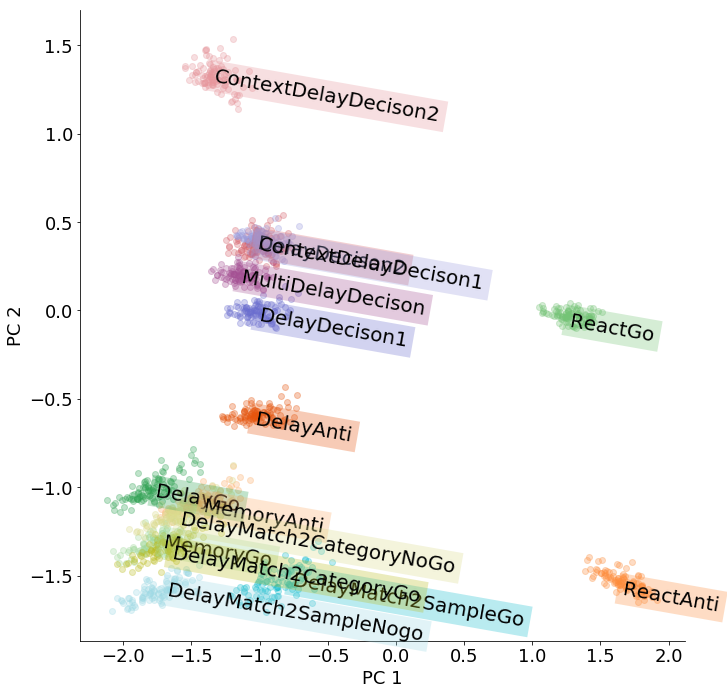

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-245000


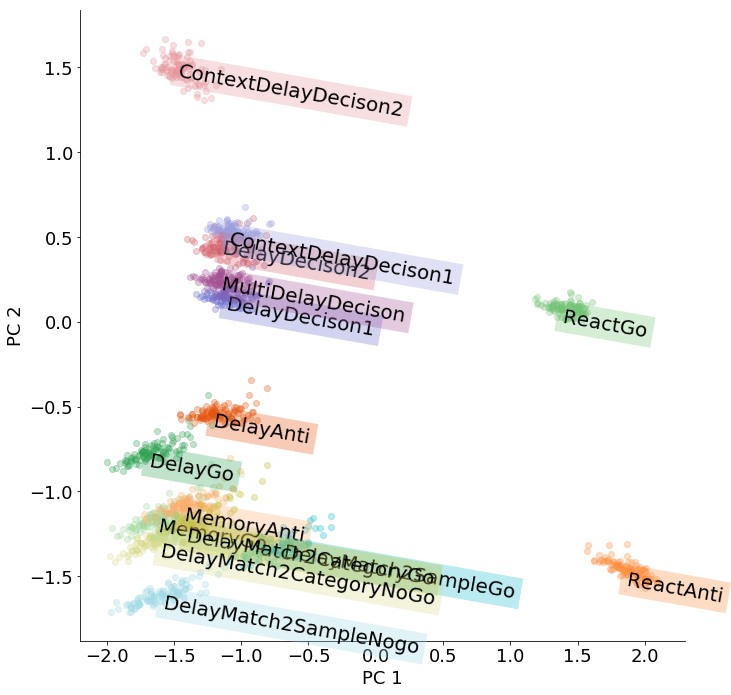

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-268000


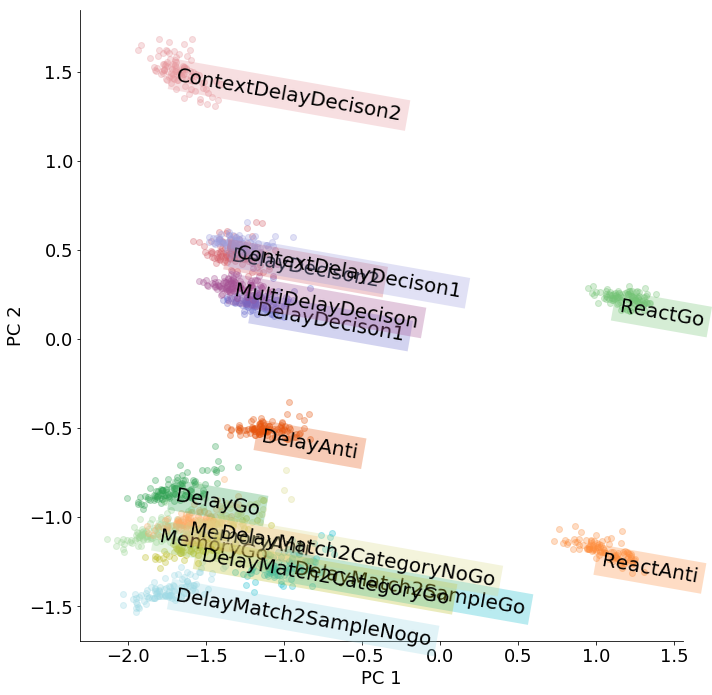

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-291000


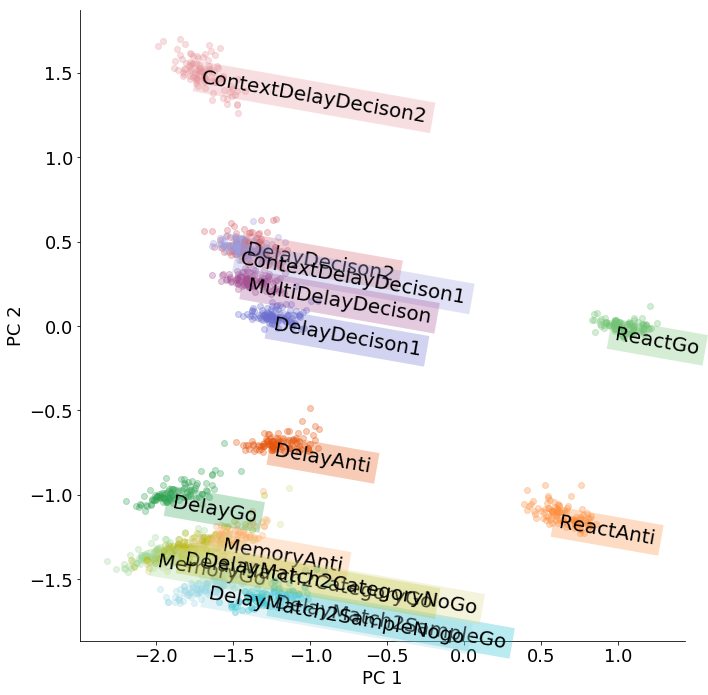

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-314000


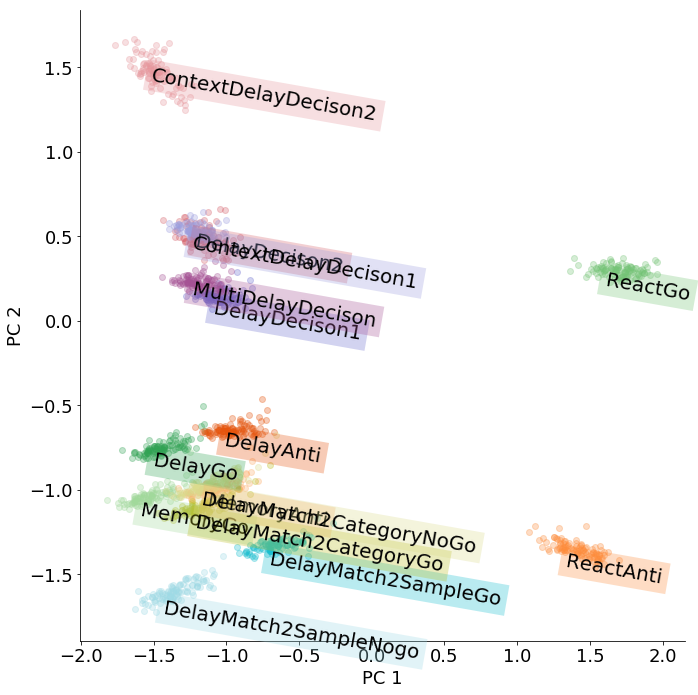

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-337000


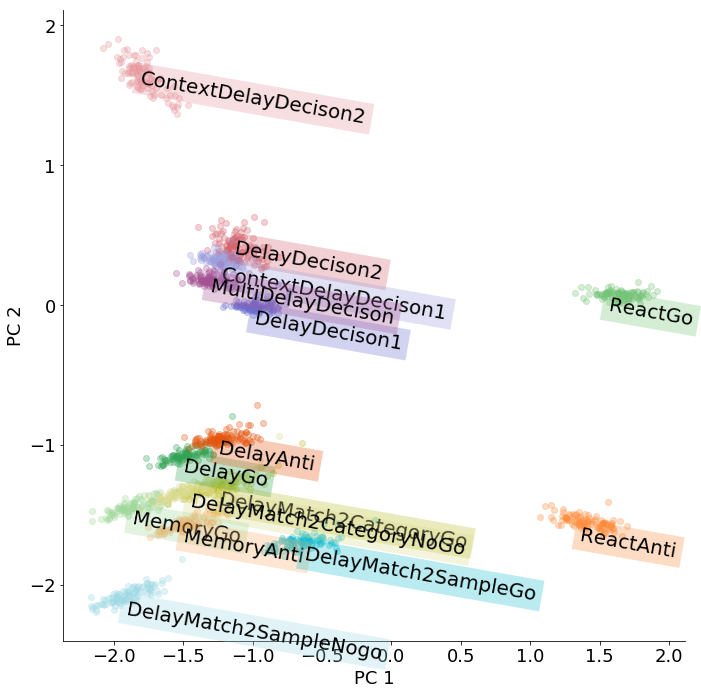

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-360000


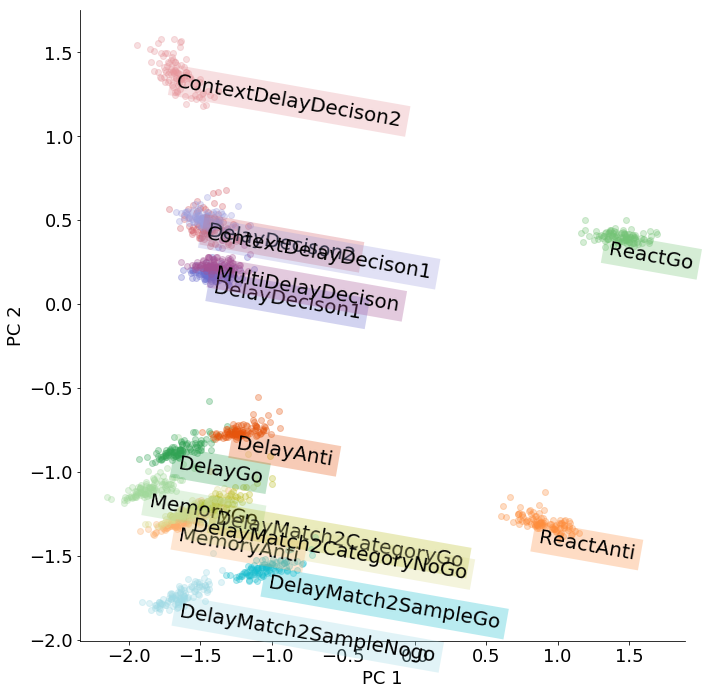

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-383000


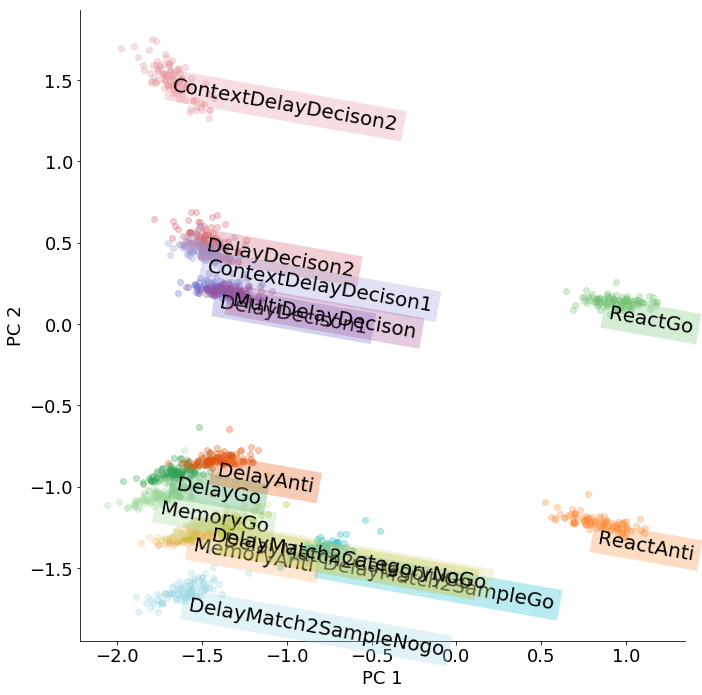

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-406000


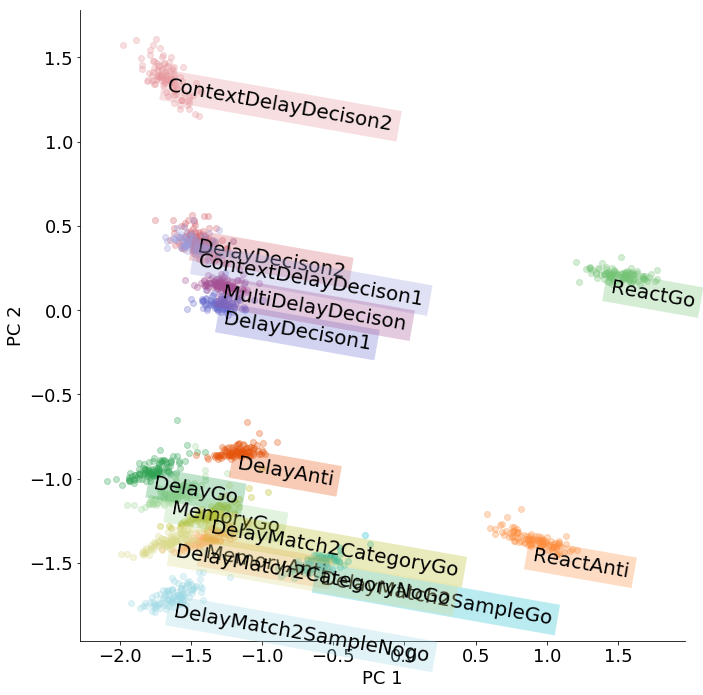

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-429000


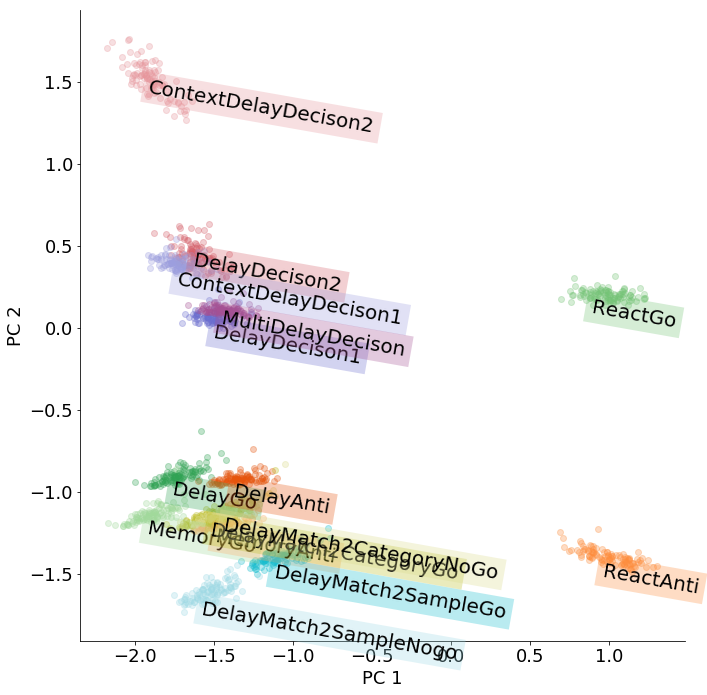

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-452000


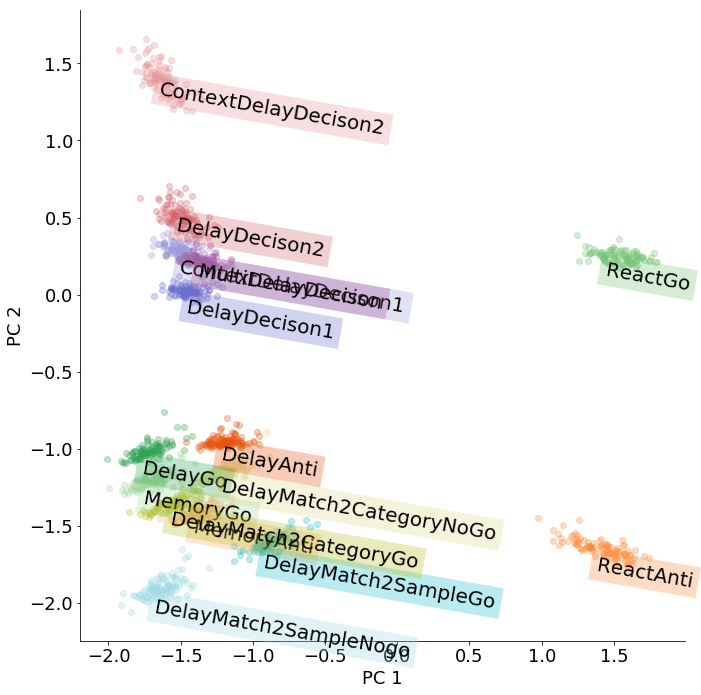

In [32]:
n_models = len(s_all)
for ckpt_n_ind in range(0,n_models,int(n_models/20)):
    ckpt_n = s_all[ckpt_n_ind]
    ckpt_n_dir = os.path.join(model_dir_all,'ckpts/model.ckpt-' + str(int(ckpt_n)))
    
    fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')
    plt.rcParams.update({'font.size': 18})
    
    ax = plt.subplot(1,1,1)
    plot_h_struct_multi_context(model_dir_all,ckpt_n_dir,tasks,trial_set,trial_master,D_fix,h_epoch,
                                color_inds,rot = -10,dot_alpha = .3)

    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    plt.savefig(fldr+'Context_wRT_'+str(int(ckpt_n))+'.pdf')
    plt.savefig(fldr+'Context_wRT_'+str(int(ckpt_n))+'.png')
    plt.show()

In [24]:
rule = 'delaygo'
model = Model(model_dir_all)
with tf.Session() as sess:

    model.restore()#model.saver.restore(sess,ckpt_n_dir
    # get all connection weights and biases as tensorflow variables
    var_list = model.var_list
    # evaluate the parameters after training
    params = [sess.run(var) for var in var_list]
    # get hparams
    hparams = model.hp
    trial_master = generate_trials(rule, hparams, mode = 'test', batch_size = 100, noise_on=True, delay_fac =1)   

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/model.ckpt


In [25]:
from sklearn.neighbors import DistanceMetric
ckpt_n = name_best_ckpt(model_dir_all,'delaygo')
ckpt_n_dir = os.path.join(model_dir_all,'ckpts/model.ckpt-' + str(int(ckpt_n)))

n_total_trials = np.shape(trial_master.x)[1] # num trials in delaygo task
n_trials_use = 8
skip_trials = int(n_total_trials/n_trials_use)
#mod1 and mod2 are every other trial so we grab 8 trials from both groups spanning 360 stim angles
trial_set = np.concatenate((range(0,n_total_trials,skip_trials),range(1,n_total_trials,skip_trials)))
tasks = np.concatenate((range(6),range(11,20)))
h_context_combined, h_stim_late_combined, h_stim_early_combined = make_h_combined(model_dir_all,ckpt_n_dir,tasks,trial_set,n_steps_early = 5)

# Distances across different tasks
dist = DistanceMetric.get_metric('euclidean')
X_euc_context = dist.pairwise(np.squeeze(h_context_combined))
X_euc_stim_early = dist.pairwise(np.squeeze(h_stim_early_combined-h_context_combined))
X_euc_stim_late = dist.pairwise(np.squeeze(h_stim_late_combined-h_stim_early_combined))


Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000


/Users/lauradriscoll/anaconda2/envs/tensorflow/lib/python2.7/site-packages/matplotlib/figure.py:2299: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


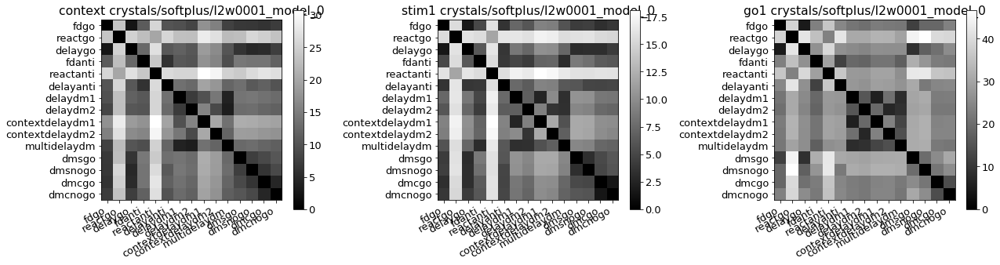

In [16]:
task_names_sorted = [rules_dict['all'][i] for i in tasks]
titles = ['context','stim1','go1']

fig = plt.figure(figsize=(18, 5),tight_layout=True,facecolor='white')
plt.rcParams.update({'font.size': 13})

ax = plt.subplot(1,len(titles),1)
plt.imshow(X_euc_context,cmap = 'gray')
plt.title(titles[0]+' '+dir_specific_all+'_model_'+str(model_n))
ax.set_xticks(range(0,len(tasks)))
ax.set_yticks(range(0,len(tasks)))
ax.set_yticklabels(task_names_sorted)
fig.autofmt_xdate()
ax.set_xticklabels(task_names_sorted)
plt.colorbar()

ax = plt.subplot(1,len(titles),2)
plt.imshow(X_euc_stim_early,cmap = 'gray')
plt.title(titles[1]+' '+dir_specific_all+'_model_'+str(model_n))
ax.set_xticks(range(0,len(tasks)))
ax.set_yticks(range(0,len(tasks)))
ax.set_yticklabels(task_names_sorted)
fig.autofmt_xdate()
ax.set_xticklabels(task_names_sorted)
plt.colorbar()

ax = plt.subplot(1,len(titles),3)
plt.imshow(X_euc_stim_late,cmap = 'gray')
plt.title(titles[2]+' '+dir_specific_all+'_model_'+str(model_n))
ax.set_xticks(range(0,len(tasks)))
ax.set_yticks(range(0,len(tasks)))
ax.set_yticklabels(task_names_sorted)
fig.autofmt_xdate()
ax.set_xticklabels(task_names_sorted)
plt.colorbar()

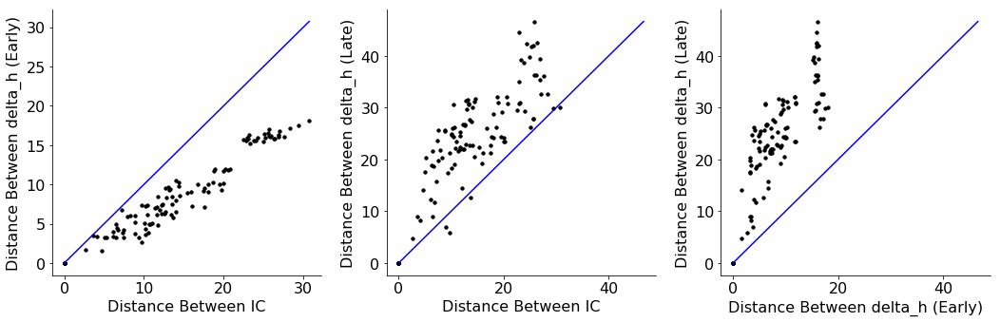

In [20]:
fig = plt.figure(figsize=(15, 5),tight_layout=True,facecolor='white')
plt.rcParams.update({'font.size': 16})

ax1 = plt.subplot(1,3,1)
plt.plot(X_euc_context.flatten(),X_euc_stim_early.flatten(),'.k')
plt.plot([0,np.max(X_euc_context.flatten())],[0,np.max(X_euc_context.flatten())],'-b')
ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
plt.xlabel('Distance Between IC')
plt.ylabel('Distance Between delta_h (Early)')

ax3 = plt.subplot(1,3,2)
plt.plot(X_euc_context.flatten(),X_euc_stim_late.flatten(),'.k')
plt.plot([0,np.max(X_euc_stim_late.flatten())],[0,np.max(X_euc_stim_late.flatten())],'-b')
ax3.spines['right'].set_visible(False)
ax3.spines['top'].set_visible(False)
plt.xlabel('Distance Between IC')
plt.ylabel('Distance Between delta_h (Late)')

ax2 = plt.subplot(1,3,3)
plt.plot(X_euc_stim_early.flatten(),X_euc_stim_late.flatten(),'.k')
plt.plot([0,np.max(X_euc_stim_late.flatten())],[0,np.max(X_euc_stim_late.flatten())],'-b')
ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
plt.xlabel('Distance Between delta_h (Early)')
plt.ylabel('Distance Between delta_h (Late)')
plt.show()

In [26]:
dir_specific_all = 'crystals/softplus/l2h00001'#'crystals/softplus/l2w0001'#''crystals/softplus/l2h00001'#'crystals/softplus/l2h00001'#'stepnet/crystals/softplus/'#grad_norm_both/'#'lowD/combos'#'stepnet/lowD/tanh'#'lowD/grad_norm_l2001' #' #'lowD/armnet_noreg'#lowD/combos' ##grad_norm_l2h000001' /Documents/data/rnn/multitask/varGo/lowD/most/
n_trials = np.shape(trial_master.x)[1]
trial_set = range(0,n_trials,int(n_trials/50))
time_set = (trial_master.epochs['stim1'][0],)

J_u_delu = {}
J_x = {}

for model_n in range(4):
    model_dir_all = os.path.join(p,'data/rnn/multitask/',dir_specific_all,str(model_n))
    ckpt_n = name_best_ckpt(model_dir_all,rule)
    ckpt_n_dir = os.path.join(model_dir_all,'ckpts/model.ckpt-' + str(int(ckpt_n)))
    
    J_u_delu = make_Jac_u_dot_delu(model_dir_all,ckpt_n_dir,rule,tasks,time_set,trial_set)
    J_x = make_Jac_x(model_dir_all,ckpt_n_dir,rule,tasks,time_set,trial_set)
        

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=flo

KeyboardInterrupt: 

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 7) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(7,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt


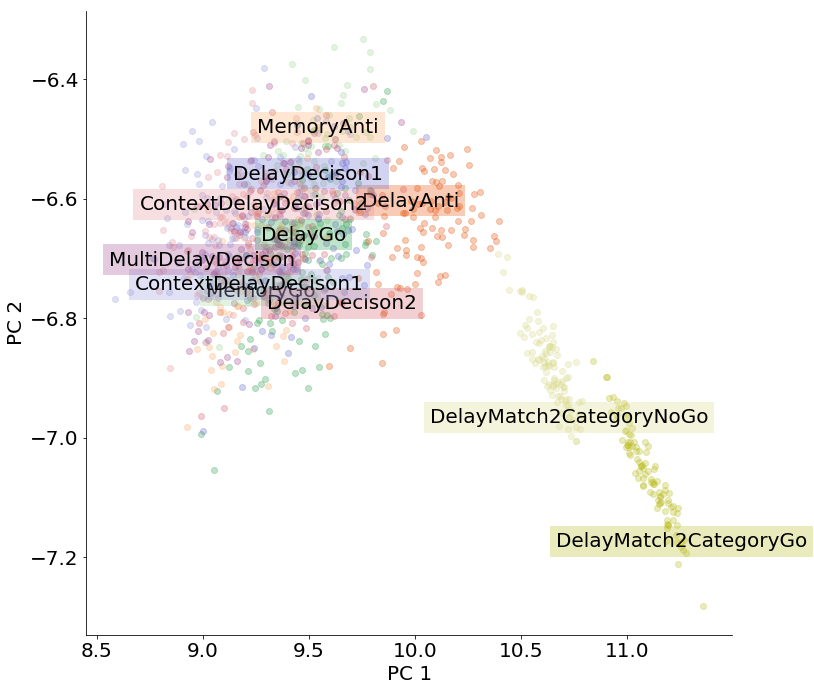

In [20]:
if net=='stepnet' or net == 'armnet':
    tasks = np.concatenate(([0,2,3,5],range(11,16),[18,19])) #
else:
    tasks = np.concatenate(([0,2,3,5],range(6,16),[18,19])) # 
    
n_trials = np.shape(trial_master.x)[1]
trial_set = range(n_trials)
if n_trials>100:
    trial_set = range(0,n_trials,int(n_trials/100))
h_epoch = 'fix1'
fig = plt.figure(figsize=(20,10),tight_layout=True,facecolor='white')
ax = plt.subplot(1,2,1)
plt.rcParams.update({'font.size': 20})
plot_h_struct_multi_context(model_dir_all,tasks,trial_set,trial_master,D_fix,h_epoch,
                            color_inds,rot = 0,dot_alpha = .3)

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

plt.savefig(fldr+'Context_woRT.pdf')
plt.savefig(fldr+'Context_woRT.png')
plt.show()

In [21]:
# from sklearn.manifold import MDS
# tasks = np.concatenate(([0,2,3,5],range(6,20))) # 
# h_context_combined = []
# task_id = []
# epoch = 'fix1'

# model = Model(model_dir_all)
# with tf.Session() as sess:

# #     rule = 'delaygo'
#     model.saver.restore(sess,ckpt_n_dir)
#     # get all connection weights and biases as tensorflow variables
#     var_list = model.var_list
#     # evaluate the parameters after training
#     params = [sess.run(var) for var in var_list]
#     # get hparams
#     hparams = model.hp

#     for r in range(len(tasks)):
#         r_all_tasks_ind = tasks[r]

#         trial = generate_trials(rules_dict['all'][r_all_tasks_ind], hparams, mode = 'random', batch_size = 1, noise_on = False, delay_fac =1)
#         epoch_inds = np.min(trial.epochs[epoch][1]-1,)
#         feed_dict = tools.gen_feed_dict(model, trial, hparams)
#         h_tf = sess.run(model.h, feed_dict=feed_dict) #(n_time, n_trials, n_neuron)
#         h_context = h_tf[epoch_inds,:,:] # h @ end of context period
#         h_context = np.reshape(h_context,(-1,np.shape(h_tf)[2]))
#         task_id_temp = np.repeat(int(r_all_tasks_ind), np.shape(h_context)[0])

#         #concatenate activity states across tasks
#         if np.shape(h_context_combined)[0] == 0:
#             h_context_combined = h_context
#             task_id = task_id_temp
#         else:
#             h_context_combined = np.concatenate((h_context_combined, h_context), axis=0)
#             task_id = np.concatenate((task_id, task_id_temp), axis=0)
            
# X = np.squeeze(h_context_combined).astype(np.float64)
# row_means = np.mean(X, axis=0)
# row_var = np.var(X, axis=0)
# X_center = X - np.tile(row_means,(X.shape[0],1))
# X_ball = np.true_divide(X - np.tile(row_means,(X.shape[0],1)), np.tile(row_var,(X.shape[0],1)))

# embedding = MDS(n_components=2)
# X_transformed = embedding.fit_transform(X_center)

In [22]:
# fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')
# plt.rcParams.update({'font.size': 20})
# plot_h_struct_multi_context_mds(model_dir_all,ckpt_n_dir,task_id,X_transformed,rot = -10,dot_alpha = .3)

In [23]:
def plot_h_struct_multi_stim(model_dir_all,tasks,trial_set,trial_master,D,h_epoch,
                             color_inds,rot = 0,dot_alpha = .5,line_alpha = .5):
    
    T_end = trial_master.epochs[h_epoch][1]
    if T_end is None:
        T_end = np.shape(trial_master.x)[0]-1

    T_start = trial_master.epochs[h_epoch][0]
    if T_start is None:
        T_start = 1
    
    model = Model(model_dir_all)
    with tf.Session() as sess:
        model.restore()
        hparams = model.hp

        for rule_ind in tasks:
            trial = same_stim_trial(trial_master, rule_ind)
            feed_dict = tools.gen_feed_dict(model, trial, hparams)
            h_tf, _ = sess.run([model.h, model.y_hat], feed_dict=feed_dict) #(n_time, n_condition, n_neuron)

            for s in trial_set:
                
                ax1 = plt.subplot(1,2,1)
                c = color_inds[rule_ind]
                X_trial = np.dot(h_tf[range(T_start-1,T_end),s,:],D)
#                 plt.plot(X_trial[0,0],X_trial[0,1],'^',c = c, linewidth = 1,alpha = line_alpha)
#                 plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 1,alpha = line_alpha)
                
                if s==trial_set[0]:
                    plt.plot(X_trial[0,0],X_trial[0,1],'o',c = c, markersize = 10,alpha = dot_alpha,label = rule_set_names[rule_ind])
                    plt.plot(X_trial[-1,0],X_trial[-1,1],'^',c = c, markersize = 3,alpha = dot_alpha)
                    plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 1.5,alpha = line_alpha)
                else:
                    plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 1.5,alpha = line_alpha)
                    plt.plot(X_trial[-1,0],X_trial[-1,1],'^',c = c, markersize = 3,alpha = dot_alpha)
                    
                    
                    
                ax2 = plt.subplot(1,2,2)
                cmap=plt.get_cmap('rainbow')
                c = cmap(s/np.max(trial_set))
                
                if s==trial_set[0]:
#                     plt.plot(X_trial[0,0],X_trial[0,1],'o',c = c, markersize = 10,alpha = dot_alpha,label = rule_set_names[rule_ind])
                    plt.plot(X_trial[-1,0],X_trial[-1,1],'^',c = c, markersize = 3,alpha = dot_alpha)
                    plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 1.5,alpha = line_alpha)
                else:
                    plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 1.5,alpha = line_alpha)
                    plt.plot(X_trial[-1,0],X_trial[-1,1],'^',c = c, markersize = 3,alpha = dot_alpha)
        
        ax2.spines['right'].set_visible(False)
        ax2.spines['top'].set_visible(False)
        plt.xlabel('PC1')
        plt.ylabel('PC2') 
        plt.title('Stimulus Activity Colored by Stimulus')
        
        ax1.spines['right'].set_visible(False)
        ax1.spines['top'].set_visible(False)
        plt.subplot(1,2,1)        
        plt.xlabel('PC1')
        plt.ylabel('PC2') 
        plt.title('Stimulus Activity Colored by Task')

In [24]:
if net=='stepnet' or net == 'armnet':
    tasks = np.concatenate(([0,2,3,5],range(11,20))) #
else:
    tasks = np.concatenate(([0,2,3,5],range(5,20))) # 
count_back = 1
count_forward = 0
D_stim = make_h_combined_axes(model_dir_all,tasks,'stim1',count_back,count_forward,npc = 3,pc_inds = [0,1])

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 7) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(7,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
(1300, 256)


Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 7) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(7,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 7) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(7,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
Model restored from 

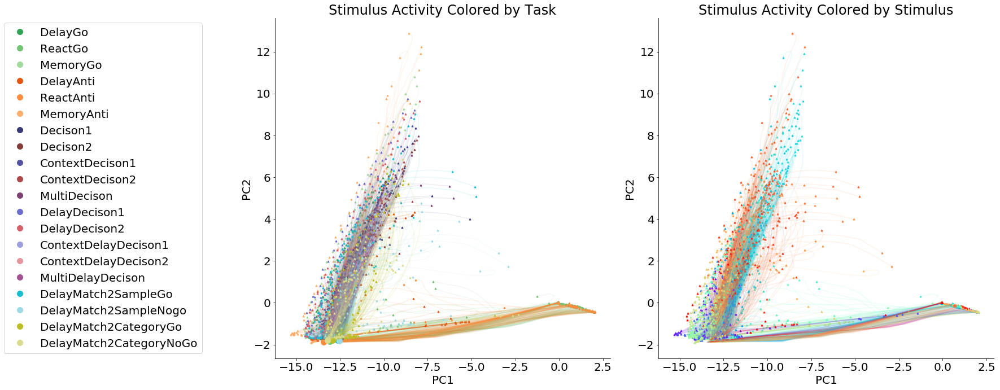

In [26]:
model = Model(model_dir_all)
with tf.Session() as sess:
    model.restore()
    # get all connection weights and biases as tensorflow variables
    var_list = model.var_list
    # evaluate the parameters after training
    params = [sess.run(var) for var in var_list]
    # get hparams
    hparams = model.hp
    trial_master = generate_trials('multidelaydm', hparams, mode = 'test', batch_size = 100, noise_on=False, delay_fac =1)  

if net=='stepnet' or net == 'armnet':
    tasks = np.concatenate(([0,1,2,3,4,5],range(11,20))) #
#     count_forward = 2
    count_forward = 5
else:
    tasks = np.concatenate(([0,1,2,3,4,5],range(5,20))) # 
    count_forward = 5
    
count_back = 1
D_fix = make_h_combined_axes(model_dir_all,tasks,'fix1',count_back,count_forward,npc = 3,pc_inds = [0,1])

n_trials = np.shape(trial_master.x)[1]
tasks = range(20)
trial_set = range(0,n_trials,int(n_trials/100))
h_epoch = 'stim1'
fig = plt.figure(figsize=(25,10),tight_layout=True,facecolor='white')
plot_h_struct_multi_stim(model_dir_all,tasks,trial_set,trial_master,D_fix,h_epoch,
                            color_inds,rot = 0,dot_alpha = 1,line_alpha = .1)
plt.savefig(fldr+'Stim_Dfix_AllTasks.pdf')
plt.savefig(fldr+'Stim_Dfix_AllTasks.png')
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 7) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(7,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
(3000, 256)
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 7) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(7,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
Model re

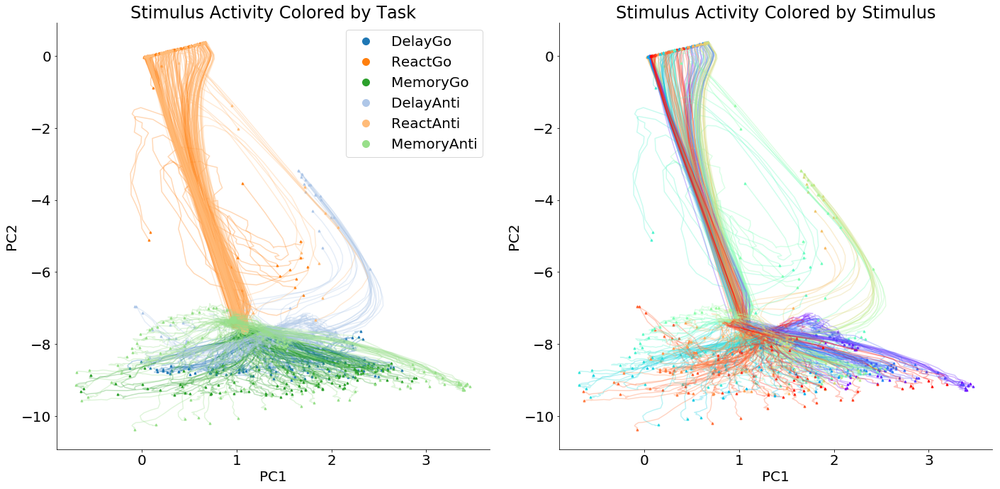

In [28]:
tasks = range(6)
count_back = 5
count_forward = 0
D_fix = make_h_combined_axes(model_dir_all,tasks,'fix1',count_back,count_forward,npc = 4,pc_inds = [1,3])
color_inds_anti = (tab20(0/20),tab20(2/20),tab20(4/20),tab20(1/20),tab20(3/20),tab20(5/20))

n_trials = np.shape(trial_master.x)[1]
trial_set = range(0,n_trials,int(n_trials/100))
h_epoch = 'stim1'
fig = plt.figure(figsize=(20,10),tight_layout=True,facecolor='white')
plot_h_struct_multi_stim(model_dir_all,tasks,trial_set,trial_master,D_fix,h_epoch,
                            color_inds_anti,rot = 0,dot_alpha = 1,line_alpha = .3)
plt.legend()
plt.savefig(fldr+'Stim_Dfix_6Tasks.pdf')
plt.savefig(fldr+'Stim_Dfix_6Tasks.png')
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 7) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(7,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
(2000, 256)
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 7) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(7,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
Model re

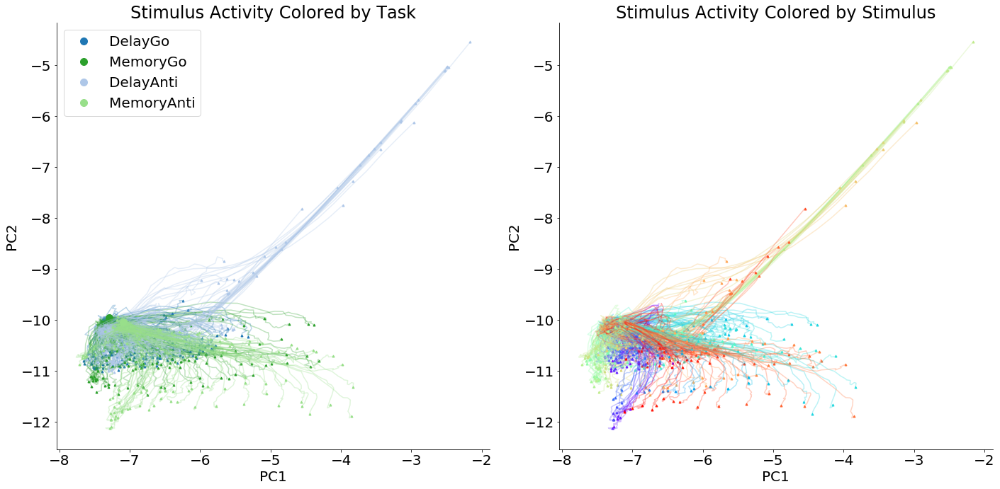

In [30]:
tasks = [0,2,3,5]
count_back = 5
count_forward = 0
D_fix = make_h_combined_axes(model_dir_all,tasks,'fix1',count_back,count_forward,npc = 4,pc_inds = [1,3])
color_inds_anti = (tab20(0/20),tab20(2/20),tab20(4/20),tab20(1/20),tab20(3/20),tab20(5/20))

n_trials = np.shape(trial_master.x)[1]
tasks = [0,2,3,5]
trial_set = range(0,n_trials,int(n_trials/100))
h_epoch = 'stim1'
fig = plt.figure(figsize=(20,10),tight_layout=True,facecolor='white')
plot_h_struct_multi_stim(model_dir_all,tasks,trial_set,trial_master,D_fix,h_epoch,
                            color_inds_anti,rot = 0,dot_alpha = 1,line_alpha = .3)
plt.legend()
plt.savefig(fldr+'Stim_Dfix_4Tasks.pdf')
plt.savefig(fldr+'Stim_Dfix_4Tasks.png')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 7) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(7,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
(2000, 256)
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 7) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(7,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
Model re

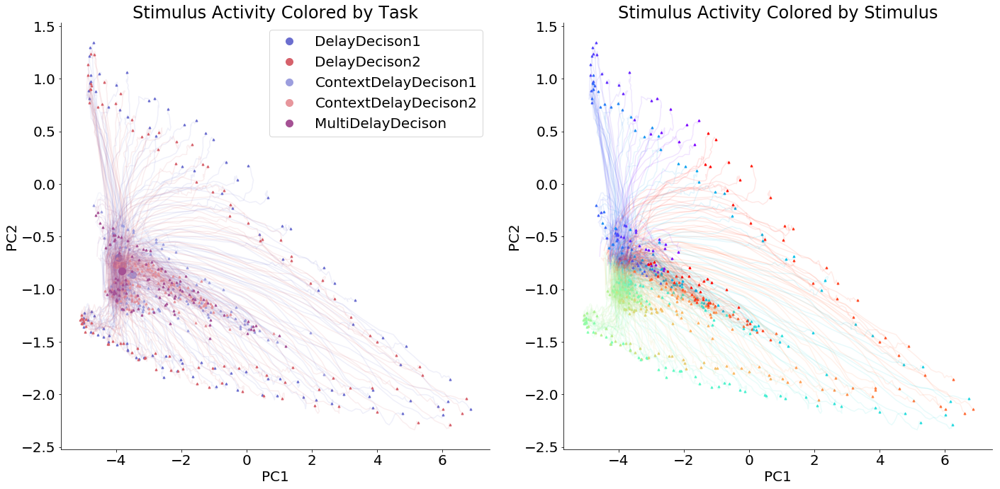

In [31]:
# tasks = np.concatenate(([0,2,3],range(5,20))) # 
tasks = range(12,16)
count_back = 0
count_forward = 5
D_fix = make_h_combined_axes(model_dir_all,tasks,'fix1',count_back,count_forward,npc = 2,pc_inds = [0,1])

tasks = range(11,16)
n_trials = np.shape(trial_master.x)[1]

trial_set = range(0,n_trials,int(n_trials/100))
h_epoch = 'stim1'
fig = plt.figure(figsize=(20,10),tight_layout=True,facecolor='white')
plot_h_struct_multi_stim(model_dir_all,tasks,trial_set,trial_master,D_fix,h_epoch,
                            color_inds,rot = 0,dot_alpha = 1,line_alpha = .1)
plt.legend()
plt.savefig(fldr+'Stim_Dfix_DelayTasks.pdf')
plt.savefig(fldr+'Stim_Dfix_DelayTasks.png')
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 7) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(7,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
(2400, 256)
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 7) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(7,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
Model re

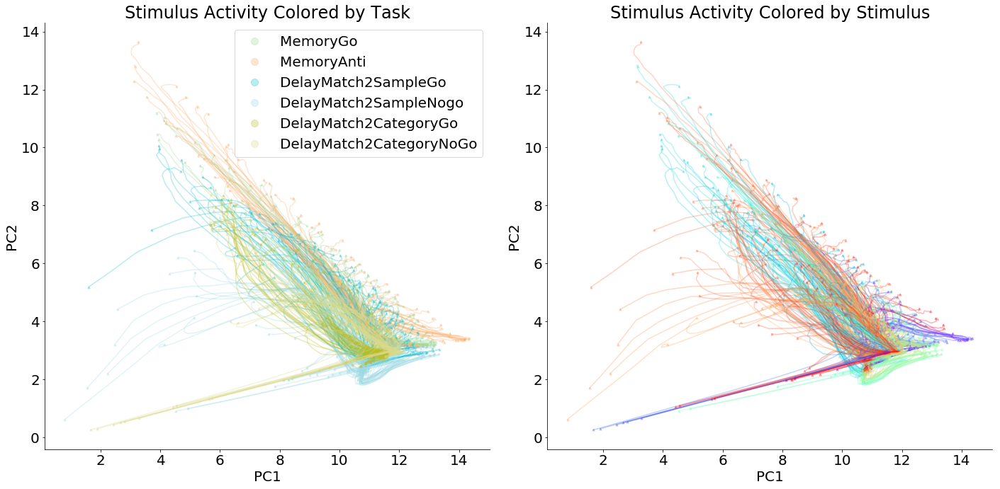

In [33]:
tasks = [2,5,16,17,18,19]
count_back = 1
count_forward = 3
D_fix = make_h_combined_axes(model_dir_all,tasks,'fix1',count_back,count_forward,npc = 2,pc_inds = [0,1])

n_trials = np.shape(trial_master.x)[1]

trial_set = range(0,n_trials,int(n_trials/100))
h_epoch = 'stim1'
fig = plt.figure(figsize=(20,10),tight_layout=True,facecolor='white')
plot_h_struct_multi_stim(model_dir_all,tasks,trial_set,trial_master,D_fix,h_epoch,
                            color_inds,rot = 0,dot_alpha = .3,line_alpha = .3)
plt.legend()
plt.savefig(fldr+'Stim_Dfix_DMSTasks.pdf')
plt.savefig(fldr+'Stim_Dfix_DMSTasks.png')
plt.show()


In [34]:
tasks = np.concatenate(([0,2,3,5],range(11,20))) # 
count_back = 1
count_forward = 0
D_stim = make_h_combined_axes(model_dir_all,tasks,'stim1',count_back,count_forward,npc = 2,pc_inds = [0,1])

n_trials = np.shape(trial_master.x)[1]
trial_set = range(0,n_trials,int(n_trials/100))
h_epoch = 'stim1'
tasks = range(6)
fig = plt.figure(figsize=(20,10),tight_layout=True,facecolor='white')
plot_h_struct_multi_stim(model_dir_all,tasks,trial_set,trial_master,D_stim,h_epoch,
                            color_inds_anti,rot = 0,dot_alpha = .1)

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 7) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(7,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
Model restored from file: /Users/lauradriscoll/Documents/data/rnn/multitask/lowD/armnet_noreg/most/0/model.ckpt
(1300, 256)


NameError: name 'ckpt_n_dir' is not defined

<Figure size 1440x720 with 0 Axes>

In [25]:
def plot_h_struct_multi_delay(model_dir_all,ckpt_n_dir,tasks,trial_set,trial_master,D,h_epoch,
                             color_inds,rot = 0,dot_alpha = .5,line_alpha = .5):
    
    T_end = trial_master.epochs[h_epoch][1]
    if T_end is None:
        T_end = np.shape(trial_master.x)[0]-1

    T_start = trial_master.epochs[h_epoch][0]
    if T_start is None:
        T_start = 1
    
    model = Model(model_dir_all)
    with tf.Session() as sess:
        model.saver.restore(sess,ckpt_n_dir)
        hparams = model.hp

        for rule_ind in tasks:
            trial = same_stim_trial(trial_master, rule_ind)
            feed_dict = tools.gen_feed_dict(model, trial, hparams)
            h_tf, _ = sess.run([model.h, model.y_hat], feed_dict=feed_dict) #(n_time, n_condition, n_neuron)

            for s in trial_set:
                
                plt.subplot(1,2,1)
                c = color_inds[rule_ind]
                X_trial = np.dot(h_tf[range(T_start-1,T_end),s,:],D)
#                 plt.plot(X_trial[0,0],X_trial[0,1],'^',c = c, linewidth = 1,alpha = line_alpha)
#                 plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 1,alpha = line_alpha)
                
                if s==trial_set[0]:
                    plt.plot(X_trial[0,0],X_trial[0,1],'o',c = c, markersize = 3,alpha = dot_alpha,label = rule_set_names[rule_ind])
                    plt.plot(X_trial[-1,0],X_trial[-1,1],'^',c = c, markersize = 3,alpha = dot_alpha)
                    plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 3,alpha = line_alpha)
                else:
                    plt.plot(X_trial[0,0],X_trial[0,1],'o',c = c, markersize = 3,alpha = dot_alpha)
                    plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 3,alpha = line_alpha)
                    plt.plot(X_trial[-1,0],X_trial[-1,1],'^',c = c, markersize = 3,alpha = dot_alpha)
                    
                    
                    
                plt.subplot(1,2,2)
                cmap=plt.get_cmap('rainbow')
                c = cmap(s/np.max(trial_set))
                
                if s==trial_set[0]:
                    plt.plot(X_trial[0,0],X_trial[0,1],'o',c = c, markersize = 3,alpha = dot_alpha)
                    plt.plot(X_trial[-1,0],X_trial[-1,1],'^',c = c, markersize = 3,alpha = dot_alpha)
                    plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 3,alpha = line_alpha)
                else:
                    plt.plot(X_trial[0,0],X_trial[0,1],'o',c = c, markersize = 3,alpha = dot_alpha)
                    plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 3,alpha = line_alpha)
                    plt.plot(X_trial[-1,0],X_trial[-1,1],'^',c = c, markersize = 3,alpha = dot_alpha)
              
        plt.xlabel('PC1')
        plt.ylabel('PC2') 
        plt.title('Stimulus Activity Colored by Stimulus')
        
        plt.subplot(1,2,1)        
        plt.xlabel('PC1')
        plt.ylabel('PC2') 
        plt.title('Stimulus Activity Colored by Task')

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-406000
(1200, 256)
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-406000


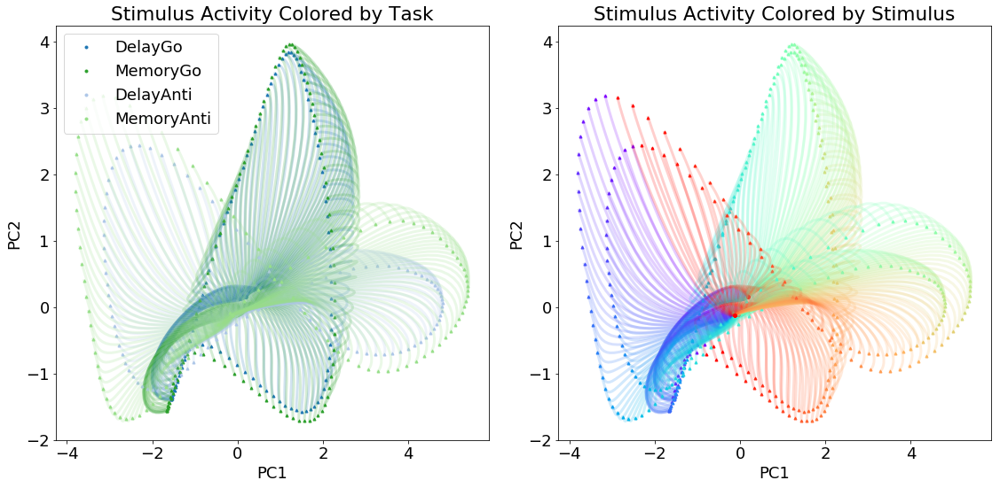

In [26]:
tasks = [2,3,5]
count_back = 2
count_forward = 2
D_stim = make_h_combined_axes(model_dir_all,tasks,'stim1',count_back,count_forward,npc = 4,pc_inds = [1,3])
color_inds_anti = (tab20(0/20),tab20(2/20),tab20(4/20),tab20(1/20),tab20(3/20),tab20(5/20))

n_trials = np.shape(trial_master.x)[1]
tasks = [0,2,3,5]
trial_set = range(0,n_trials,int(n_trials/100))
h_epoch = 'stim1'
plt.rcParams.update({'font.size': 18})
fig = plt.figure(figsize=(16,8),tight_layout=True,facecolor='white')
plot_h_struct_multi_delay(model_dir_all,ckpt_n_dir,tasks,trial_set,trial_master,D_stim,h_epoch,
                            color_inds_anti,rot = 0,dot_alpha = 1,line_alpha = .2)
plt.savefig(fldr+'Stim_Dfix_4Tasks.pdf')
plt.savefig(fldr+'Stim_Dfix_4Tasks.png')
plt.legend()
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-406000


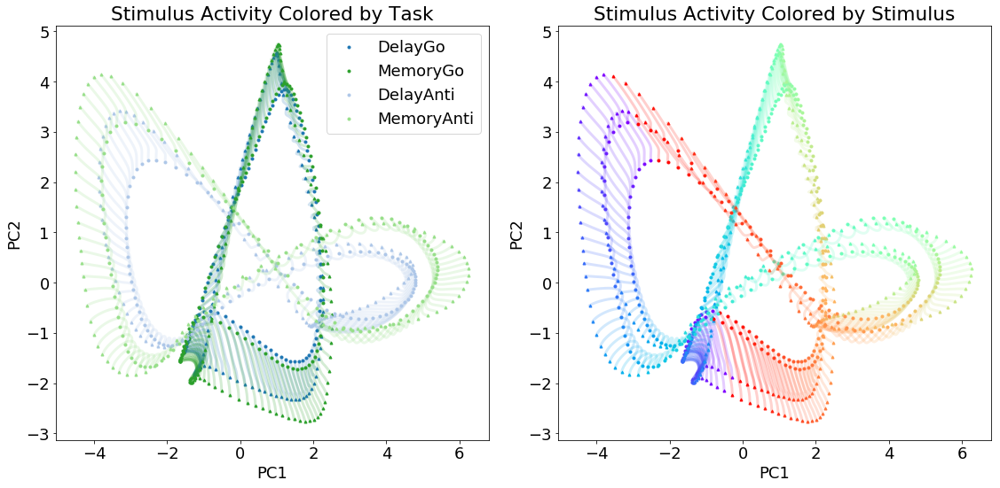

In [27]:
# tasks = np.concatenate(([2,3,5],range(11,20))) # 
# # tasks = [0,2,3,5]
# count_back = 1
# count_forward = 3
# D_stim = make_h_combined_axes(model_dir_all,tasks,'stim1',count_back,count_forward,npc = 4,pc_inds = [1,3])
color_inds_anti = (tab20(0/20),tab20(2/20),tab20(4/20),tab20(1/20),tab20(3/20),tab20(5/20))

n_trials = np.shape(trial_master.x)[1]
tasks = [0,2,3,5]
trial_set = range(0,n_trials,int(n_trials/100))
h_epoch = 'delay1'
plt.rcParams.update({'font.size': 18})
fig = plt.figure(figsize=(16,8),tight_layout=True,facecolor='white')
plot_h_struct_multi_delay(model_dir_all,ckpt_n_dir,tasks,trial_set,trial_master,D_stim,h_epoch,
                            color_inds_anti,rot = 0,dot_alpha = 1,line_alpha = .2)
plt.savefig(fldr+'Delay_Dfix_4Tasks.pdf')
plt.savefig(fldr+'Delay_Dfix_4Tasks.png')
plt.legend()
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-406000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-406000


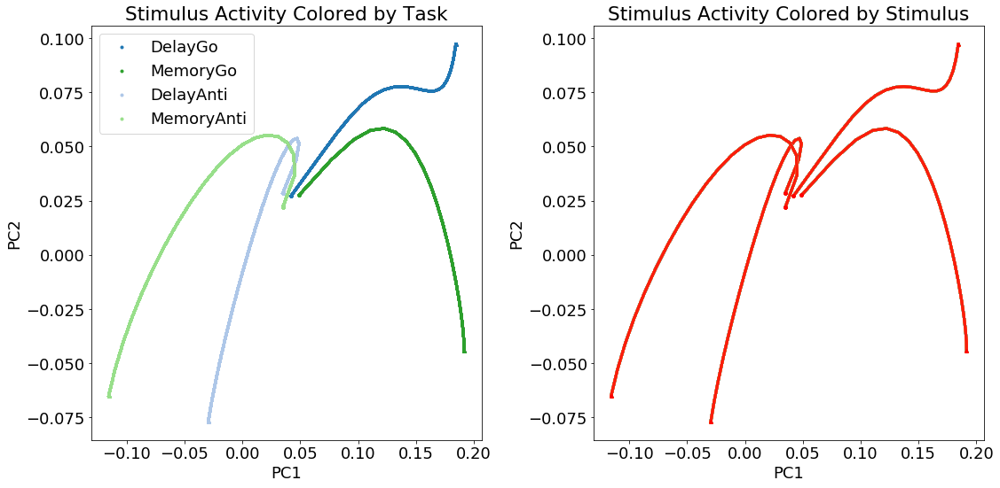

In [28]:
model = Model(model_dir_all)
with tf.Session() as sess:

    model.saver.restore(sess,ckpt_n_dir)
    # get all connection weights and biases as tensorflow variables
    var_list = model.var_list
    # evaluate the parameters after training
    params = [sess.run(var) for var in var_list]
    # get hparams
    hparams = model.hp
    trial_master = generate_trials(rule, hparams, mode = 'random', batch_size = 100, noise_on=False, delay_fac =1)   

# tasks = np.concatenate(([2,3,5],range(11,20))) # 
# # tasks = [0,2,3,5]
# count_back = 1
# count_forward = 3
# D_stim = make_h_combined_axes(model_dir_all,tasks,'stim1',count_back,count_forward,npc = 4,pc_inds = [1,3])
color_inds_anti = (tab20(0/20),tab20(2/20),tab20(4/20),tab20(1/20),tab20(3/20),tab20(5/20))

n_trials = np.shape(trial_master.x)[1]
tasks = [0,2,3,5]
trial_set = range(0,n_trials,int(n_trials/100))
h_epoch = 'fix1'
plt.rcParams.update({'font.size': 18})
fig = plt.figure(figsize=(16,8),tight_layout=True,facecolor='white')
plot_h_struct_multi_delay(model_dir_all,ckpt_n_dir,tasks,trial_set,trial_master,D_stim,h_epoch,
                            color_inds_anti,rot = 0,dot_alpha = 1,line_alpha = .2)
plt.savefig(fldr+'Delay_Dfix_4Tasks.pdf')
plt.savefig(fldr+'Delay_Dfix_4Tasks.png')
plt.legend()
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-406000
(400, 256)
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-406000


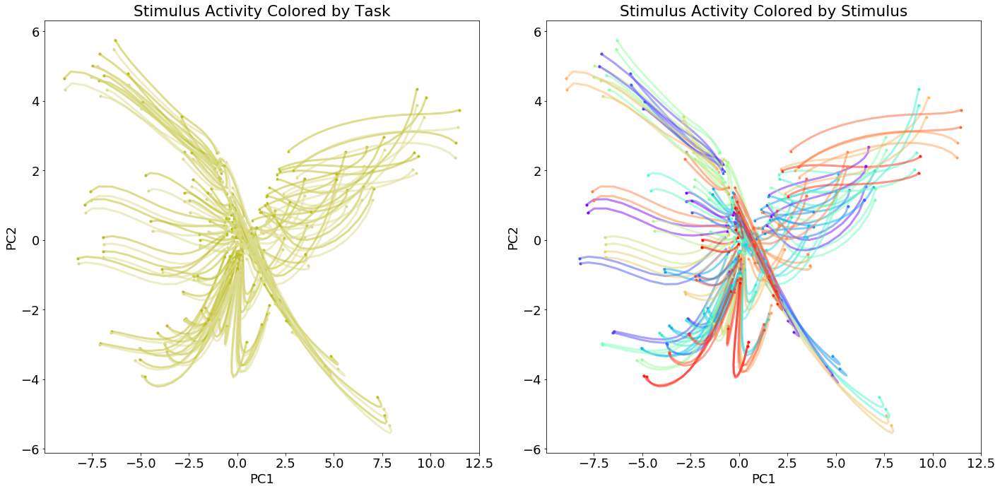

In [29]:
tasks = [18,19]# 
count_back = 1
count_forward = 1
D_stim = make_h_combined_axes(model_dir_all,tasks,'stim1',count_back,count_forward,npc = 4,pc_inds = [1,3])
color_inds_anti = (tab20(0/20),tab20(2/20),tab20(4/20),tab20(1/20),tab20(3/20),tab20(5/20))

n_trials = np.shape(trial_master.x)[1]
tasks = [18,19]# 
trial_set = range(0,n_trials,int(n_trials/100))
h_epoch = 'delay1'
fig = plt.figure(figsize=(20,10),tight_layout=True,facecolor='white')
plot_h_struct_multi_delay(model_dir_all,ckpt_n_dir,tasks,trial_set,trial_master,D_stim,h_epoch,
                            color_inds,rot = 0,dot_alpha = 1,line_alpha = .5)
plt.savefig(fldr+'Delay_Dfix_4Tasks.pdf')
plt.savefig(fldr+'Delay_Dfix_4Tasks.png')
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000


KeyError: 'qstar is not a file in the archive'

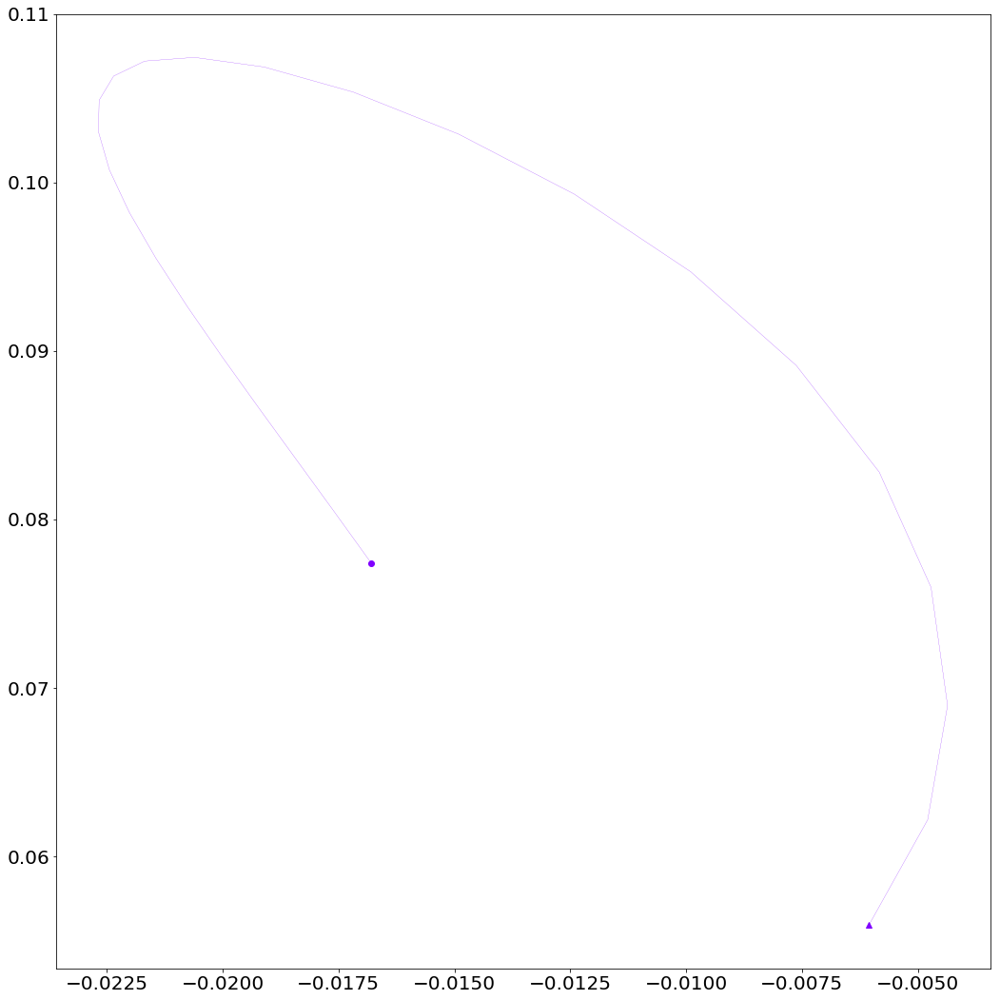

In [10]:
fp_epoch = 'stim1'
tol_ind = 0

tasks = [0,2,3,5]#range(6)#onp.concatenate(([0,2,3,5],range(11,20)))#range(6)#onp.concatenate((range(6),range(11,20)))

fig = plt.figure(figsize=(15,15),tight_layout=True,facecolor='white')
plt.rcParams.update({'font.size': 20})
cmap=plt.get_cmap('rainbow')
trial_master = generate_trials('delaygo', hparams, mode='test', batch_size = 400, noise_on=False, delay_fac =1)
    
## plot w test set of trials
model = Model(model_dir_all)
with tf.Session() as sess:
    model.saver.restore(sess,ckpt_n_dir)
    model._sigma=0
    hparams = model.hp
    
    e_num = 0
    for rule_ind in tasks:
        e_num +=1
        rule = rules_dict['all'][rule_ind]
        trial = same_stim_trial(trial_master, rule_ind)
        feed_dict = tools.gen_feed_dict(model, trial, hparams)
        h_tf, _ = sess.run([model.h, model.y_hat], feed_dict=feed_dict) #(n_time, n_condition, n_neuron)

        T_end = trial.epochs[fp_epoch][1], 
        if T_end[0] is None:
            T_end = np.shape(trial.x)

        T_start = trial.epochs[fp_epoch][0], 
        if T_start[0] is None:
            T_start = (0,)
    
        X = np.transpose(h_tf[range(T_start[0],T_end[0]),:,:],(1, 0, 2))
        
        fldr = os.path.join(model_dir_all,'fps',rule)
        
        num_trials = np.shape(h_tf)[1]
        for s in range(0,num_trials,2):
            filename = fldr +'/'+ fp_epoch + '_' +  str(-9) + '_' + str(s)+'.npz'
            c = cmap(s/num_trials)

            X_trial = np.dot(X[s,:,:],D)
            plt.plot(X_trial[0,0],X_trial[0,1],'^',c = c, linewidth = .3)
            plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = .2)
            if s==0:
                plt.plot(X_trial[-1,0],X_trial[-1,1],'o',c = c, linewidth = .3,label = rule)
            else:
                plt.plot(X_trial[-1,0],X_trial[-1,1],'o',c = c, linewidth = .3)

            if os.path.exists(filename):
                fp_struct = np.load(filename)
                fp_logic = fp_struct['qstar']<.001
                eig_decomps = comp_eig_decomp(fp_struct['J_xstar'][fp_logic,:,:])
                sorted_fps = fp_struct['xstar'][fp_logic,:]
                plot_FP_stars(sorted_fps, D.T, load_all_fps['losses'], eig_decomps, c)

plt.xlabel('Beta_' + fp_epoch + ' cos@')
plt.ylabel('Beta_' + fp_epoch + ' sin@') 
plt.title(fp_epoch+' Activity')
# plt.axis('equal')
plt.legend()        
plt.show()


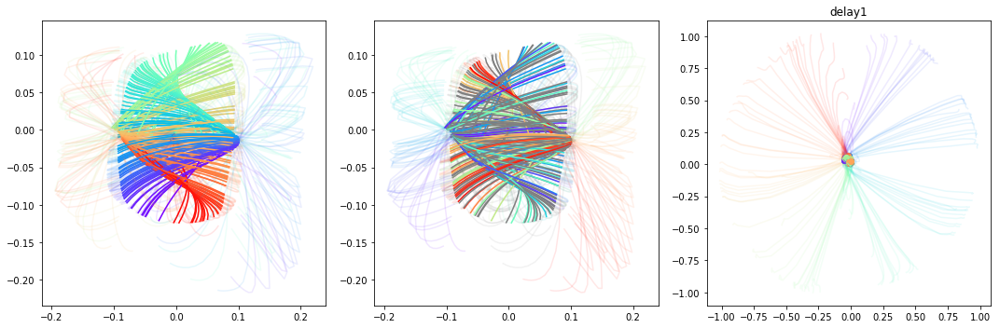

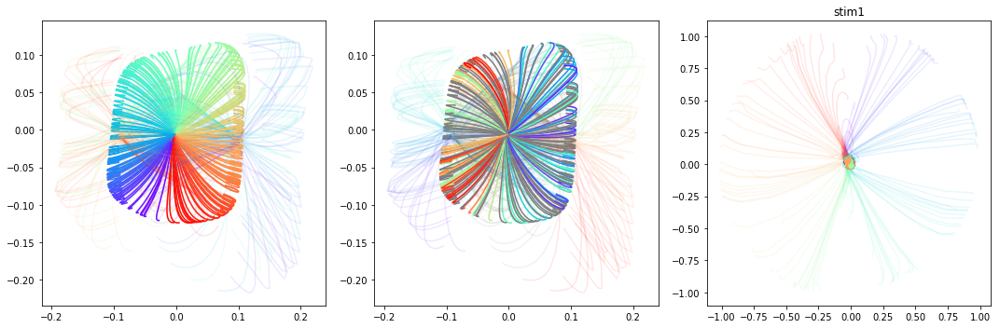

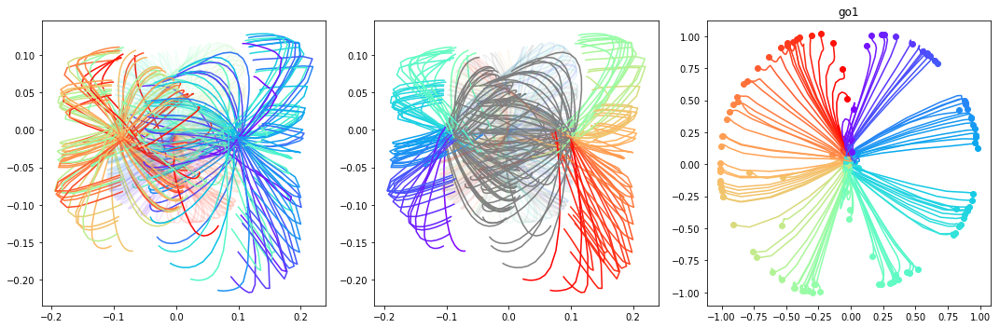

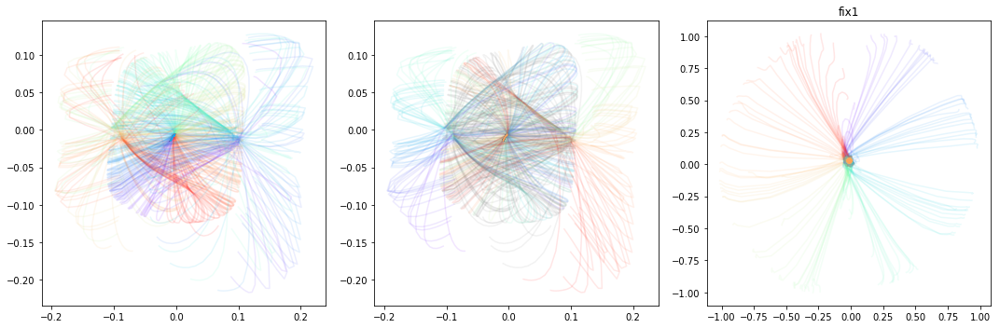

In [15]:
rule = 'dmcnogo'
model = Model(model_dir_all)
with tf.Session() as sess:
    model.restore()
    model._sigma=0
    # get all connection weights and biases as tensorflow variables
    var_list = model.var_list
    # evaluate the parameters after training
    params = [sess.run(var) for var in var_list]
    # get hparams
    hparams = model.hp
    # create a trial
    trial = generate_trials(rule, hparams, mode='random', noise_on=False, batch_size=500,delay_fac = 1)# get feed_dict
    feed_dict = tools.gen_feed_dict(model, trial, hparams)
    # run model
    h_tf, y_hat_tf = sess.run([model.h, model.y_hat], feed_dict=feed_dict) #(n_time, n_condition, n_neuron)  

D = make_axes(model_dir_all,ckpt_n_dir,'dmcgo','stim1')
N = np.shape(h_tf)[2]
X = np.reshape(h_tf,[-1,N])
pca = PCA(n_components = 2)
X_pca = pca.fit_transform(X)
X_pca = np.dot(X,D)
X_pca_shaped = np.reshape(X_pca,[np.shape(h_tf)[0],np.shape(h_tf)[1],2])

from tools_lnd import get_model_params
w_in, b_in, w_out, b_out = get_model_params(model_dir_all)
X_wout =np.dot(X,w_out[:,1:])
X_wout_shaped = np.reshape(X_wout,[np.shape(h_tf)[0],np.shape(h_tf)[1],2])

for e in trial.epochs:
    
    T_end = trial.epochs[e][1], 
    if T_end[0] is None:
        T_end = np.shape(trial.x)

    T_start = trial.epochs[e][0], 
    if T_start[0] is None:
        T_start = (1,)
            
    T = range(T_start[0]-1,T_end[0])
    
    fig = plt.figure(figsize=(15,5),tight_layout=True,facecolor='white')
    cmap=plt.get_cmap('rainbow')
    for t in range(np.min([np.shape(h_tf)[1],200])):
        plt.subplot(1,3,1)
        c = cmap(stim1_locs[t]/(np.pi*2))
        plt.plot(X_pca_shaped[:,t,0],X_pca_shaped[:,t,1],c = c,alpha = .1)
        plt.plot(X_pca_shaped[T,t,0],X_pca_shaped[T,t,1],c = c,alpha = 1)
        plt.subplot(1,3,2)
        
        if trial.y_loc[-1,t]/(np.pi*2)<0:
            c = [.5,.5,.5]
        else:
            c = cmap(trial.y_loc[-1,t]/(np.pi*2))
            
        plt.plot(X_pca_shaped[:,t,0],X_pca_shaped[:,t,1],c = c,alpha = .1)
        plt.plot(X_pca_shaped[T,t,0],X_pca_shaped[T,t,1],c = c,alpha = 1)
        plt.subplot(1,3,3)
        c = cmap(stim2_locs[t]/(np.pi*2))
        plt.plot(X_wout_shaped[:,t,0],X_wout_shaped[:,t,1],c = c,alpha = .1)
        plt.plot(X_wout_shaped[T,t,0],X_wout_shaped[T,t,1],c = c,alpha = 1)
        plt.plot(X_wout_shaped[T[-1],t,0],X_wout_shaped[T[-1],t,1],'o',c = c,alpha = 1)
    plt.title(e)
    plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/1/model.ckpt
Model restored from file: /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/1/model.ckpt
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/1/ckpts/model.ckpt-1052000
Variables being optimized:
<tf.Variable 'rnn/leaky_

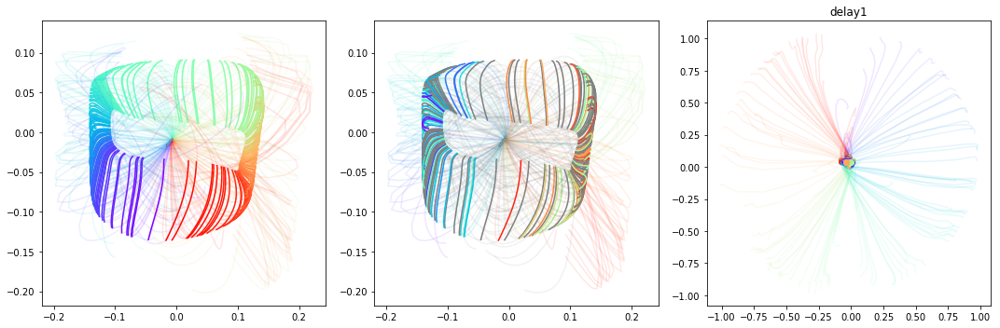

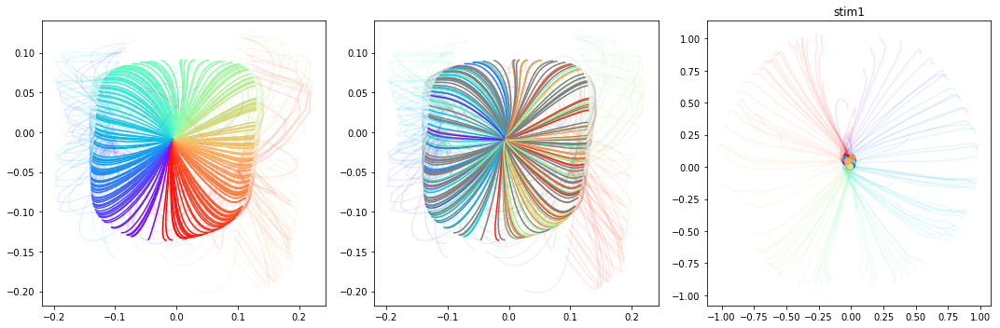

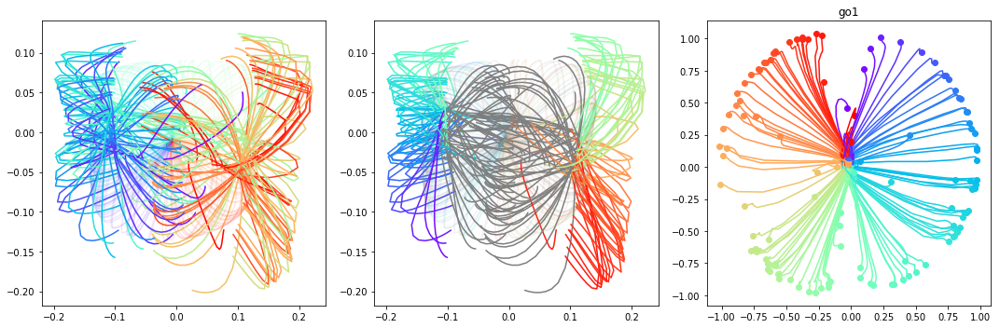

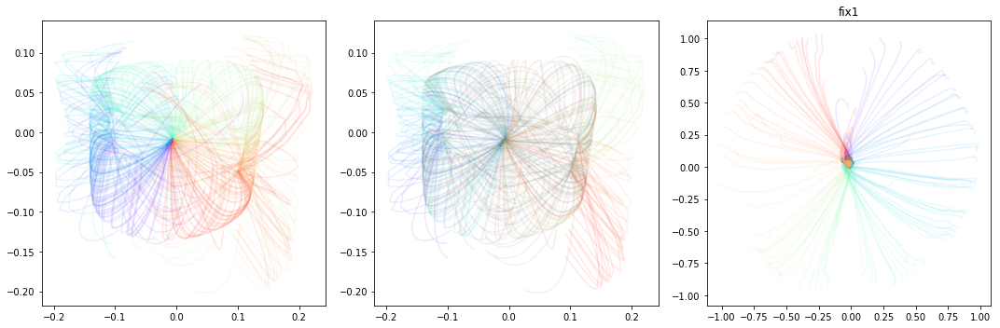

In [16]:
rule = 'dmcgo'
model = Model(model_dir_all)
with tf.Session() as sess:
    model.restore()
    model._sigma=0
    # get all connection weights and biases as tensorflow variables
    var_list = model.var_list
    # evaluate the parameters after training
    params = [sess.run(var) for var in var_list]
    # get hparams
    hparams = model.hp
    # create a trial
    trial = generate_trials(rule, hparams, mode='random', noise_on=False, batch_size=500,delay_fac = 1)# get feed_dict
    feed_dict = tools.gen_feed_dict(model, trial, hparams)
    # run model
    h_tf, y_hat_tf = sess.run([model.h, model.y_hat], feed_dict=feed_dict) #(n_time, n_condition, n_neuron)  
    
D = make_axes(model_dir_all,ckpt_n_dir,'dmcgo','stim1')
N = np.shape(h_tf)[2]
X = np.reshape(h_tf,[-1,N])
pca = PCA(n_components = 2)
X_pca = pca.fit_transform(X)
X_pca = np.dot(X,D)
X_pca_shaped = np.reshape(X_pca,[np.shape(h_tf)[0],np.shape(h_tf)[1],2])

from tools_lnd import get_model_params
w_in, b_in, w_out, b_out = get_model_params(model_dir_all)
X_wout =np.dot(X,w_out[:,1:])
X_wout_shaped = np.reshape(X_wout,[np.shape(h_tf)[0],np.shape(h_tf)[1],2])

for e in trial.epochs:
    
    T_end = trial.epochs[e][1], 
    if T_end[0] is None:
        T_end = np.shape(trial.x)

    T_start = trial.epochs[e][0], 
    if T_start[0] is None:
        T_start = (1,)
            
    T = range(T_start[0]-1,T_end[0])
    
    fig = plt.figure(figsize=(15,5),tight_layout=True,facecolor='white')
    cmap=plt.get_cmap('rainbow')
    for t in range(np.min([np.shape(h_tf)[1],200])):
        plt.subplot(1,3,1)
        c = cmap(stim1_locs[t]/(np.pi*2))
        plt.plot(X_pca_shaped[:,t,0],X_pca_shaped[:,t,1],c = c,alpha = .1)
        plt.plot(X_pca_shaped[T,t,0],X_pca_shaped[T,t,1],c = c,alpha = 1)
        plt.subplot(1,3,2)
        
        if trial.y_loc[-1,t]/(np.pi*2)<0:
            c = [.5,.5,.5]
        else:
            c = cmap(trial.y_loc[-1,t]/(np.pi*2))
            
        plt.plot(X_pca_shaped[:,t,0],X_pca_shaped[:,t,1],c = c,alpha = .1)
        plt.plot(X_pca_shaped[T,t,0],X_pca_shaped[T,t,1],c = c,alpha = 1)
        plt.subplot(1,3,3)
        c = cmap(stim2_locs[t]/(np.pi*2))
        plt.plot(X_wout_shaped[:,t,0],X_wout_shaped[:,t,1],c = c,alpha = .1)
        plt.plot(X_wout_shaped[T,t,0],X_wout_shaped[T,t,1],c = c,alpha = 1)
        plt.plot(X_wout_shaped[T[-1],t,0],X_wout_shaped[T[-1],t,1],'o',c = c,alpha = 1)
    plt.title(e)
    plt.show()

In [55]:
model = Model(model_dir_all)
with tf.Session() as sess:

    rule = 'fdanti'
    model.saver.restore(sess,ckpt_n_dir)
    # get all connection weights and biases as tensorflow variables
    var_list = model.var_list
    # evaluate the parameters after training
    params = [sess.run(var) for var in var_list]
    # get hparams
    hparams = model.hp
    trial = generate_trials(rule, hparams, mode = 'test', batch_size = 400, noise_on=True, delay_fac =1)
    feed_dict = tools.gen_feed_dict(model, trial, hparams)
    h_tf = sess.run(model.h, feed_dict=feed_dict) #(n_time, n_trials, n_neuron)
        
Beta_epoch = generate_Beta_epoch(h_tf,trial)
X_pca = Beta_epoch['stim1']

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /home/laura/data/rnn/multitask/crystals/softplus/l2w0001/0/ckpts/model.ckpt-422000


In [22]:
trial.epochs

{'delay1': (50, 110),
 'fix1': (None, 25),
 'go1': (110, None),
 'stim1': (25, 50)}

In [21]:
trial.epochs.values()[0][0]

50

In [8]:
np.shape(trial.x)

(135, 80, 25)

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/1/ckpts/model.ckpt-1052000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/1/ckpts/model.ckpt-1052000
/Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/1/golub_fixed_pts/d

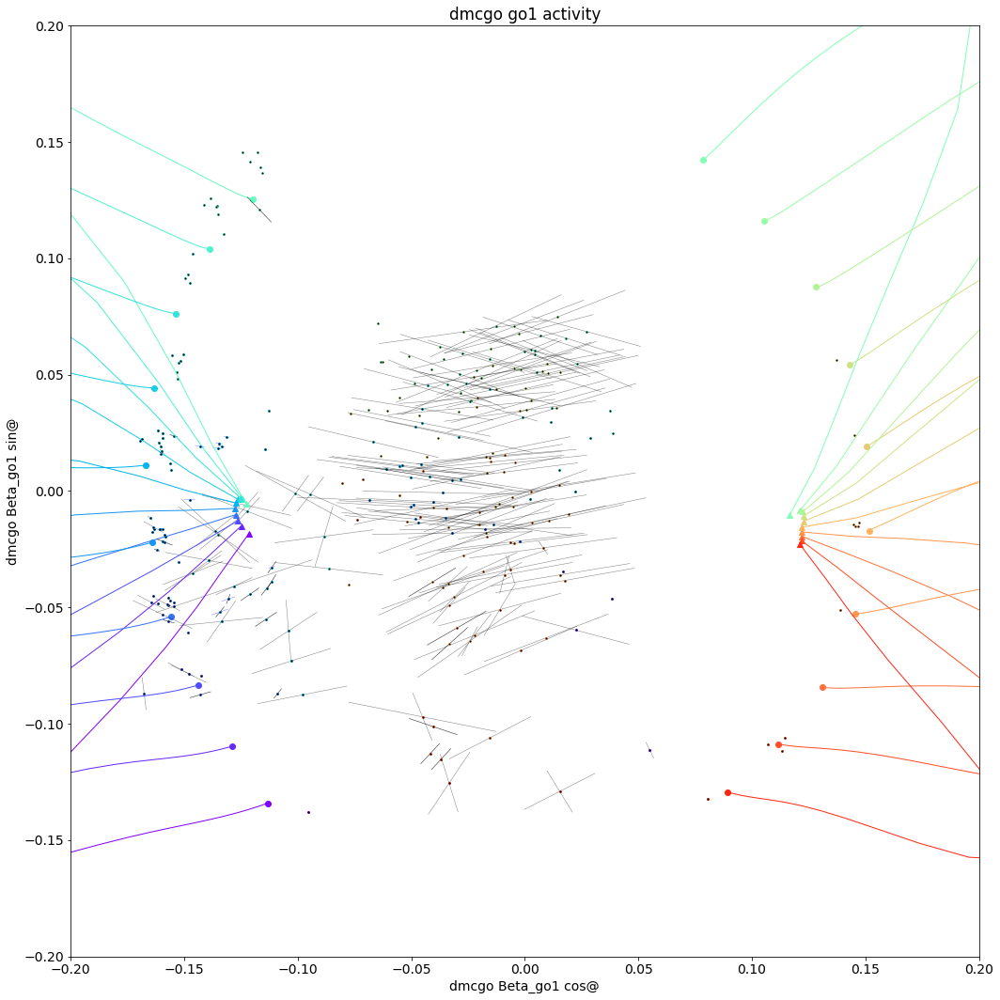

In [18]:
fp_epoch = 'go1'
axes_epoch = fp_epoch
tol_ind = 0
tasks = [18]#[0,2,3,5]#range(6)#onp.concatenate(([0,2,3,5],range(11,20)))#range(6)#onp.concatenate((range(6),range(11,20)))

plt.rcParams.update({'font.size': 14})
cmap=plt.get_cmap('rainbow')
rule_master = rules_dict['all'][18]

D = make_axes(model_dir_all,ckpt_n_dir,rule_master,axes_epoch)
        
## plot w test set of trials
model = Model(model_dir_all)
with tf.Session() as sess:
    model.saver.restore(sess,ckpt_n_dir)
    model._sigma=0
    hparams = model.hp
    
    for rule_ind in tasks:
        rule = rules_dict['all'][rule_ind]
        trial = generate_trials(rule, hparams, mode='test', noise_on=False, delay_fac =1)
        feed_dict = tools.gen_feed_dict(model, trial, hparams)
        h_tf, _ = sess.run([model.h, model.y_hat], feed_dict=feed_dict) #(n_time, n_condition, n_neuron)

        T_end = trial.epochs[fp_epoch][1], 
        if T_end[0] is None:
            T_end = np.shape(trial.x)

        T_start = trial.epochs[fp_epoch][0], 
        if T_start[0] is None:
            T_start = (0,)
    
        X = np.transpose(h_tf[range(T_start[0]-1,T_end[0]),:,:],(1, 0, 2))
        
        fldr = os.path.join(model_dir_all,'golub_fixed_pts',rule,fp_epoch+'*')
        f_list = [f for f in glob.glob(fldr)]
        
        num_trials = np.shape(h_tf)[1]
        fig = plt.figure(figsize=(15,15),tight_layout=True,facecolor='white')
        for s in range(len(f_list)):
#             fig = plt.figure(figsize=(8,8),tight_layout=True,facecolor='white')
            filename = f_list[s]

            if os.path.exists(filename):
                print(filename)
                fp_struct = np.load(filename)
                c = cmap(fp_struct['trial_num']/num_trials)
                if fp_struct['trial_num']%4==0:

                    X_trial = np.dot(h_tf[range(T_start[0]-1,T_end[0]),fp_struct['trial_num'],:],D)
                    plt.plot(X_trial[0,0],X_trial[0,1],'^',c = c, linewidth = 1)
                    plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 1)
                    if s==0:
                        plt.plot(X_trial[-1,0],X_trial[-1,1],'o',c = c, linewidth = .3,label = rule)
                    else:
                        plt.plot(X_trial[-1,0],X_trial[-1,1],'o',c = c, linewidth = .3)

                    fp_logic = fp_struct['qstar']<.0000001
                    eig_decomps = comp_eig_decomp(fp_struct['J_xstar'][fp_logic,:,:])
                    sorted_fps = fp_struct['xstar'][fp_logic,:]
                    plot_FP(sorted_fps, D.T, eig_decomps, c)

        plt.xlabel(rule_master + ' Beta_' + axes_epoch + ' cos@')
        plt.ylabel(rule_master + ' Beta_' + axes_epoch + ' sin@') 
        plt.title(rule + ' ' + fp_epoch+' activity')
        lims = [np.min(X_trial),-np.max(X_trial),-np.min(X_trial),np.max(X_trial)]
        sq_lim_set = [-.2,.2]#1.1*[np.min(lims),np.max(lims)]
        plt.ylim(sq_lim_set)
        plt.xlim(sq_lim_set)

        figpath = os.path.join(model_dir_all,'tf_fixed_pt_figs',rule_master+'_'+axes_epoch,fp_epoch)
        figname = rule+'_'+fp_epoch+'_all.pdf'#fp_epoch+'_'+str(fp_struct['trial_num'])+'.pdf'
        if not os.path.exists(figpath):
            os.makedirs(figpath)
        plt.savefig(os.path.join(figpath,figname))
        plt.show()


In [ ]:
rule = 'dmcgo'
model = Model(model_dir_all)
with tf.Session() as sess:
    model.restore()
    model._sigma=0
    # get all connection weights and biases as tensorflow variables
    var_list = model.var_list
    # evaluate the parameters after training
    params = [sess.run(var) for var in var_list]
    # get hparams
    hparams = model.hp
    # create a trial
    trial = generate_trials(rule, hparams, mode='test', noise_on=False, batch_size=1000,delay_fac = 1)# get feed_dict
    feed_dict = tools.gen_feed_dict(model, trial, hparams)
    # run model
    h_tf, y_hat_tf = sess.run([model.h, model.y_hat], feed_dict=feed_dict) #(n_time, n_condition, n_neuron)  

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1208000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1208000
/home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/golub_fixed_pts/dmcgo/stim1_78.npz


KeyboardInterrupt: 

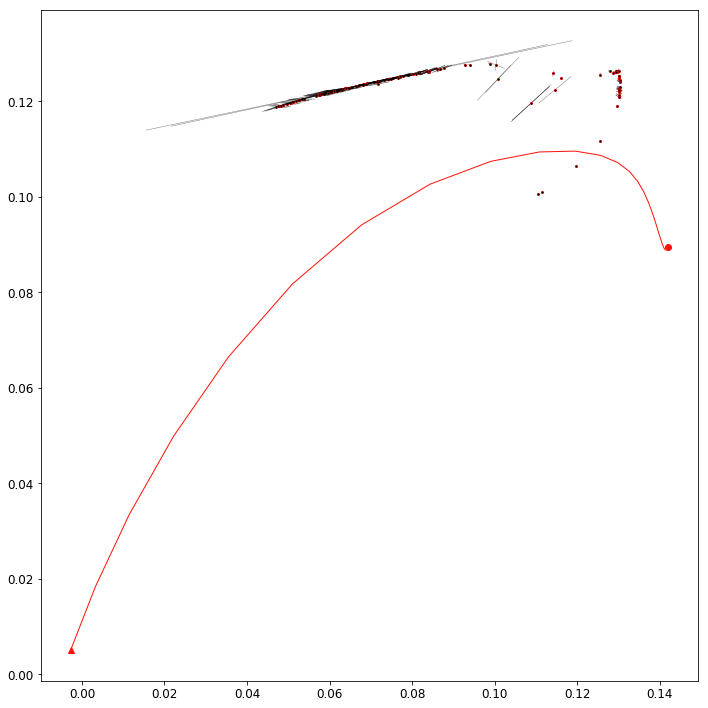

In [166]:
model_n = 0
dir_specific_all = 'crystals/softplus/l2h00001'#'crystals/softplus/l2h00001'#'stepnet/crystals/softplus/'#grad_norm_both/'#'lowD/combos'#'stepnet/lowD/tanh'#'lowD/grad_norm_l2001' #' #'lowD/armnet_noreg'#lowD/combos' ##grad_norm_l2h000001' /Documents/data/rnn/multitask/varGo/lowD/most/
model_dir_all = os.path.join(p,'data/rnn/multitask/',dir_specific_all,str(model_n))
ckpt_n = name_best_ckpt(model_dir_all,rule)
ckpt_n_dir = os.path.join(model_dir_all,'ckpts/model.ckpt-' + str(int(ckpt_n)))

tasks = [18]
plt.rcParams.update({'font.size': 12})

axes_epochs = ['fix1','stim1','delay1','go1']
fp_epoch = 'stim1'
rule_master = 'dmcgo'

fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')
axes_epoch = fp_epoch
fp_epoch = fp_epoch
D = make_axes(model_dir_all,ckpt_n_dir,rule_master,axes_epoch)
plot_fp_struct_multi(model_dir_all,ckpt_n_dir,tasks,range(1),rule_master,D,fp_epoch,axes_epoch)

In [20]:
def plot_htf(model_dir_all,ckpt_n_dir,tasks,rule_master,D,fp_epoch,axes_epoch):
    cmap=plt.get_cmap('rainbow')

    model = Model(model_dir_all)
    with tf.Session() as sess:
        model.saver.restore(sess,ckpt_n_dir)
        model._sigma=0
        hparams = model.hp

        ri = 0
        for rule_ind in tasks:
            ri+=1
#             plt.subplot(1,len(tasks),ri)
            rule = rules_dict['all'][rule_ind]
            trial = generate_trials(rule, hparams, mode='test', noise_on=False, delay_fac =1)
            feed_dict = tools.gen_feed_dict(model, trial, hparams)
            h_tf, _ = sess.run([model.h, model.y_hat], feed_dict=feed_dict) #(n_time, n_condition, n_neuron)

            T_end = trial.epochs[fp_epoch][1], 
            if T_end[0] is None:
                T_end = np.shape(trial.x)

            T_start = trial.epochs[fp_epoch][0], 
            if T_start[0] is None:
                T_start = (0,)

            X = np.transpose(h_tf[range(T_start[0]-1,T_end[0]),:,:],(1, 0, 2))

            num_trials = np.shape(h_tf)[1]

            for t_ind in range(0,num_trials,2):
                c = cmap(t_ind/num_trials)

                X_trial = np.dot(h_tf[range(T_start[0]-1,T_end[0]),t_ind,:],D)
                plt.plot(X_trial[0,0],X_trial[0,1],'^',c = c, linewidth = 1)
                plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 1)
                plt.plot(X_trial[-1,0],X_trial[-1,1],'o',c = c, linewidth = .3,label = rule)


            plt.xlabel(rule_master + ' Beta_' + axes_epoch + ' cos@')
            plt.ylabel(rule_master + ' Beta_' + axes_epoch + ' sin@') 
            plt.title(rule + ' ' + fp_epoch+' activity')
            lims = [np.min(X_trial),-np.max(X_trial),-np.min(X_trial),np.max(X_trial)]
            sq_lim_set = [np.min(lims)*1.1,np.max(lims)*1.1]
            plt.ylim(sq_lim_set)
            plt.xlim(sq_lim_set)


Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1208000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1208000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=flo

INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1208000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1208000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crys

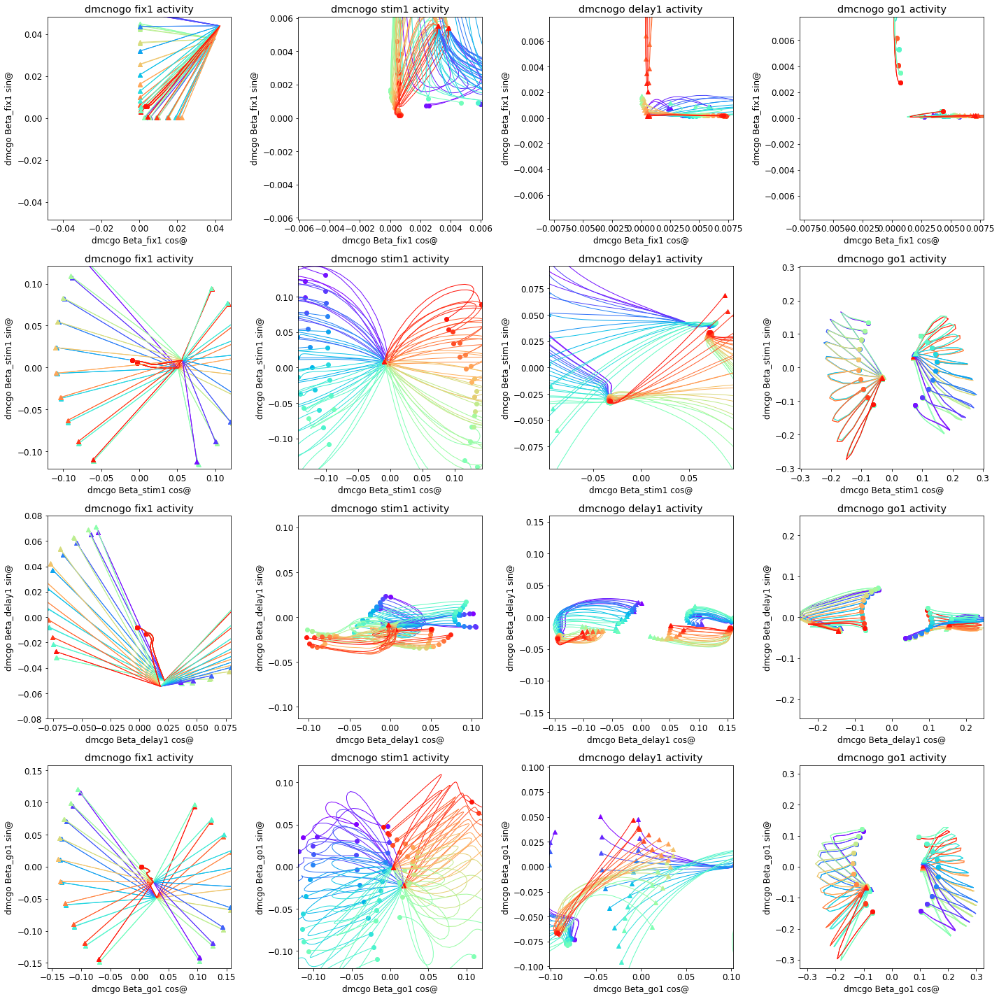

In [52]:
model_n = 0
dir_specific_all = 'crystals/softplus/l2h00001'#'crystals/softplus/l2h00001'#'stepnet/crystals/softplus/'#grad_norm_both/'#'lowD/combos'#'stepnet/lowD/tanh'#'lowD/grad_norm_l2001' #' #'lowD/armnet_noreg'#lowD/combos' ##grad_norm_l2h000001' /Documents/data/rnn/multitask/varGo/lowD/most/
model_dir_all = os.path.join(p,'data/rnn/multitask/',dir_specific_all,str(model_n))
ckpt_n = name_best_ckpt(model_dir_all,rule)
ckpt_n_dir = os.path.join(model_dir_all,'ckpts/model.ckpt-' + str(int(ckpt_n)))

tasks = [18]
plt.rcParams.update({'font.size': 12})

axes_epochs = ['fix1','stim1','delay1','go1']
fp_epoch = 'go1'
rule_master = 'dmcgo'

fig = plt.figure(figsize=(20,20),tight_layout=True,facecolor='white')
for a_ind in range(len(axes_epochs)):
    for fp_ind in range(len(axes_epochs)):
        axes_epoch = axes_epochs[a_ind]
        fp_epoch = axes_epochs[fp_ind]
        D = make_axes(model_dir_all,ckpt_n_dir,rule_master,axes_epoch)
        plt.subplot(len(axes_epochs),len(axes_epochs),a_ind*len(axes_epochs)+fp_ind+1)
        plot_htf(model_dir_all,ckpt_n_dir,tasks,rule_master,D,fp_epoch,axes_epoch)

In [17]:
from tools_lnd import get_model_params
w_in, b_in, w_out, b_out = get_model_params(model_dir_all)
np.shape(w_out)

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/1/model.ckpt
Model restored from file: /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/1/model.ckpt


(256, 3)

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1208000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1208000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=flo

INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1208000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1208000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crys

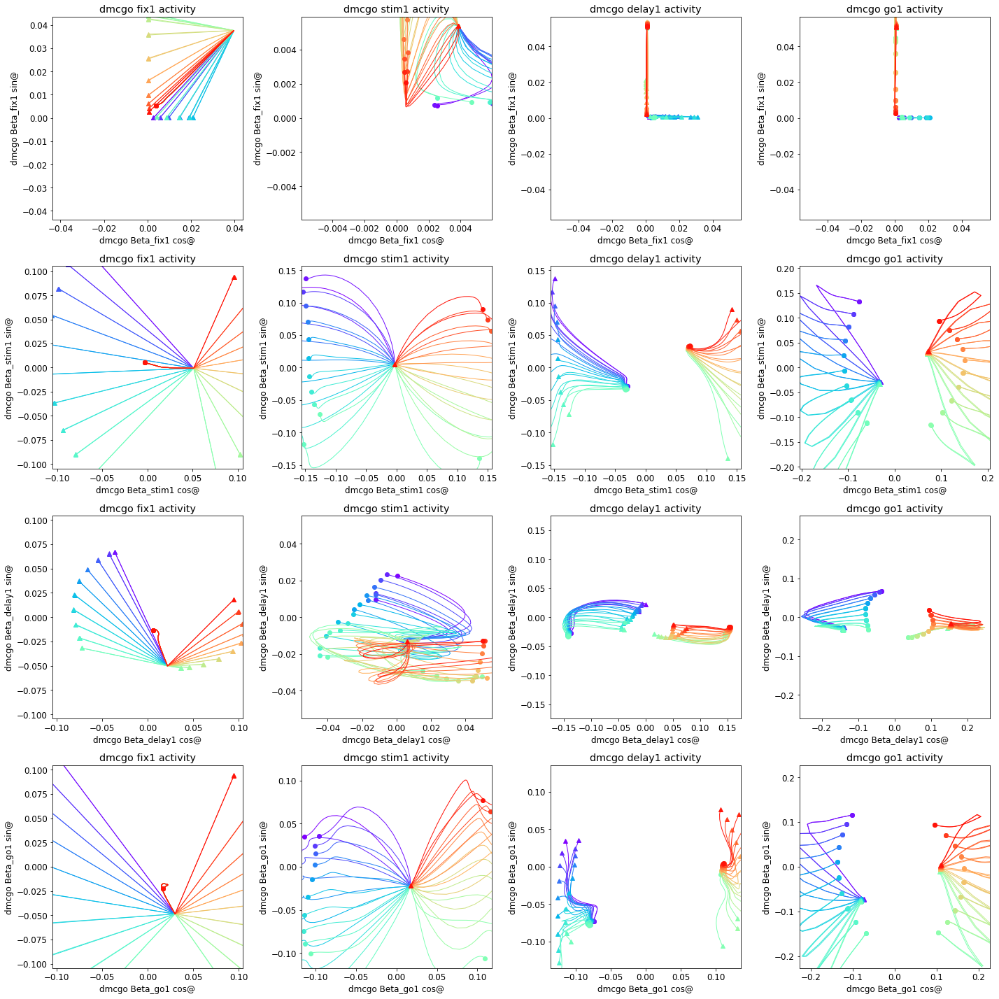

In [53]:
model_n = 0
dir_specific_all = 'crystals/softplus/l2h00001'#'crystals/softplus/l2h00001'#'stepnet/crystals/softplus/'#grad_norm_both/'#'lowD/combos'#'stepnet/lowD/tanh'#'lowD/grad_norm_l2001' #' #'lowD/armnet_noreg'#lowD/combos' ##grad_norm_l2h000001' /Documents/data/rnn/multitask/varGo/lowD/most/
model_dir_all = os.path.join(p,'data/rnn/multitask/',dir_specific_all,str(model_n))
ckpt_n = name_best_ckpt(model_dir_all,rule)
ckpt_n_dir = os.path.join(model_dir_all,'ckpts/model.ckpt-' + str(int(ckpt_n)))

tasks = [18]
plt.rcParams.update({'font.size': 12})

axes_epochs = ['fix1','stim1','delay1','go1']
fp_epoch = 'go1'
rule_master = 'dmcgo'

fig = plt.figure(figsize=(20,20),tight_layout=True,facecolor='white')
for a_ind in range(len(axes_epochs)):
    for fp_ind in range(len(axes_epochs)):
        axes_epoch = axes_epochs[a_ind]
        fp_epoch = axes_epochs[fp_ind]
        D = make_axes(model_dir_all,ckpt_n_dir,rule_master,axes_epoch)
        plt.subplot(len(axes_epochs),len(axes_epochs),a_ind*len(axes_epochs)+fp_ind+1)
        plot_htf(model_dir_all,ckpt_n_dir,tasks,rule_master,D,fp_epoch,axes_epoch)

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1208000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1208000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_

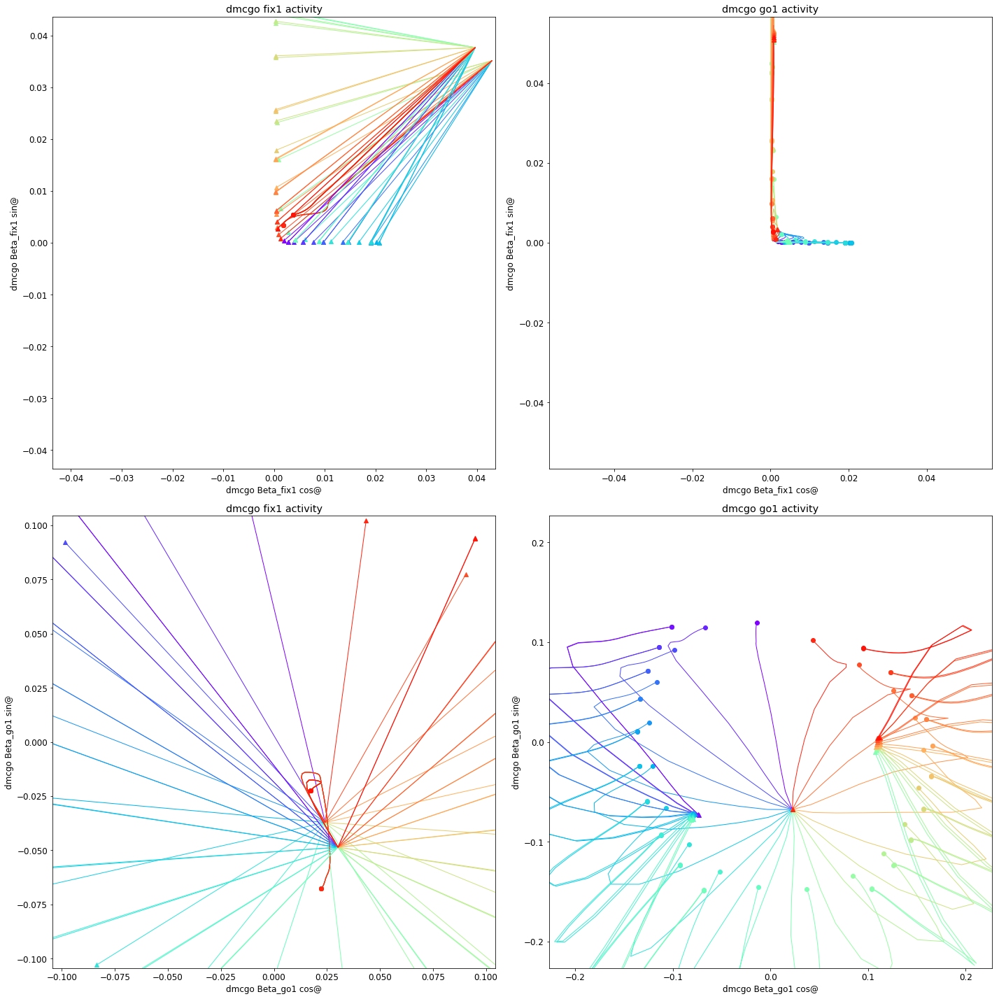

In [22]:
model_n = 0
dir_specific_all = 'crystals/softplus/l2h00001'#'crystals/softplus/l2h00001'#'stepnet/crystals/softplus/'#grad_norm_both/'#'lowD/combos'#'stepnet/lowD/tanh'#'lowD/grad_norm_l2001' #' #'lowD/armnet_noreg'#lowD/combos' ##grad_norm_l2h000001' /Documents/data/rnn/multitask/varGo/lowD/most/
model_dir_all = os.path.join(p,'data/rnn/multitask/',dir_specific_all,str(model_n))
ckpt_n = name_best_ckpt(model_dir_all,rule)
ckpt_n_dir = os.path.join(model_dir_all,'ckpts/model.ckpt-' + str(int(ckpt_n)))

tasks = [1,18]
plt.rcParams.update({'font.size': 12})

axes_epochs = ['fix1','go1']#['fix1','stim1','delay1','go1']
fp_epoch = 'go1'
rule_master = 'dmcgo'

fig = plt.figure(figsize=(20,20),tight_layout=True,facecolor='white')
for a_ind in range(len(axes_epochs)):
    for fp_ind in range(len(axes_epochs)):
        axes_epoch = axes_epochs[a_ind]
        fp_epoch = axes_epochs[fp_ind]
        D = make_axes(model_dir_all,ckpt_n_dir,rule_master,axes_epoch)
        plt.subplot(len(axes_epochs),len(axes_epochs),a_ind*len(axes_epochs)+fp_ind+1)
        plot_htf(model_dir_all,ckpt_n_dir,tasks,rule_master,D,fp_epoch,axes_epoch)

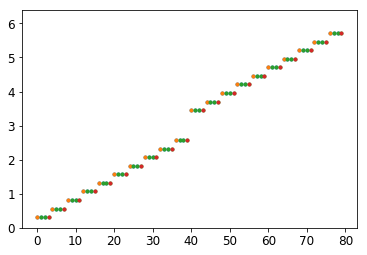

In [26]:
plt.plot(trial.stim_locs,'.')
plt.ylim(0,2*np.pi+.1)
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
/home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/golub_fixed_pts/dmcgo/stim1_78.npz
/home/laura/data/rnn/multitask/crystals

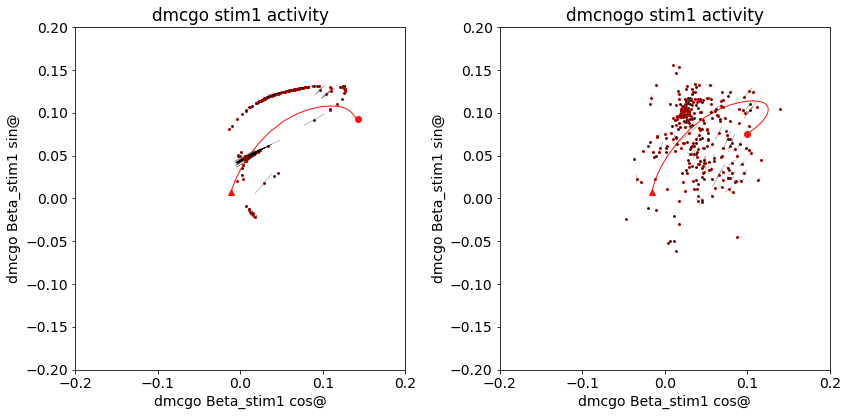

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
/home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/golub_fixed_pts/dmcgo/stim1_10.npz
/home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/golub_fixed_pts/dmcnogo/stim1_10.npz


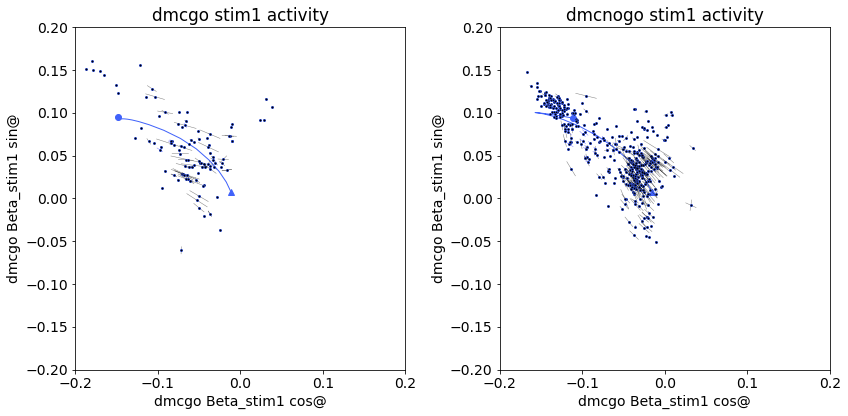

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
/home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/golub_fixed_pts/dmcgo/stim1_18.npz
/home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/golub_fixed_pts/dmcnogo/stim1_18.npz


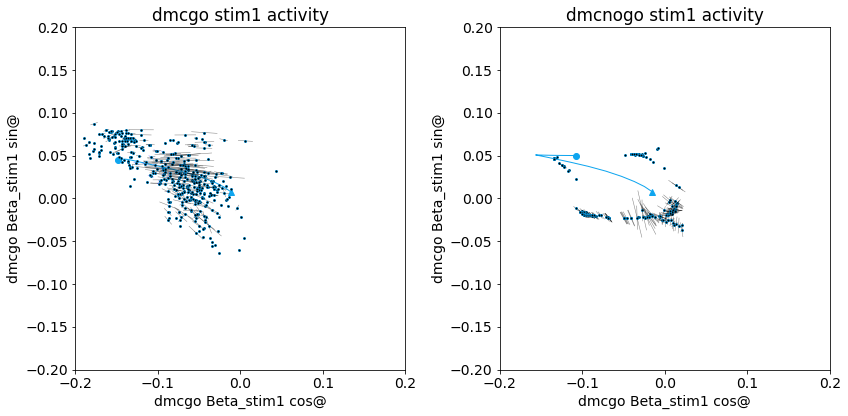

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
/home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/golub_fixed_pts/dmcgo/stim1_54.npz
/home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/golub_fixed_pts/dmcnogo/stim1_54.npz


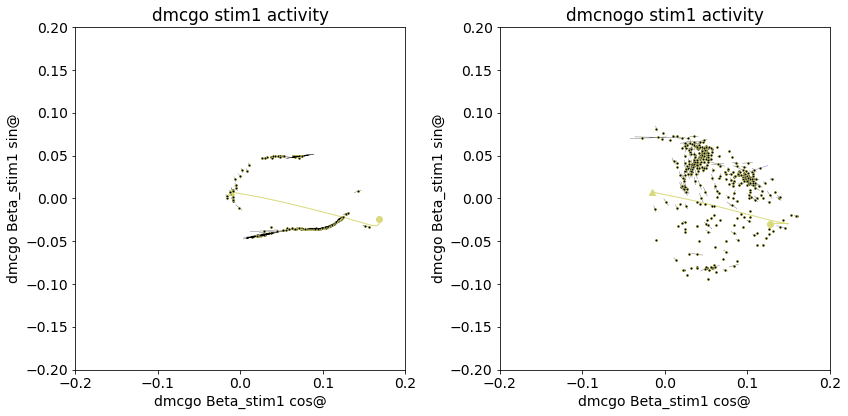

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
/home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/golub_fixed_pts/dmcgo/stim1_46.npz
/home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/golub_fixed_pts/dmcnogo/stim1_46.npz


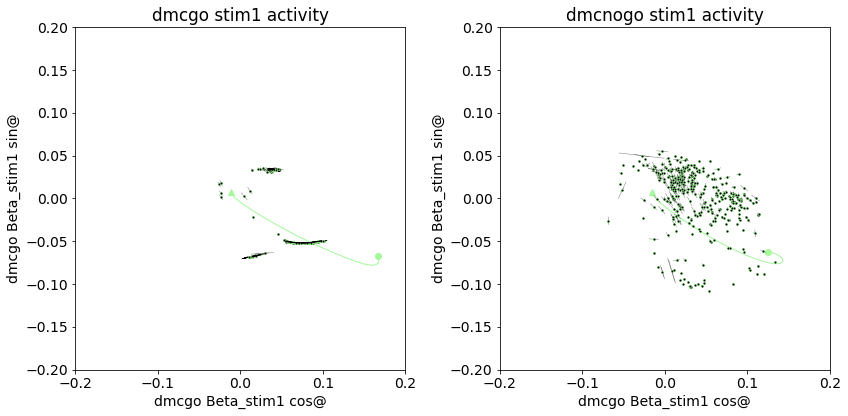

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1235000
/home/laura/data/rnn/multitask/crystals/softplus/l2h00001/0/golub_fixed_pts/dmcgo/stim1_8.npz


In [ ]:
model_n = 0
dir_specific_all = 'crystals/softplus/l2h00001'#'crystals/softplus/l2h00001'#'stepnet/crystals/softplus/'#grad_norm_both/'#'lowD/combos'#'stepnet/lowD/tanh'#'lowD/grad_norm_l2001' #' #'lowD/armnet_noreg'#lowD/combos' ##grad_norm_l2h000001' /Documents/data/rnn/multitask/varGo/lowD/most/
model_dir_all = os.path.join(p,'data/rnn/multitask/',dir_specific_all,str(model_n))
ckpt_n = name_best_ckpt(model_dir_all,rule)
ckpt_n_dir = os.path.join(model_dir_all,'ckpts/model.ckpt-' + str(int(ckpt_n)))

axes_epoch = 'stim1'
fp_epoch = 'stim1'
rule_master = 'dmcgo'
D = make_axes(model_dir_all,ckpt_n_dir,rule_master,axes_epoch)
tasks = [18,19]
plt.rcParams.update({'font.size': 14})
# fig = plt.figure(figsize=(10,4),tight_layout=True,facecolor='white')

for stim_cond in range(0,40,2):
    fig = plt.figure(figsize=(12,6),tight_layout=True,facecolor='white')
    plot_fp_struct_multi(model_dir_all,ckpt_n_dir,tasks,range(stim_cond,stim_cond+1),rule_master,D,fp_epoch,axes_epoch)
    figpath = os.path.join(model_dir_all,'tf_fixed_pt_figs',rule_master+'_'+axes_epoch,fp_epoch)
    figname = rules_dict['all'][tasks[0]]+'_'+rules_dict['all'][tasks[1]]+'_'+str(stim_cond)+'.pdf'
    if not os.path.exists(figpath):
        os.makedirs(figpath)
    plt.savefig(os.path.join(figpath,figname))
    plt.show()

In [179]:
def plot_fp_jitter(model_dir_all,rule,s,ut,D,vanilla_run_at_fp,n_steps = 100,rand_step_coef=.005,n_bumps = 10,h_tf = [],trial = [],c = []):

    if np.shape(h_tf)[0]==0:
        model = Model(model_dir_all)
        with tf.Session() as sess:
            model.saver.restore(sess,ckpt_n_dir)
            model._sigma=0
            hparams = model.hp
            trial = generate_trials(rule, hparams, mode='test', noise_on=False, delay_fac =1)
            feed_dict = tools.gen_feed_dict(model, trial, hparams)
            h_tf = sess.run(model.h, feed_dict=feed_dict) #(n_time, n_condition, n_neuron)
    
    if np.shape(c)[0]==0:
        c = cmap(s/np.shape(h_tf)[1])
        
    fldr = os.path.join(model_dir_all,'fps',rule)
    filename = fldr +'/'+ fp_epoch + '_' +  str(ut) + '_' + str(s)+'.npz'

    if os.path.exists(filename):
        load_all_fps = np.load(filename)

        x_star = load_all_fps['input']
        x_long = onp.matlib.repmat(x_star,n_steps,1)

        for nfp in range(np.shape(load_all_fps['fps'])[0]):
            h0 = np.squeeze(load_all_fps['fps'][nfp,:])

            for bump_num in range(n_bumps):
                h = h0 + rand_step_coef*npr.randn(N)
                h_t = vanilla_run_at_fp(params, x_long, h, alpha)

                X_trial = onp.dot(h_t,D)
                plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 1,alpha = .2)
                plt.plot(X_trial[-1,0],X_trial[-1,1],'^',c = c, linewidth = 1,alpha = .2)

            X_trial = onp.dot(h0.T,D)
            plt.plot(X_trial[0],X_trial[1],'o',c = c, linewidth = 2)
            plt.plot(X_trial[0],X_trial[1],'.k', linewidth = 2)

        h_tf_trial = onp.dot(h_tf[trial.epochs[fp_epoch][0]:trial.epochs[fp_epoch][1],s,:],D)
        plt.plot(h_tf_trial[:,0],h_tf_trial[:,1],'-',c = c, linewidth = 4)
        plt.plot(h_tf_trial[:,0],h_tf_trial[:,1],'-k', linewidth = 1)
        plt.plot(h_tf_trial[-1,0],h_tf_trial[-1,1],'^',c = c, markersize = 10)
        plt.ylim(-.25,.25)
        plt.xlim(-.25,.25)
    
def plot_1fp_jitter(model_dir_all,rule,s,ut,D,vanilla_run_at_fp,n_steps = 100,rand_step_coef=.001,n_bumps = 10):

    c = cmap(s/40)
    fldr = os.path.join(model_dir_all,'fps',rule)
    filename = fldr +'/'+ fp_epoch + '_' +  str(ut) + '_' + str(s)+'.npz'

    if os.path.exists(filename):
        load_all_fps = np.load(filename)
        
        sorted_fps, eig_decomps = eig_decomp(load_all_fps['fps'])

        x_star = load_all_fps['input']
        rnn_fun = lambda h : rnn_vanilla(params, h, x_star, alpha)
        loss_fun = lambda h : np.mean((h - rnn_fun(h))**2)

        x_long = onp.matlib.repmat(x_star,n_steps,1)

        
        for nfp in range(np.shape(load_all_fps['fps'])[0]):
            h0 = np.squeeze(load_all_fps['fps'][nfp,:])

            fig = plt.figure(figsize=(10,5),tight_layout=True,facecolor='white')
            plt.subplot(1,2,1)
            for bump_num in range(n_bumps):
                h = h0 + rand_step_coef*npr.randn(N)
                h_t = vanilla_run_at_fp(params, x_long, h, alpha)

                X_trial = onp.dot(h_t,D)
                plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 1,alpha = .2)
                plt.plot(X_trial[0,0],X_trial[0,1],'^',c = c, linewidth = 1,alpha = .2)
                plt.plot(X_trial[-1,0],X_trial[-1,1],'o',c = c, linewidth = 1,alpha = .2)

            X_trial = onp.dot(h0.T,D)
            plt.plot(X_trial[0],X_trial[1],'o',c = c, linewidth = 2)
            plt.plot(X_trial[0],X_trial[1],'.k', linewidth = 2)
            plt.title('loss : ' +str(load_all_fps['losses'][nfp]))
            
            plt.subplot(1,2,2)
            plt.plot(eig_decomps[nfp]['evals'].real,eig_decomps[nfp]['evals'].imag,'.k')
            plt.title('max eigenval : ' +str(np.max(eig_decomps[nfp]['evals'].real)))
            
            print(loss_fun(h0))
            
            plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=flo

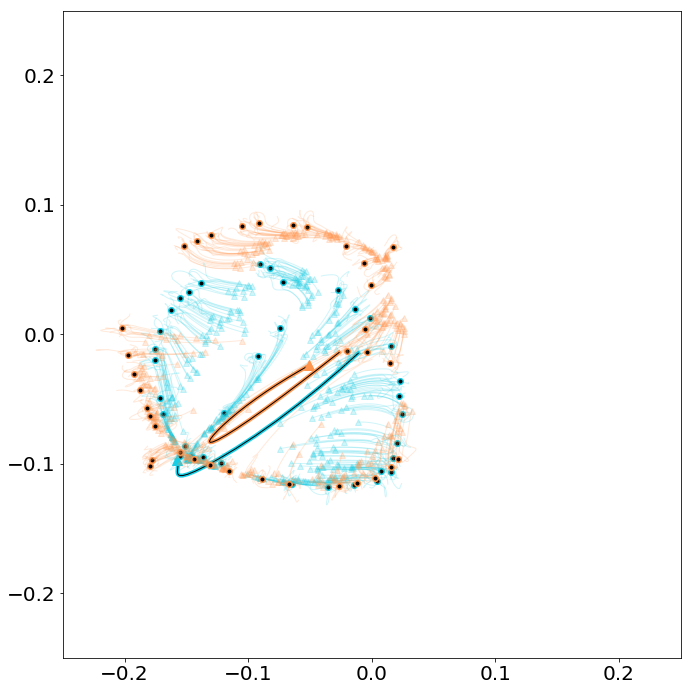

In [147]:
s = 12
ut = -9
cmap=plt.get_cmap('rainbow')

D_go = make_axes(model_dir_all,ckpt_n_dir,'delaygo')
fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')
plot_fp_jitter(model_dir_all,'delaygo',s,ut,D_go,vanilla_run_at_fp,c = cmap(s/40))
plot_fp_jitter(model_dir_all,'delayanti',s,ut,D_go,vanilla_run_at_fp,c = cmap((20+s)/40))

s = 16
plot_fp_jitter(model_dir_all,'delaygo',s,ut,D_go,vanilla_run_at_fp,c = cmap(s/40))
plot_fp_jitter(model_dir_all,'delayanti',s,ut,D_go,vanilla_run_at_fp,c = cmap((20+s)/40))

plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=flo

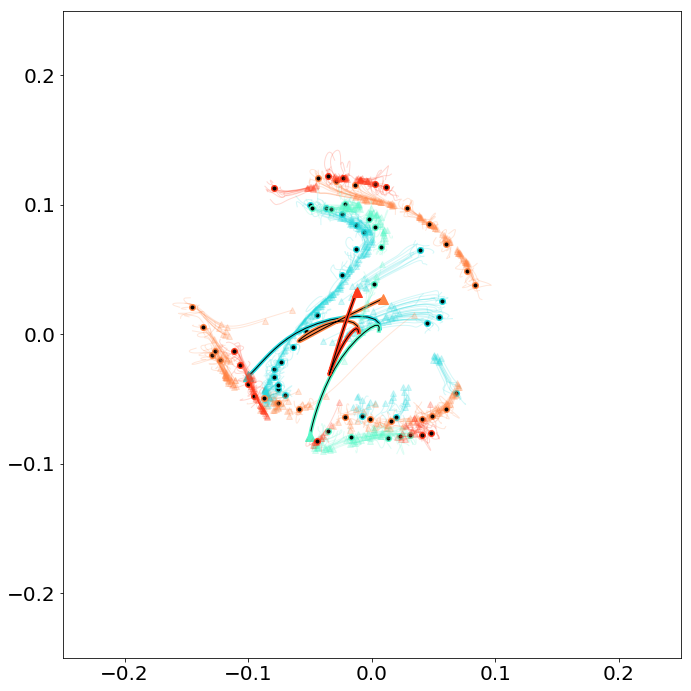

In [151]:
cmap=plt.get_cmap('rainbow')
ut = -9

D_go = make_axes(model_dir_all,ckpt_n_dir,'delaygo')
fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')

for s in [13, 17]:
    plot_fp_jitter(model_dir_all,'delaygo',s,ut,D_go,vanilla_run_at_fp,c = cmap(s/40))
    plot_fp_jitter(model_dir_all,'delayanti',s,ut,D_go,vanilla_run_at_fp,c = cmap((20+s)/40))

plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=flo

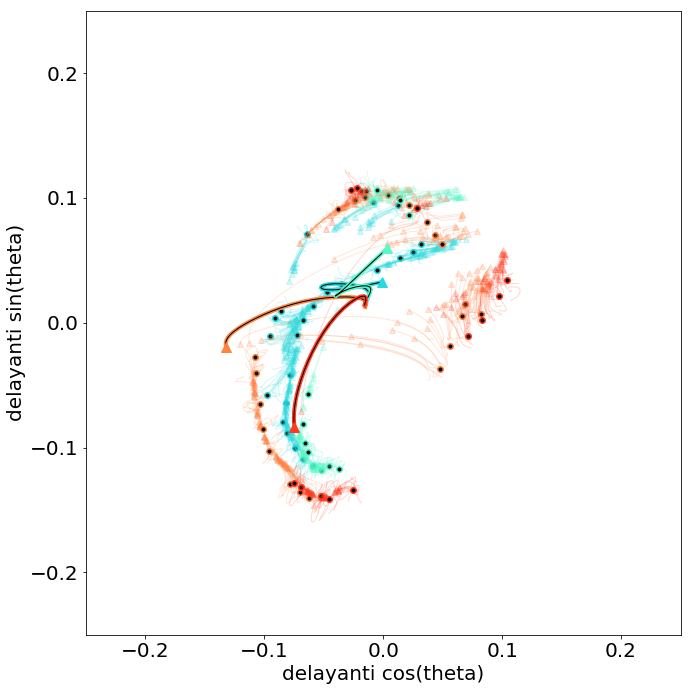

In [162]:
cmap=plt.get_cmap('rainbow')
ut = -9
axis_rule = 'delayanti'

D = make_axes(model_dir_all,ckpt_n_dir,axis_rule)
fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')

for s in [13, 17]:
    plot_fp_jitter(model_dir_all,'delaygo',s,ut,D,vanilla_run_at_fp,c = cmap(s/40))
    plot_fp_jitter(model_dir_all,'delayanti',s,ut,D,vanilla_run_at_fp,c = cmap((20+s)/40))
    
plt.ylabel(axis_rule + ' sin(theta)')
plt.xlabel(axis_rule + ' cos(theta)')
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=flo

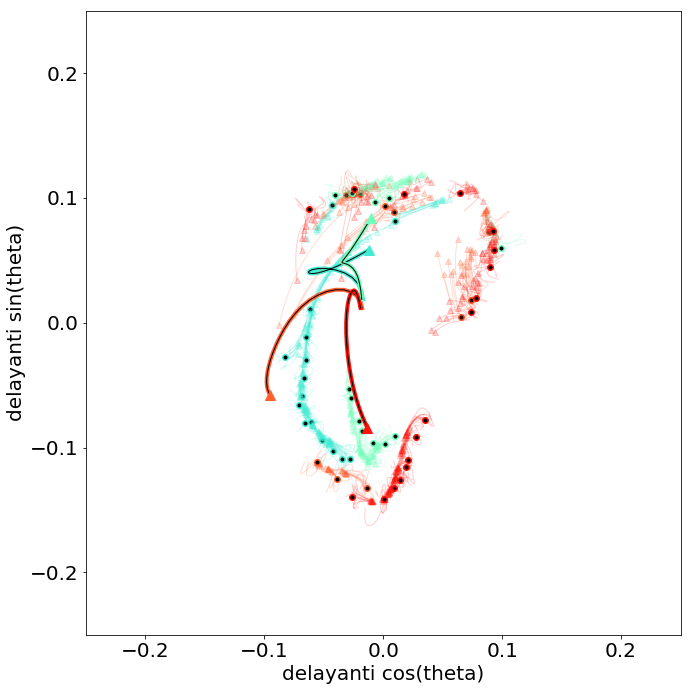

In [163]:
cmap=plt.get_cmap('rainbow')
ut = -9
axis_rule = 'delayanti'

D = make_axes(model_dir_all,ckpt_n_dir,axis_rule)
fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')

for s in [15, 19]:
    plot_fp_jitter(model_dir_all,'delaygo',s,ut,D,vanilla_run_at_fp,c = cmap(s/40))
    plot_fp_jitter(model_dir_all,'delayanti',s,ut,D,vanilla_run_at_fp,c = cmap((20+s)/40))
    
plt.ylabel(axis_rule + ' sin(theta)')
plt.xlabel(axis_rule + ' cos(theta)')
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=flo

KeyError: 'input is not a file in the archive'

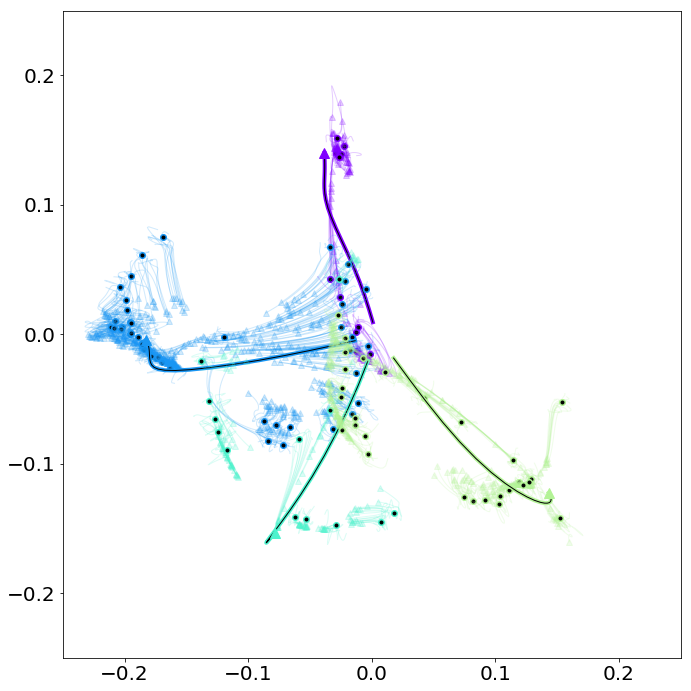

In [169]:
cmap=plt.get_cmap('rainbow')
ut = -9
axis_rule = 'delaygo'

D = make_axes(model_dir_all,ckpt_n_dir,axis_rule)
fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')

for s in range(0,40,8):
    plot_fp_jitter(model_dir_all,axis_rule,s,ut,D,vanilla_run_at_fp,c = cmap(s/40))
    
plt.ylabel(axis_rule + ' sin(theta)')
plt.xlabel(axis_rule + ' cos(theta)')
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=flo

KeyError: 'input is not a file in the archive'

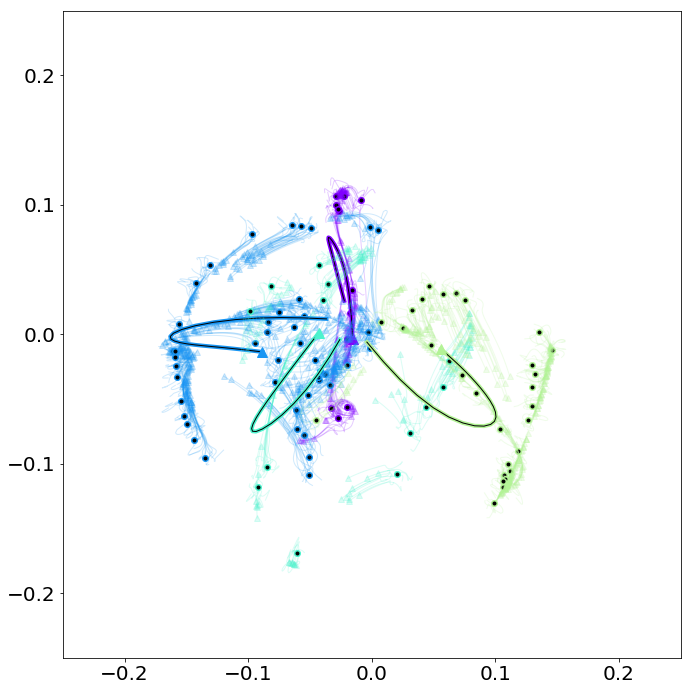

In [171]:
cmap=plt.get_cmap('rainbow')
ut = -9
axis_rule = 'delayanti'

D = make_axes(model_dir_all,ckpt_n_dir,axis_rule)
fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')

for s in range(0,40,8):
    plot_fp_jitter(model_dir_all,'delaygo',s,ut,D,vanilla_run_at_fp,c = cmap(s/40))
    
plt.ylabel(axis_rule + ' sin(theta)')
plt.xlabel(axis_rule + ' cos(theta)')
plt.show()

In [173]:
np.shape(D)

(256, 2)

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=flo

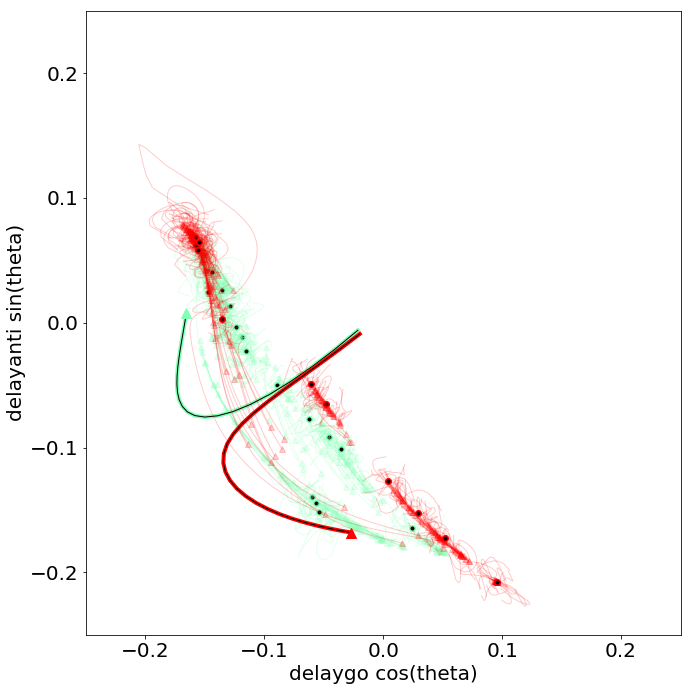

In [180]:
cmap=plt.get_cmap('rainbow')
ut = -9
axis_rule = 'delaygo'

D_go = make_axes(model_dir_all,ckpt_n_dir,'delaygo')
D_anti = make_axes(model_dir_all,ckpt_n_dir,'delayanti')
D = np.concatenate((D_go[:,1:],D_anti[:,1:]),axis=1)
D, _ = LA.qr(D)
fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')

for s in range(20,21):
    plot_fp_jitter(model_dir_all,'delaygo',s,ut,D,vanilla_run_at_fp,rand_step_coef=.01,n_bumps = 20,c = cmap(s/40))
    plot_fp_jitter(model_dir_all,'delayanti',s,ut,D,vanilla_run_at_fp,rand_step_coef=.01,n_bumps = 20,c = cmap((s+20)/40))
    
plt.ylabel('delayanti' + ' sin(theta)')
plt.xlabel('delaygo' + ' cos(theta)')
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=flo

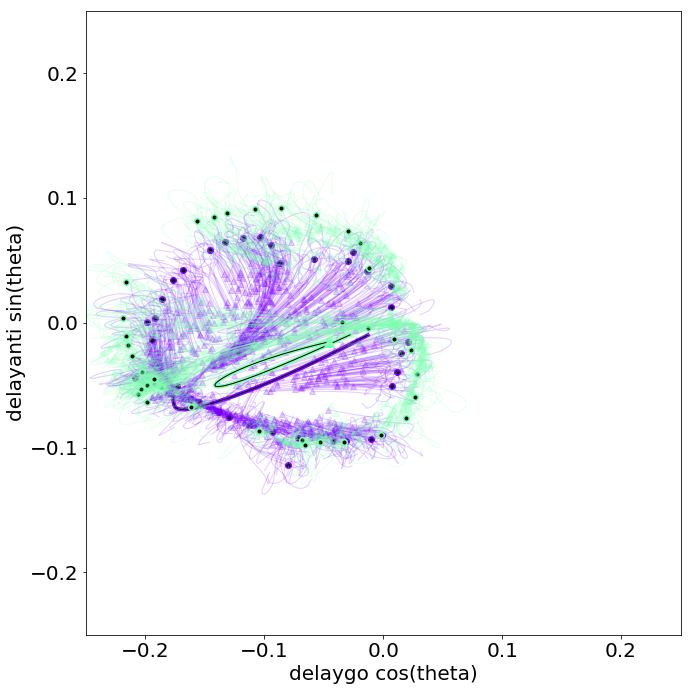

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


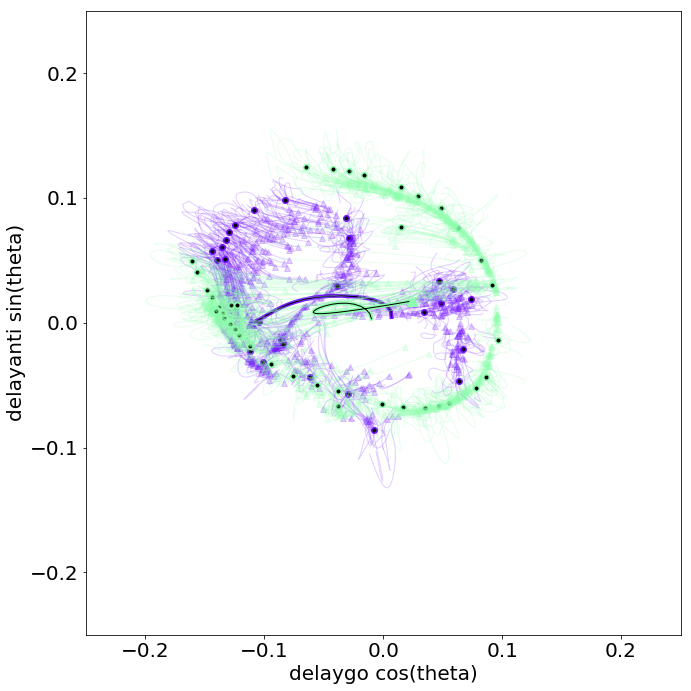

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


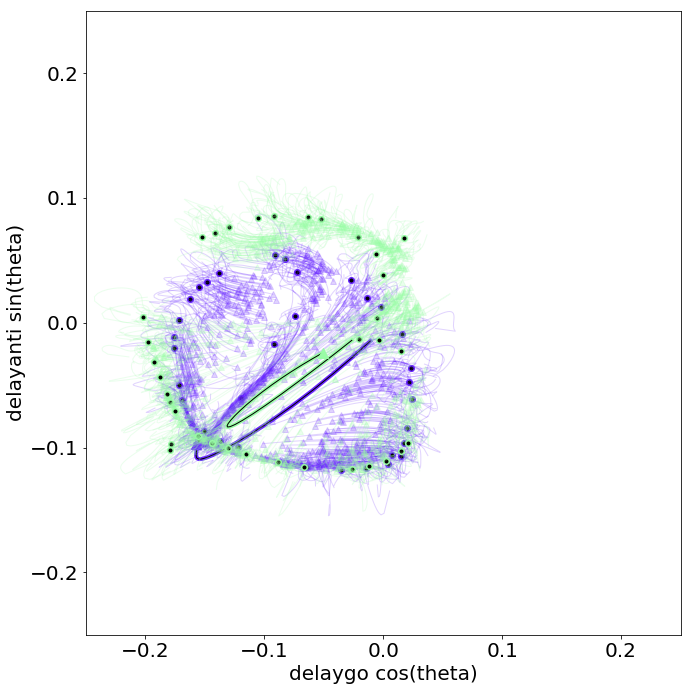

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


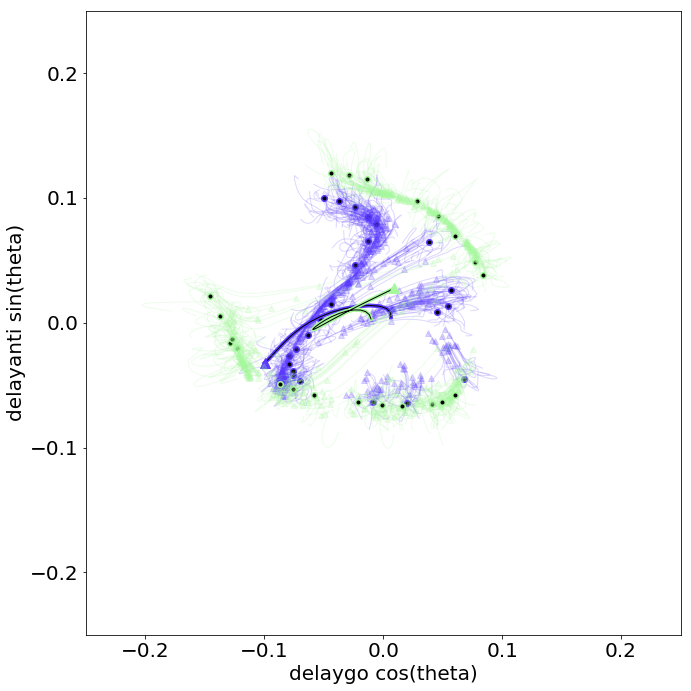

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


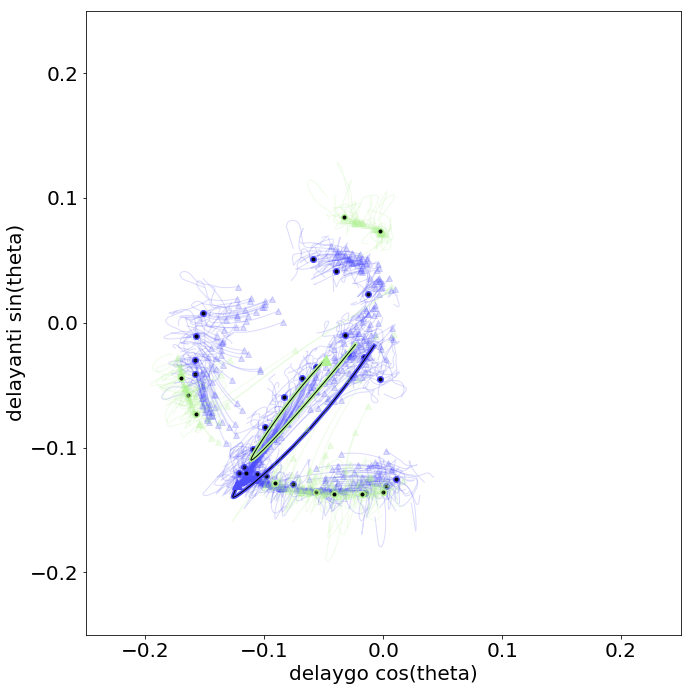

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


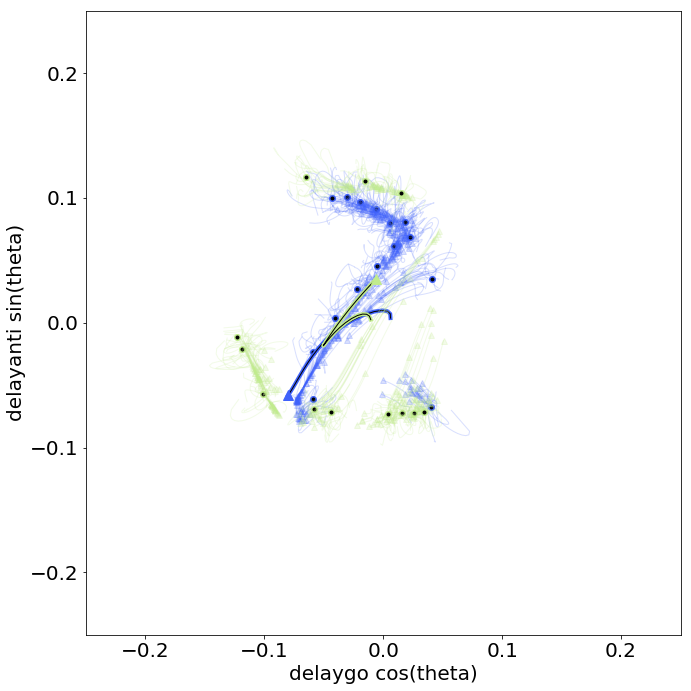

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


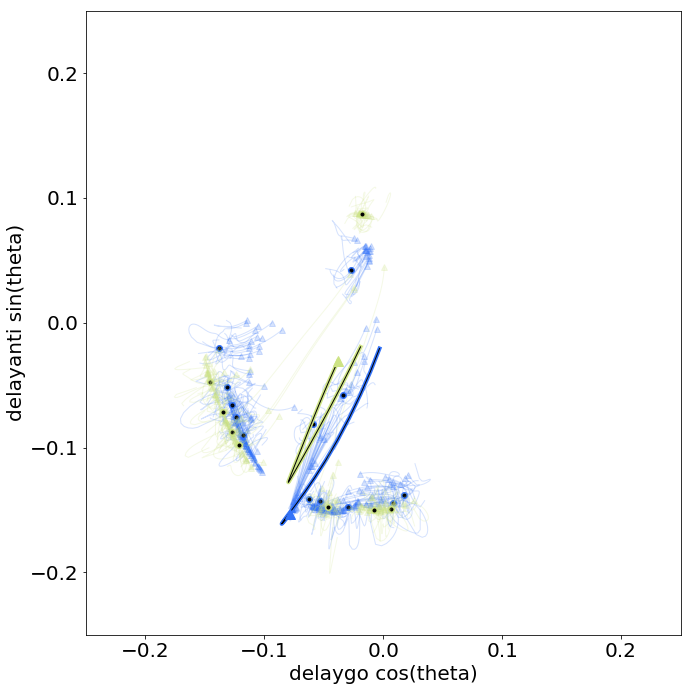

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


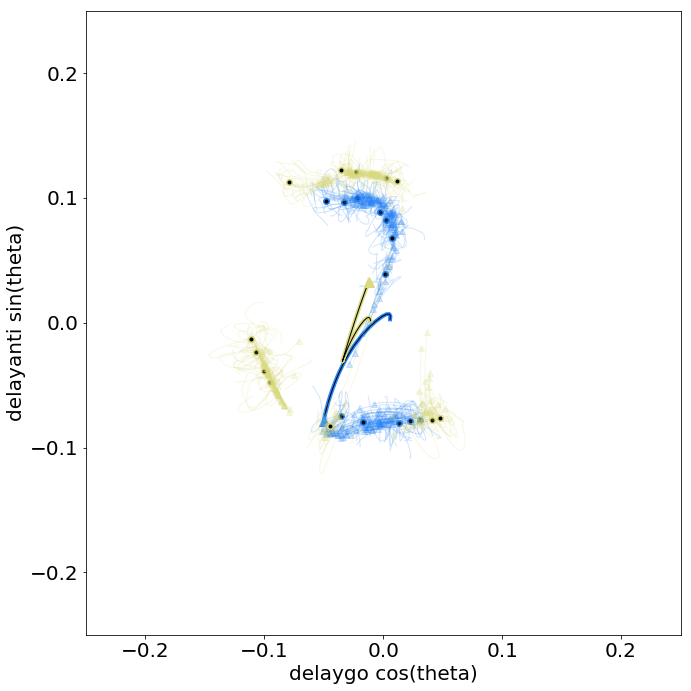

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


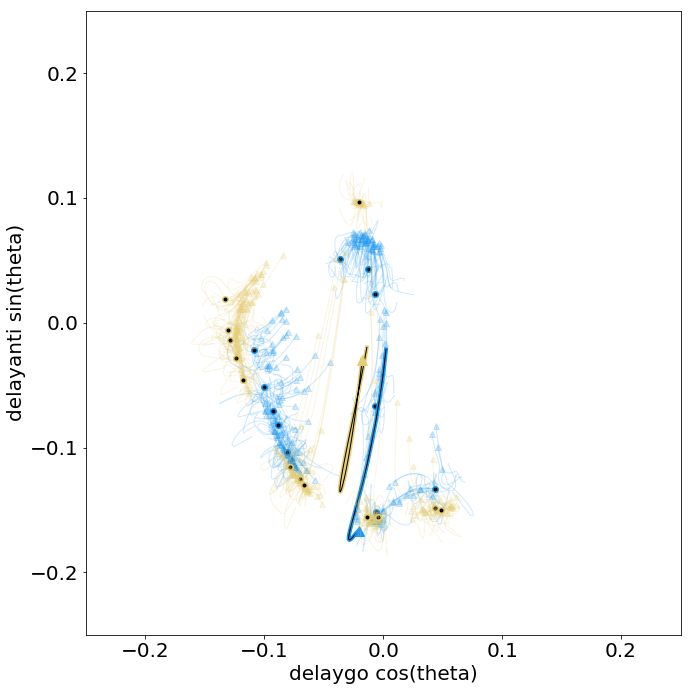

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


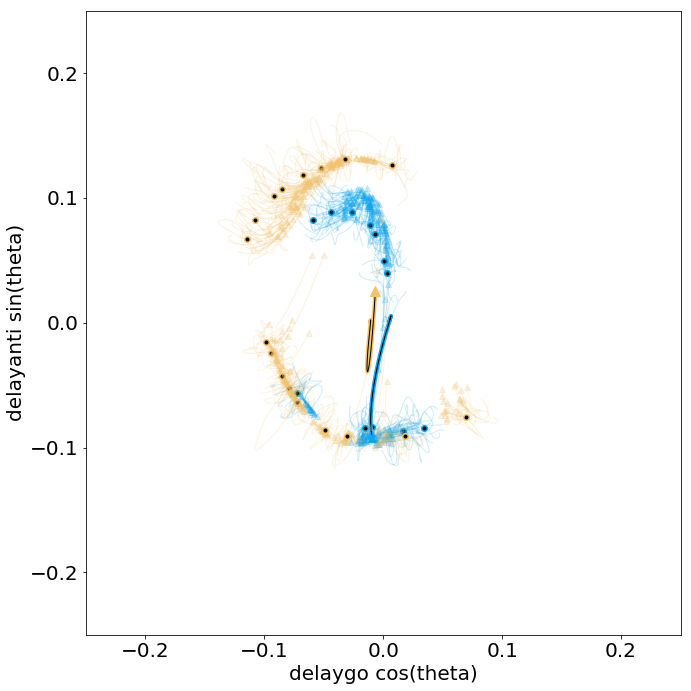

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


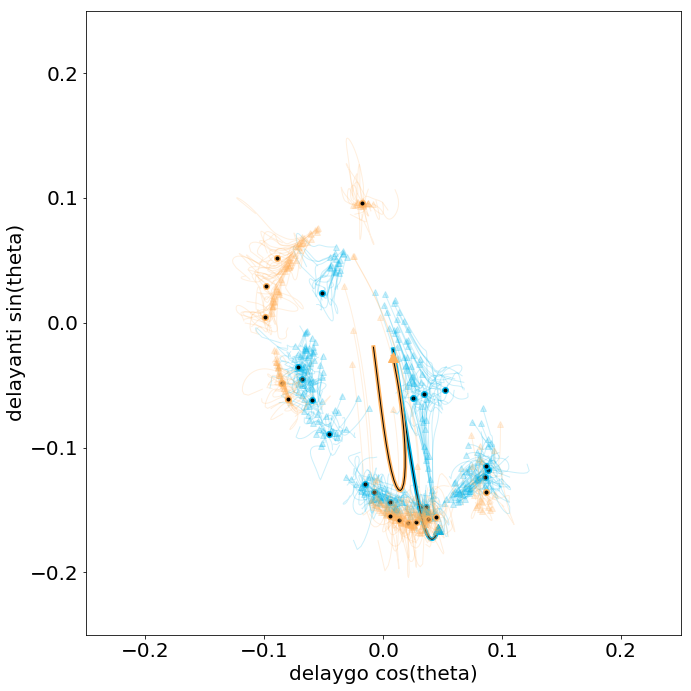

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


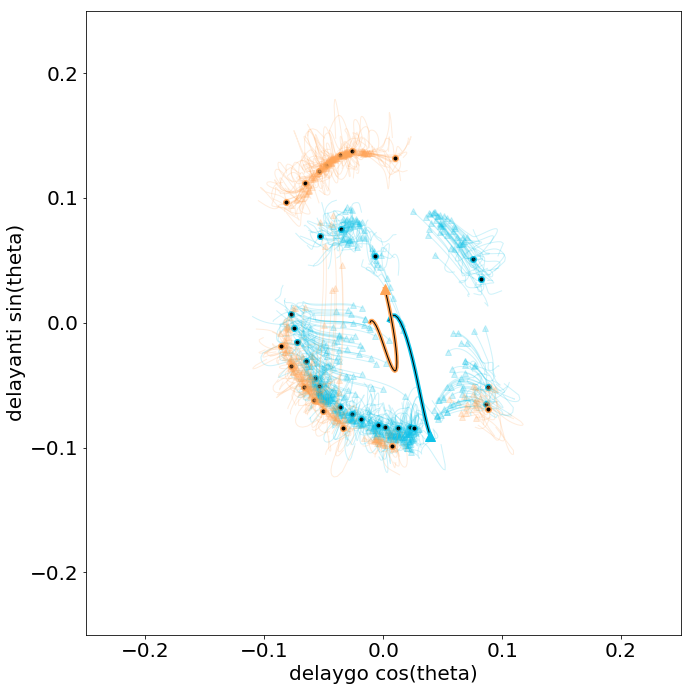

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


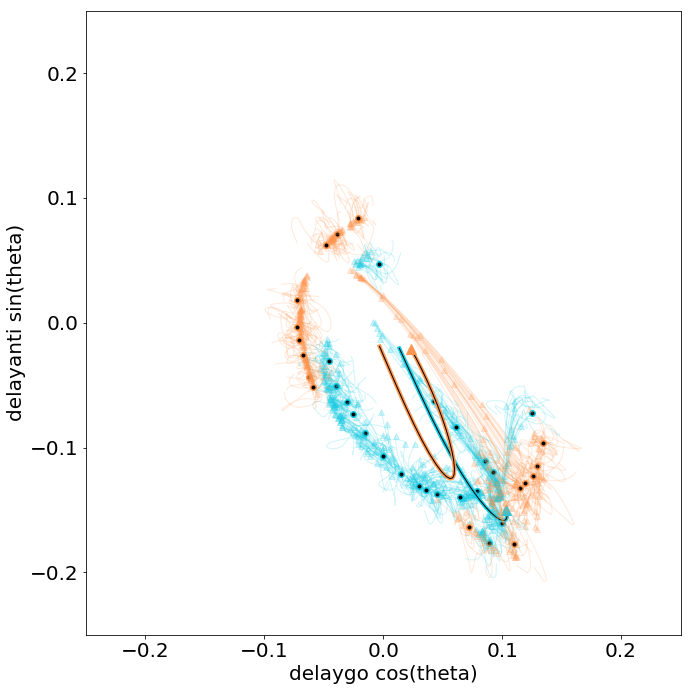

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


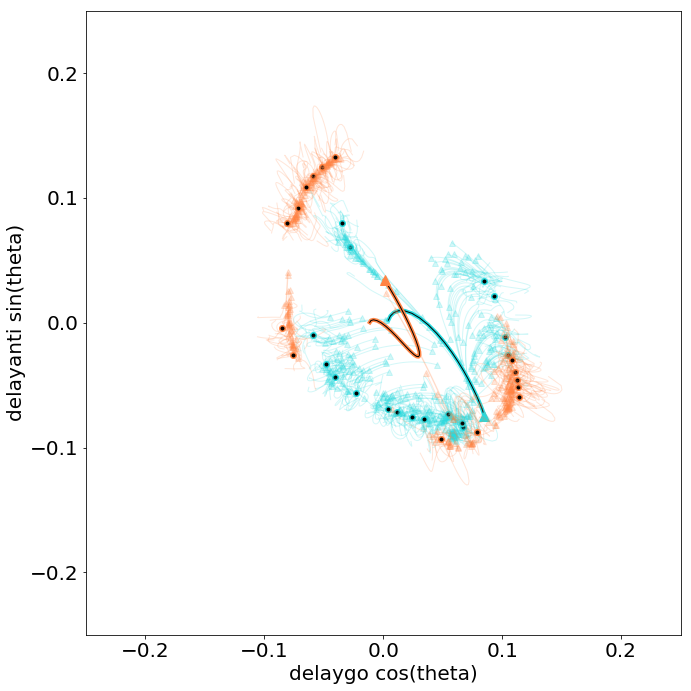

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


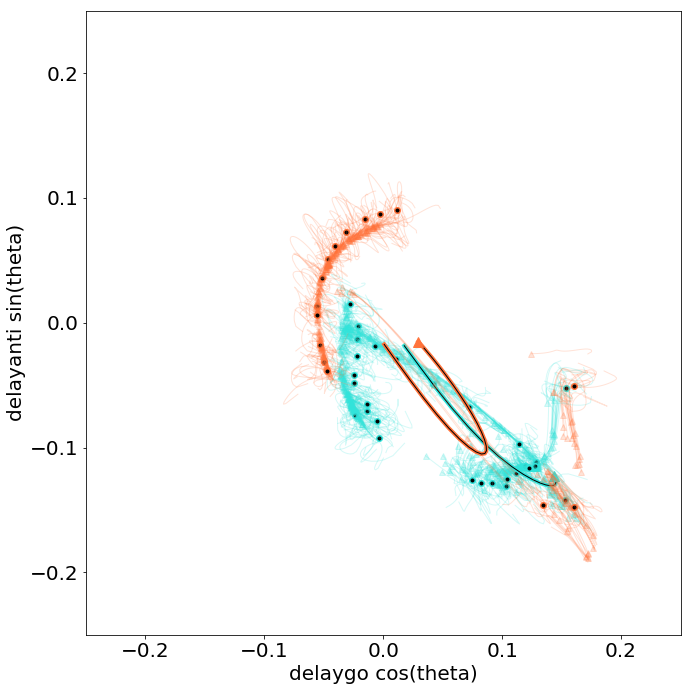

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


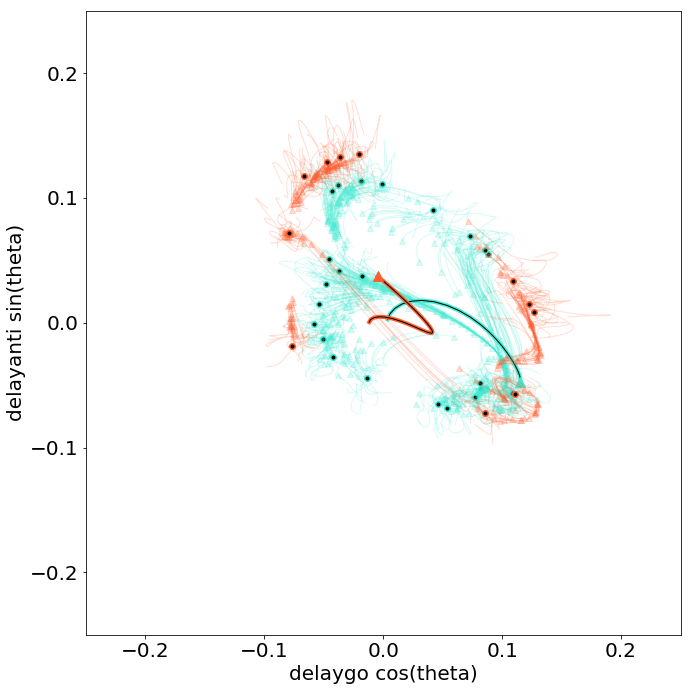

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


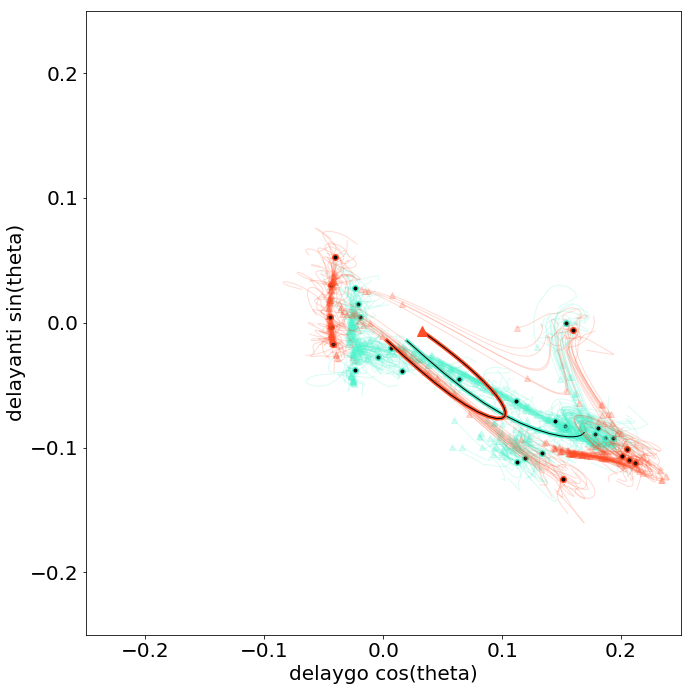

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


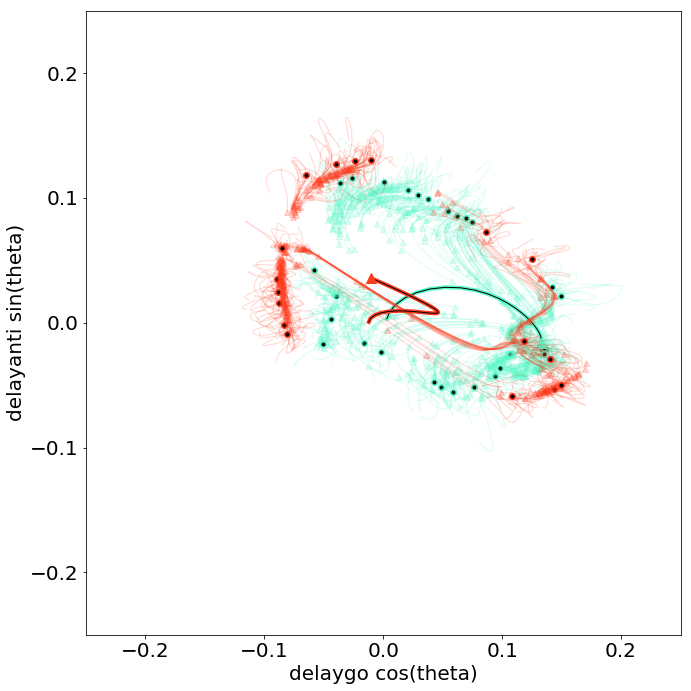

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


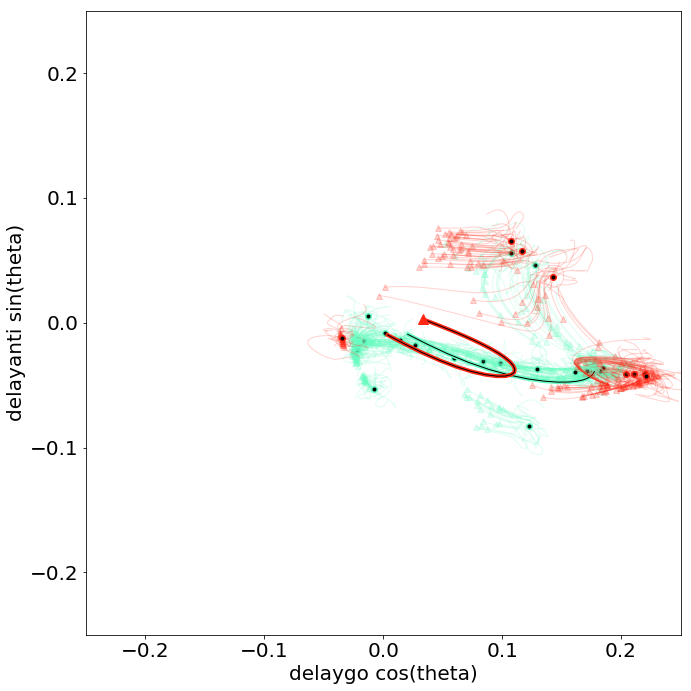

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


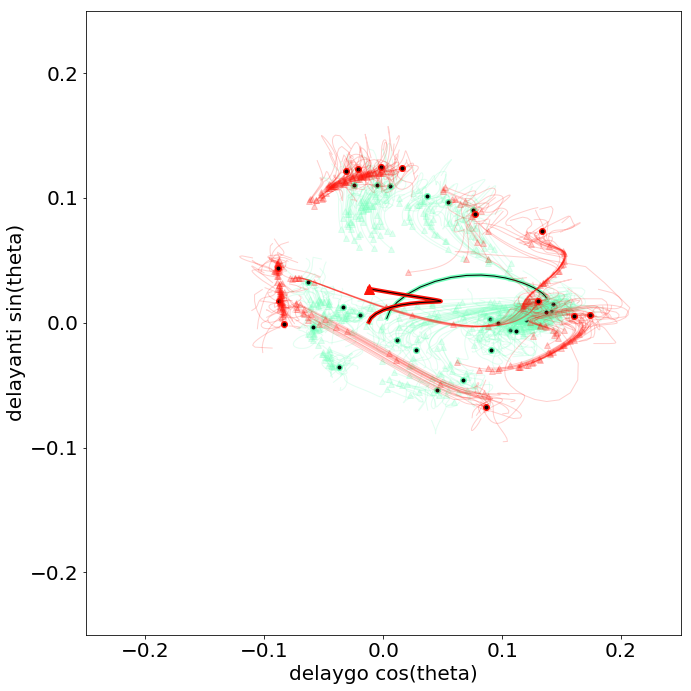

In [185]:
cmap=plt.get_cmap('rainbow')
ut = -9
axis_rule = 'delaygo'

D = make_axes(model_dir_all,ckpt_n_dir,axis_rule)
model = Model(model_dir_all)
with tf.Session() as sess:
    model.saver.restore(sess,ckpt_n_dir)
    model._sigma=0
    hparams = model.hp
    trial = generate_trials(axis_rule, hparams, mode='test', noise_on=False, delay_fac =1)
    feed_dict = tools.gen_feed_dict(model, trial, hparams)
    h_tf = sess.run(model.h, feed_dict=feed_dict) #(n_time, n_condition, n_neuron)

for s in range(10,30):
    fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')
    plot_fp_jitter(model_dir_all,'delaygo',s,ut,D,vanilla_run_at_fp,c=cmap((s-10)/40),rand_step_coef=.01,n_bumps = 20, h_tf = h_tf, trial = trial)
    plot_fp_jitter(model_dir_all,'delayanti',s,ut,D,vanilla_run_at_fp,c=cmap((s+10)/40),rand_step_coef=.01,n_bumps = 20)
    
    plt.ylabel('delayanti' + ' sin(theta)')
    plt.xlabel('delaygo' + ' cos(theta)')
    plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=flo

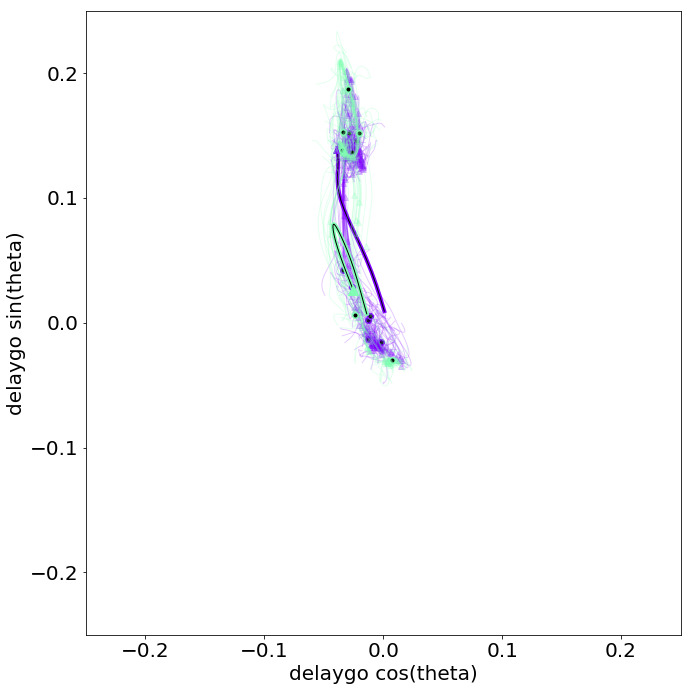

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


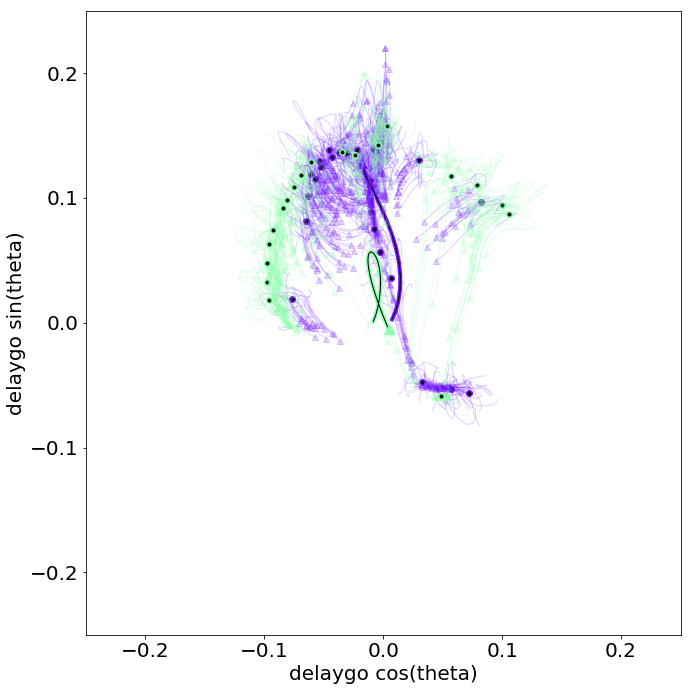

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


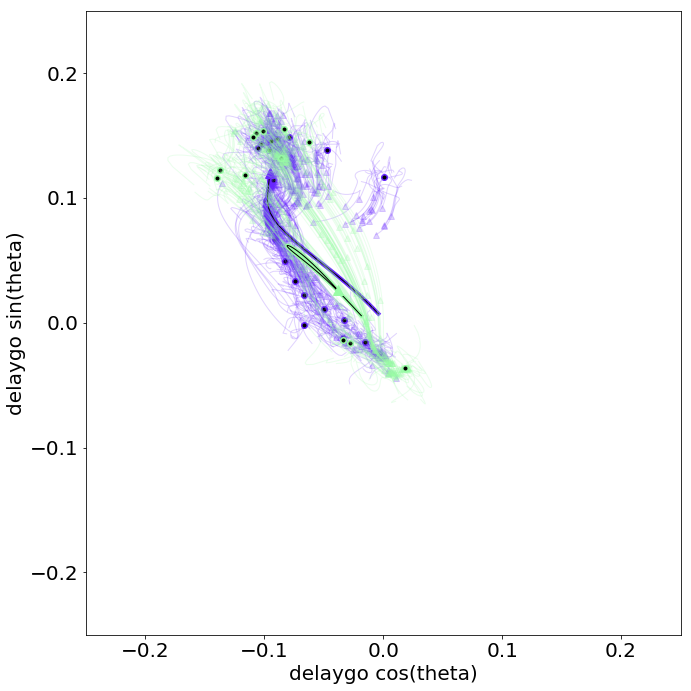

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


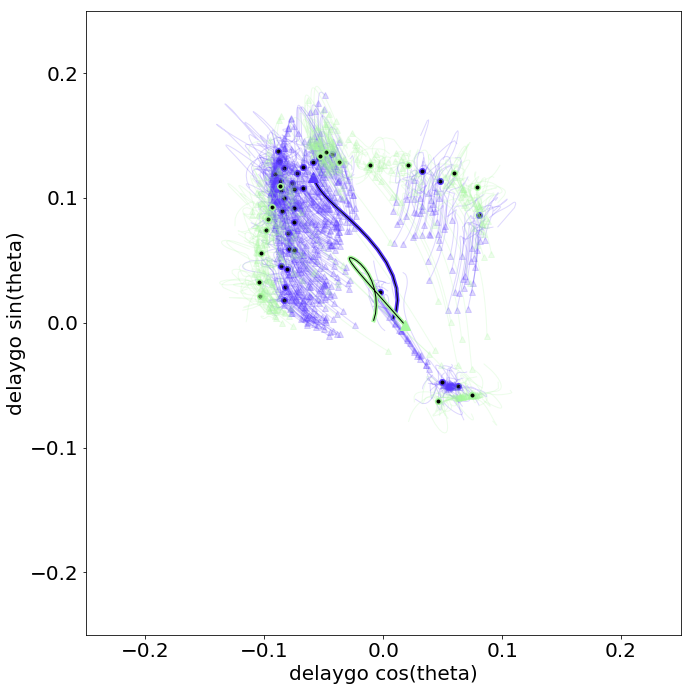

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


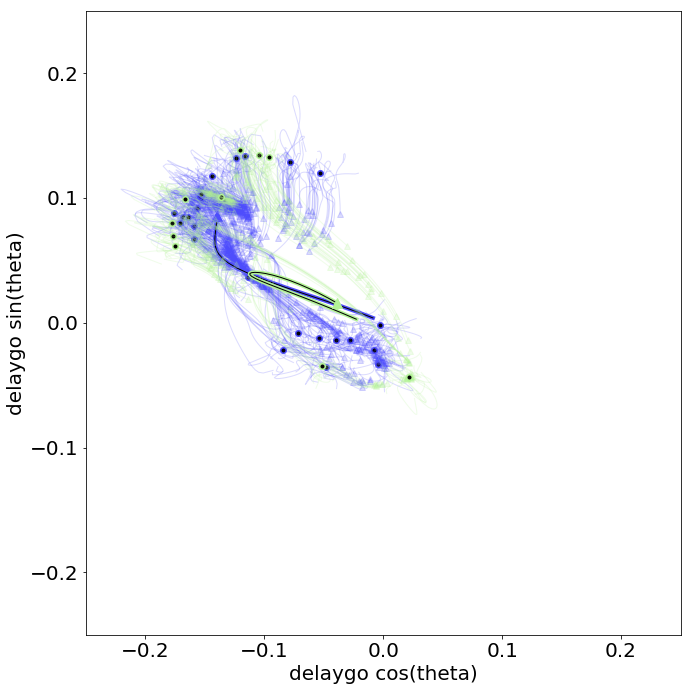

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


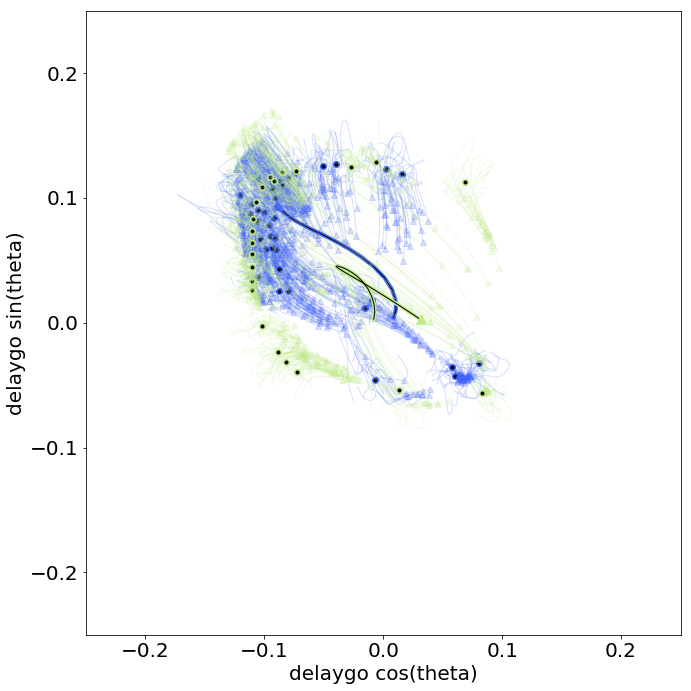

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


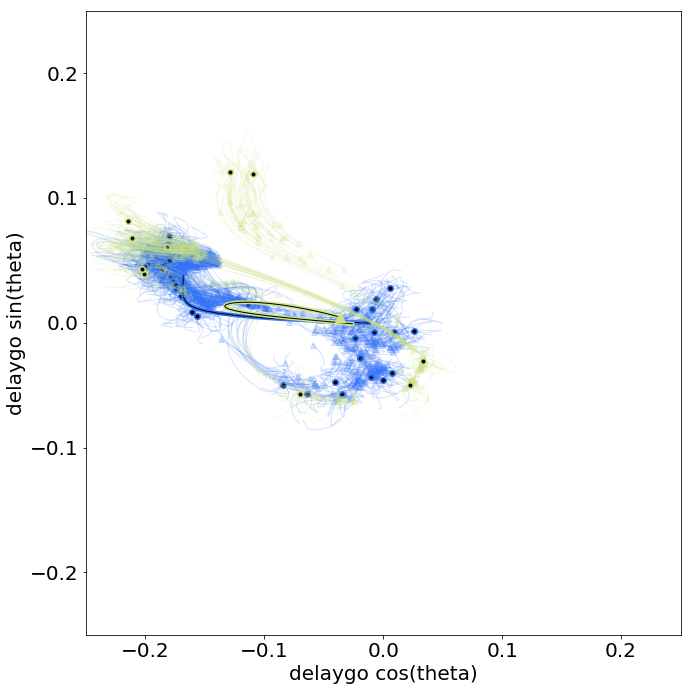

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


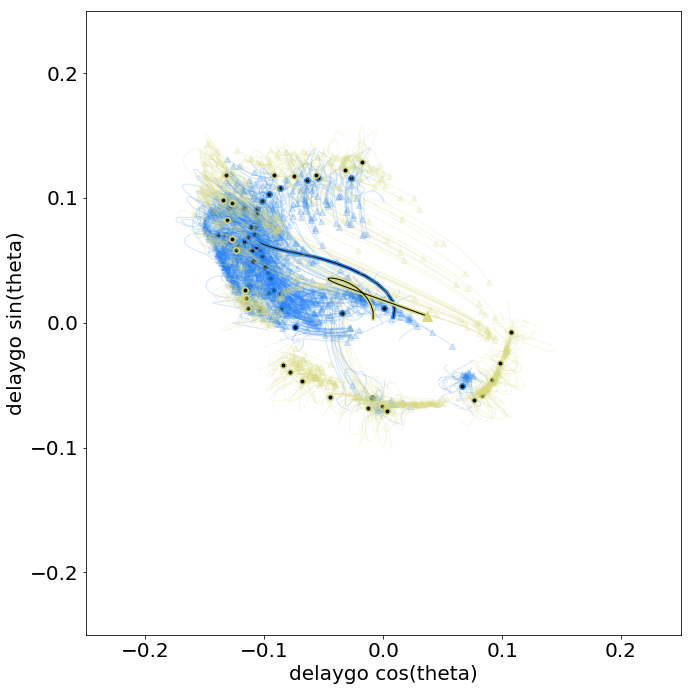

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


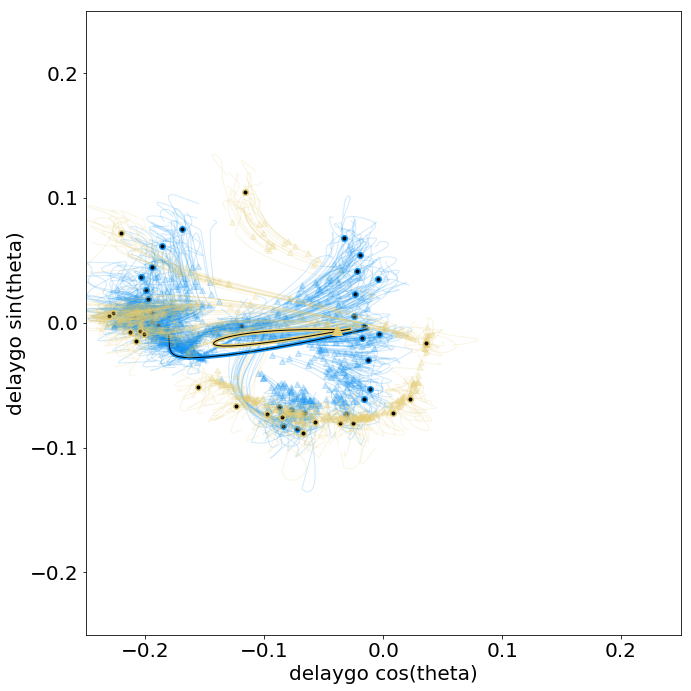

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


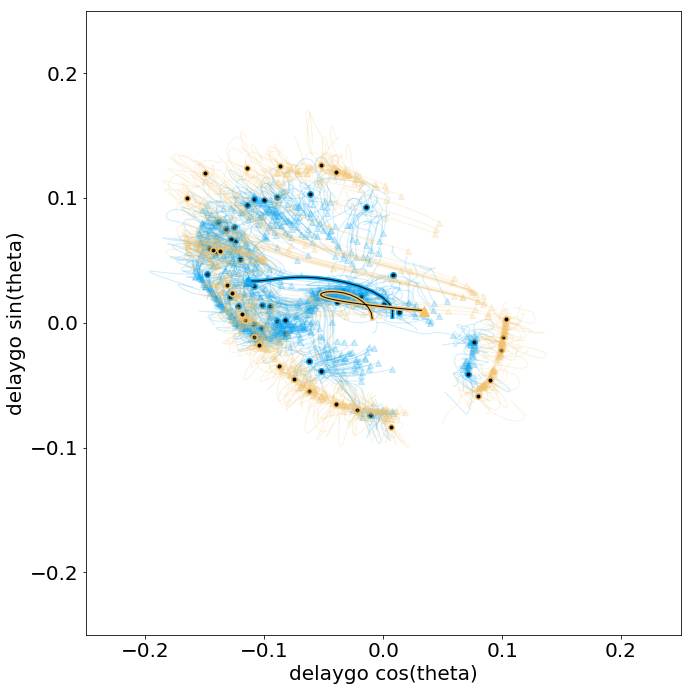

In [190]:
cmap=plt.get_cmap('rainbow')
ut = -9
axis_rule = 'delaygo'

D = make_axes(model_dir_all,ckpt_n_dir,axis_rule)
model = Model(model_dir_all)
with tf.Session() as sess:
    model.saver.restore(sess,ckpt_n_dir)
    model._sigma=0
    hparams = model.hp
    trial = generate_trials(axis_rule, hparams, mode='test', noise_on=False, delay_fac =1)
    feed_dict = tools.gen_feed_dict(model, trial, hparams)
    h_tf = sess.run(model.h, feed_dict=feed_dict) #(n_time, n_condition, n_neuron)

for s in range(10):
    fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')
    plot_fp_jitter(model_dir_all,'delaygo',s,ut,D,vanilla_run_at_fp,c=cmap((s)/40),rand_step_coef=.01,n_bumps = 20, h_tf = h_tf, trial = trial)
    plot_fp_jitter(model_dir_all,'delayanti',s,ut,D,vanilla_run_at_fp,c=cmap((s+20)/40),rand_step_coef=.01,n_bumps = 20)
    
    plt.ylabel(axis_rule + ' sin(theta)')
    plt.xlabel(axis_rule + ' cos(theta)')
    plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000
Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


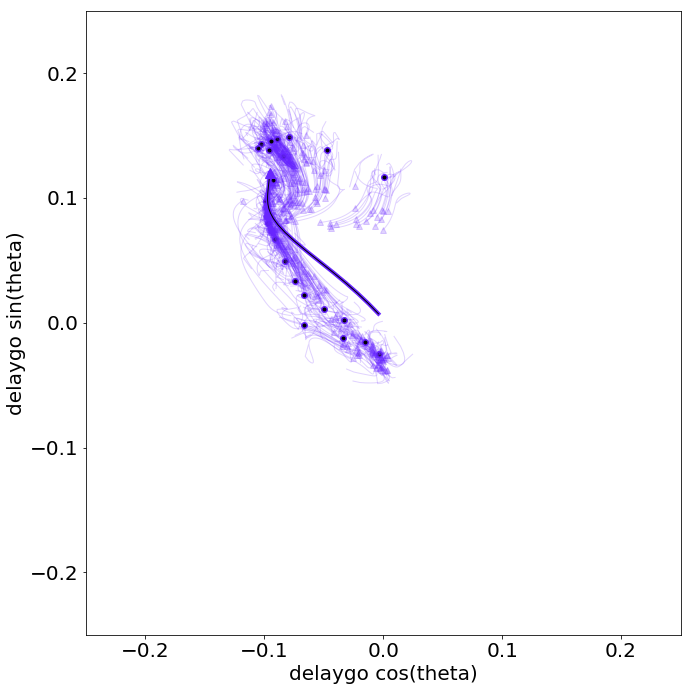

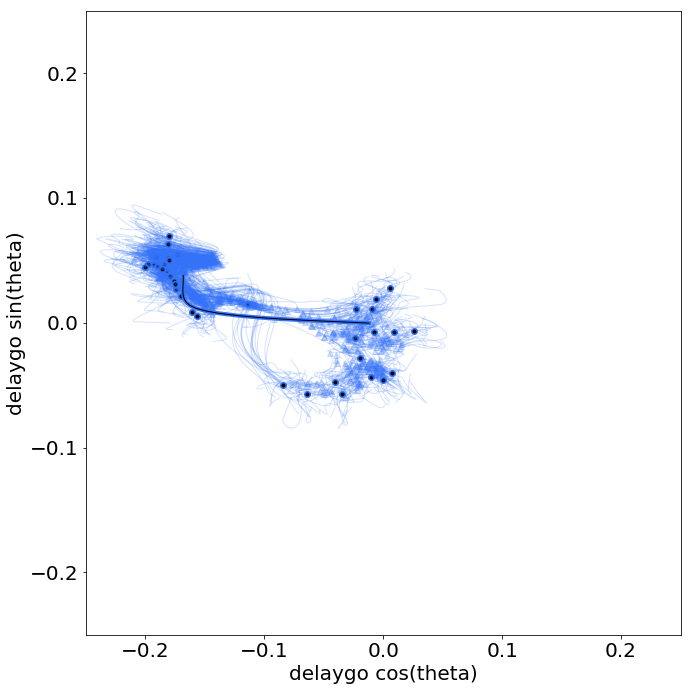

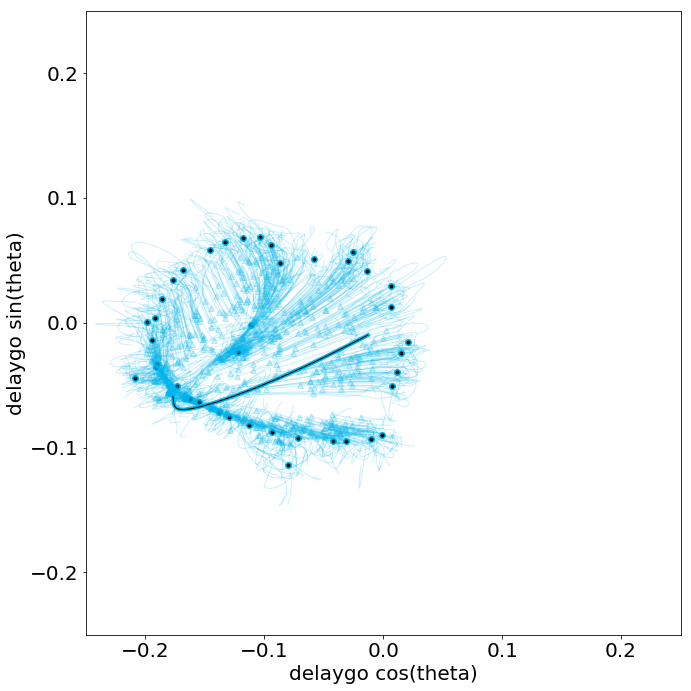

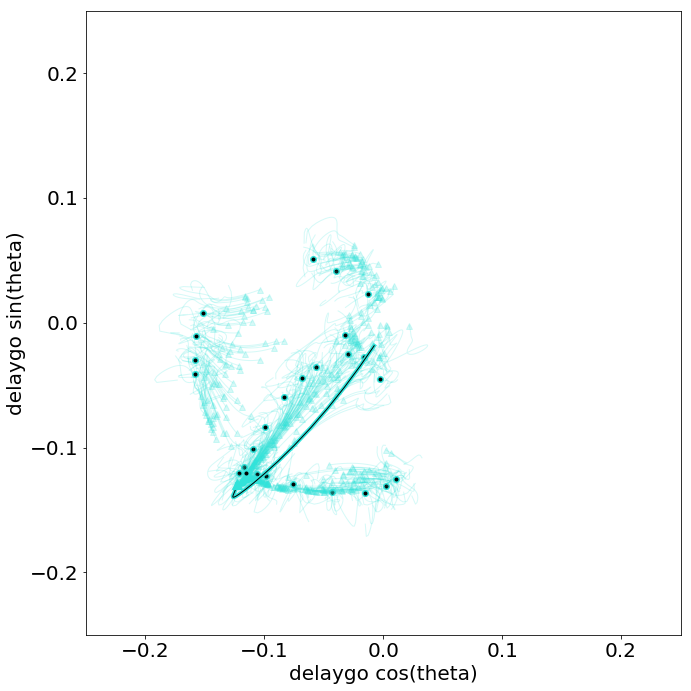

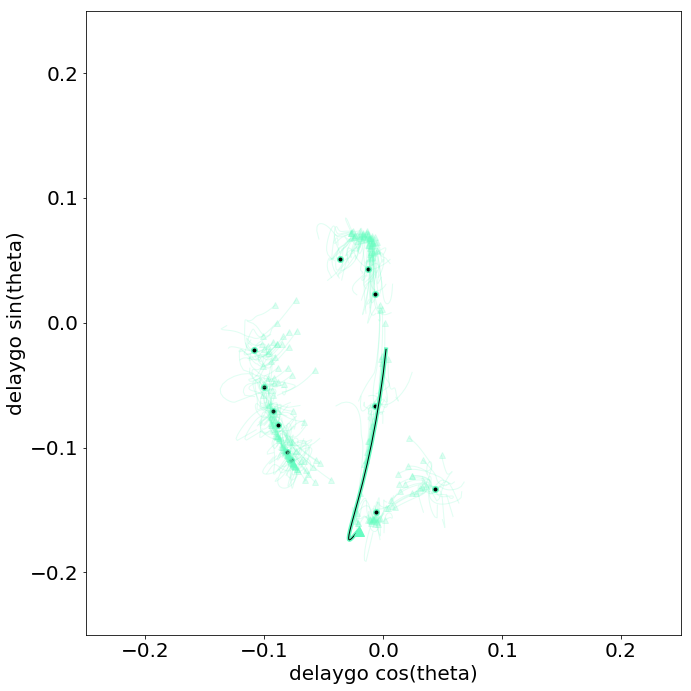

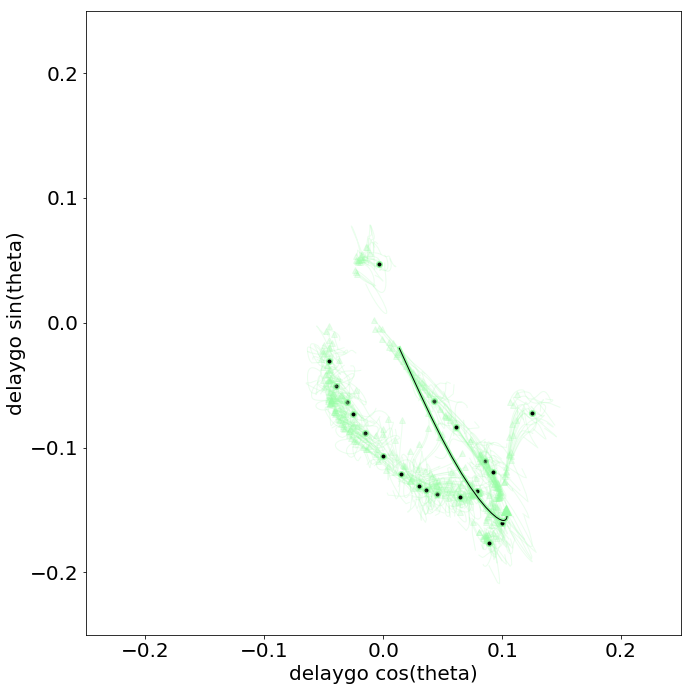

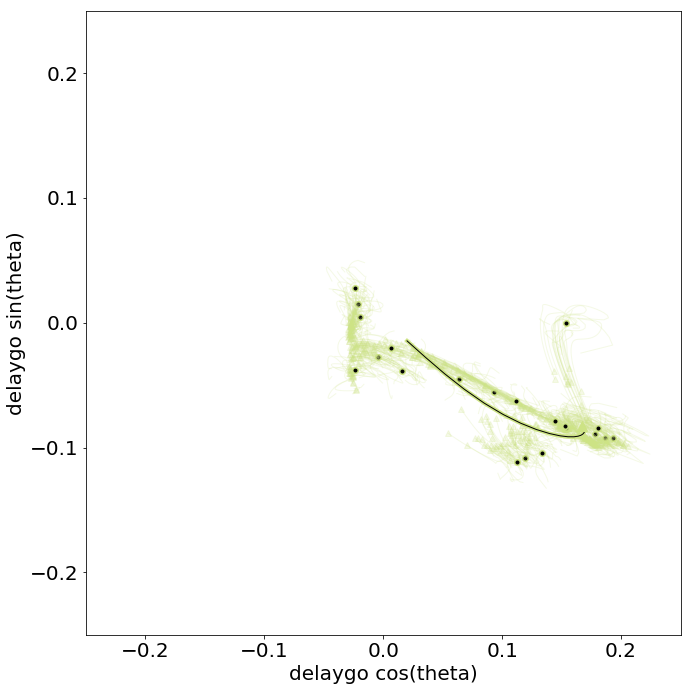

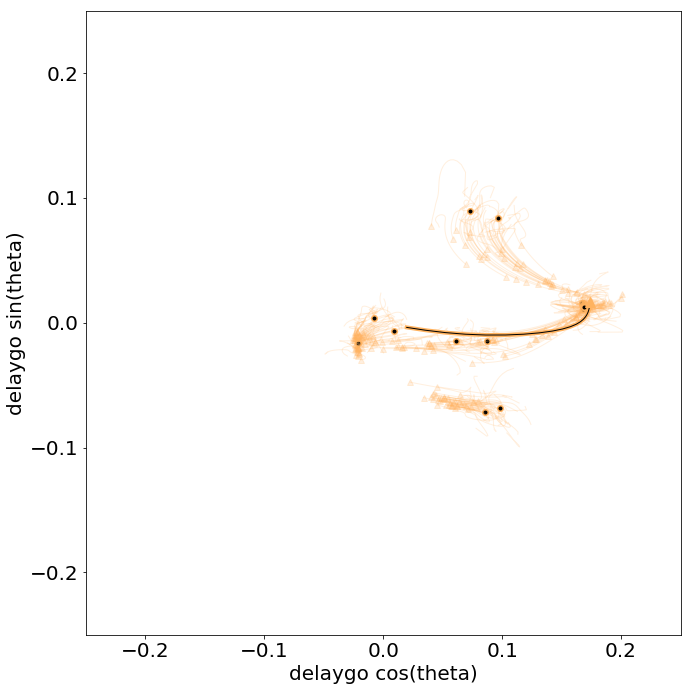

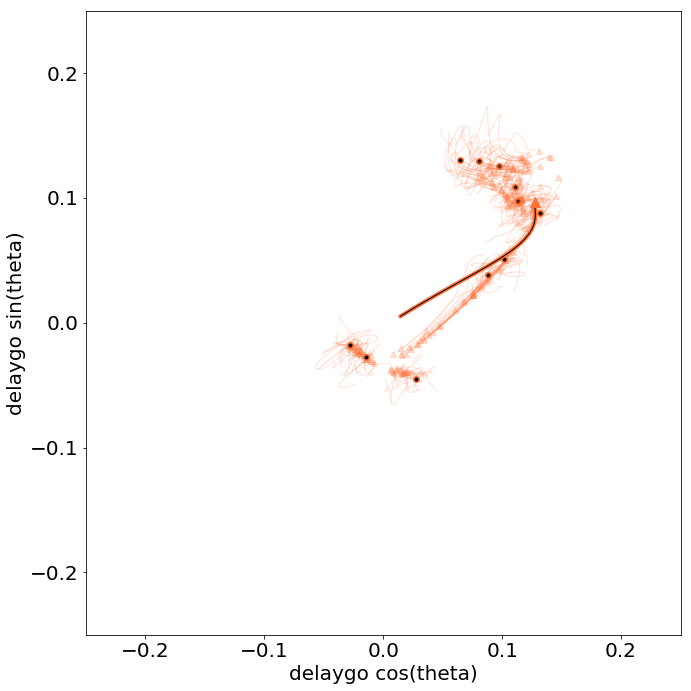

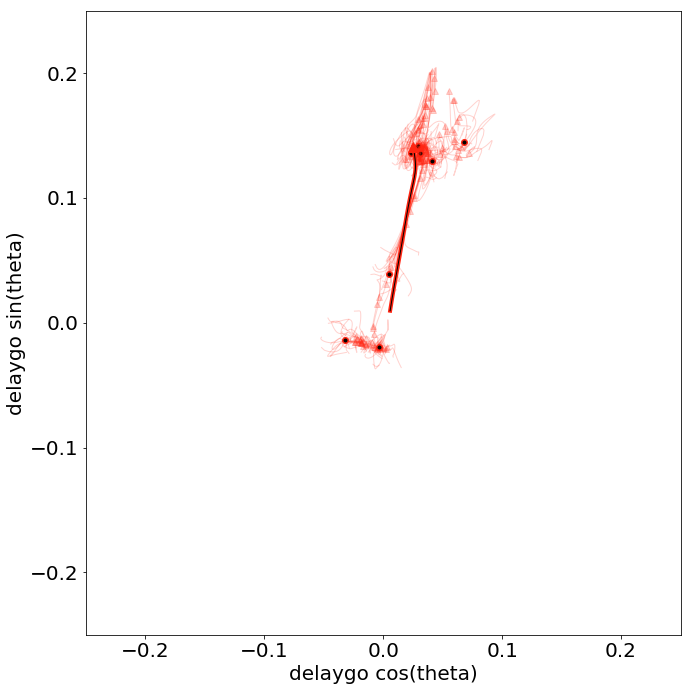

In [192]:
cmap=plt.get_cmap('rainbow')
ut = -9
axis_rule = 'delaygo'

D = make_axes(model_dir_all,ckpt_n_dir,axis_rule)
model = Model(model_dir_all)
with tf.Session() as sess:
    model.saver.restore(sess,ckpt_n_dir)
    model._sigma=0
    hparams = model.hp
    trial = generate_trials(axis_rule, hparams, mode='test', noise_on=False, delay_fac =1)
    feed_dict = tools.gen_feed_dict(model, trial, hparams)
    h_tf = sess.run(model.h, feed_dict=feed_dict) #(n_time, n_condition, n_neuron)

for s in range(2,40,4):
    fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')
    plot_fp_jitter(model_dir_all,'delaygo',s,ut,D,vanilla_run_at_fp,c=cmap(s/40),rand_step_coef=.01,n_bumps = 20, h_tf = h_tf, trial = trial)

    plt.ylabel(axis_rule + ' sin(theta)')
    plt.xlabel(axis_rule + ' cos(theta)')
plt.show()

1.62085e-11


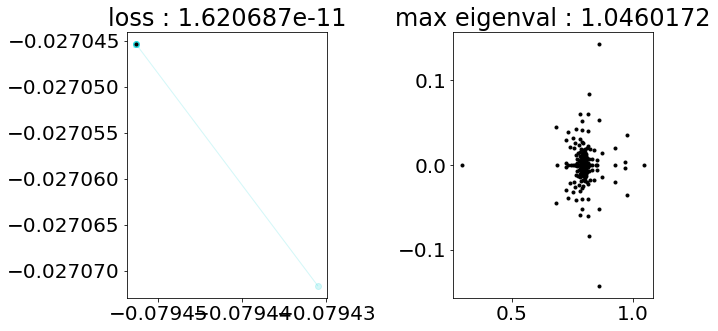

3.374728e-11


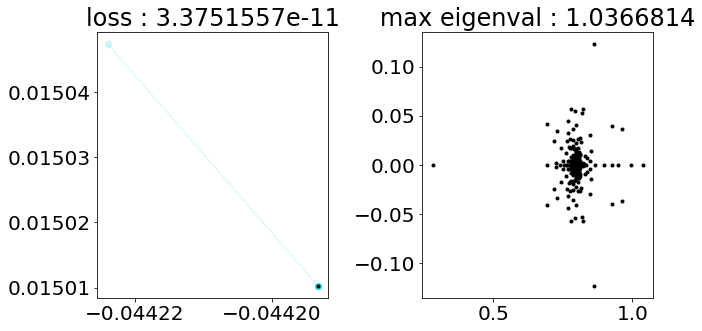

5.434861e-11


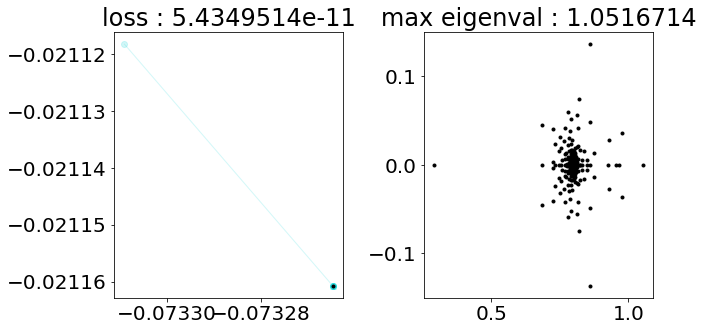

5.491773e-11


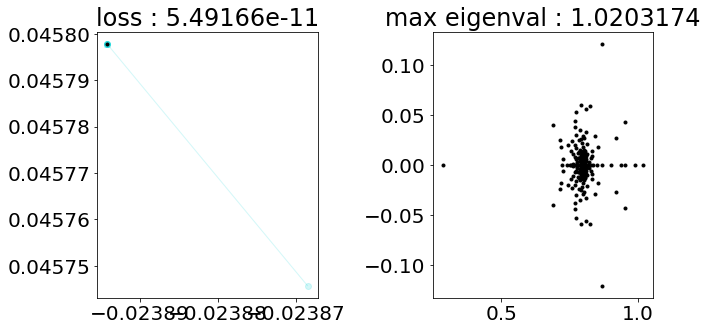

1.279182e-10


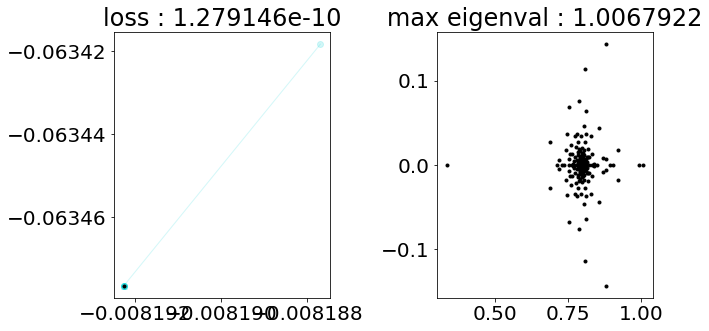

1.4633054e-10


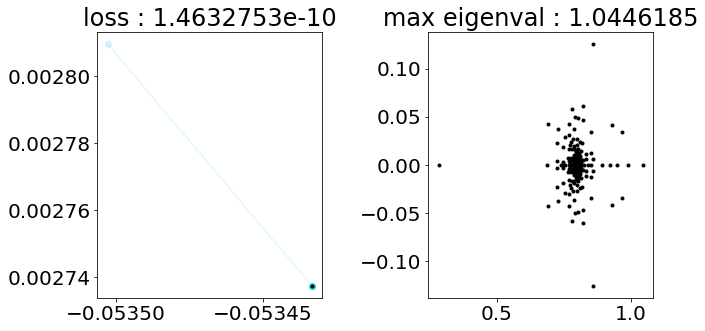

1.493042e-10


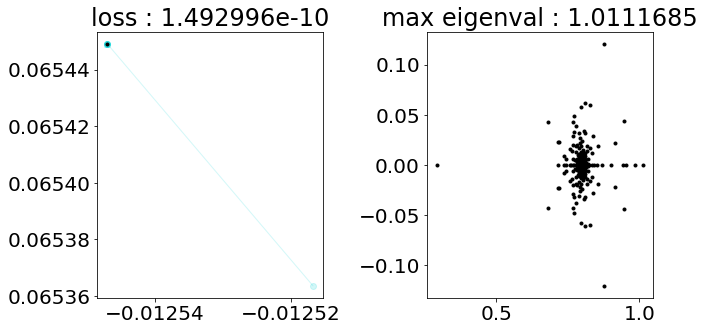

2.0465049e-10


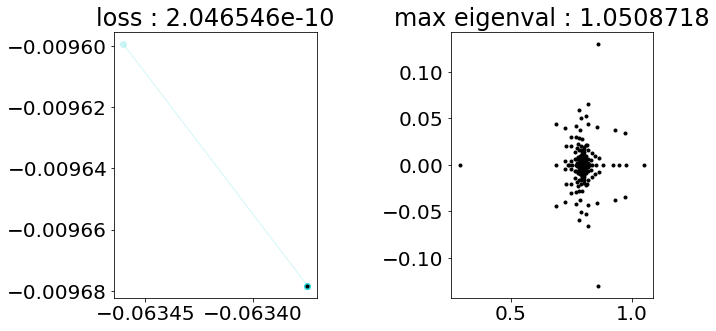

2.0880409e-10


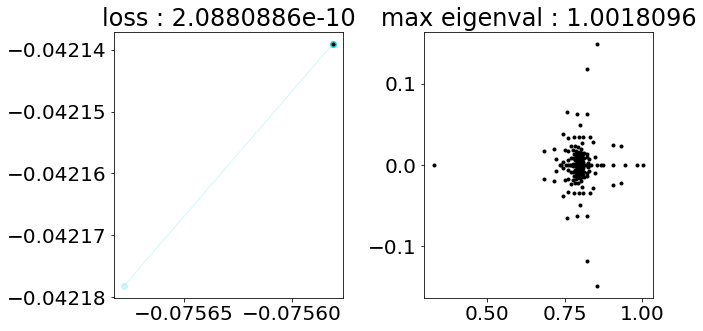

2.1699378e-10


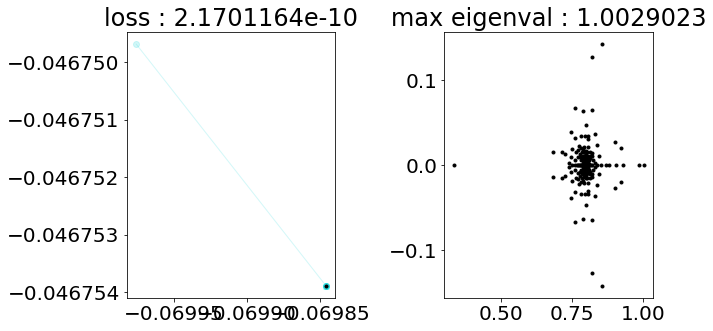

2.5031432e-10


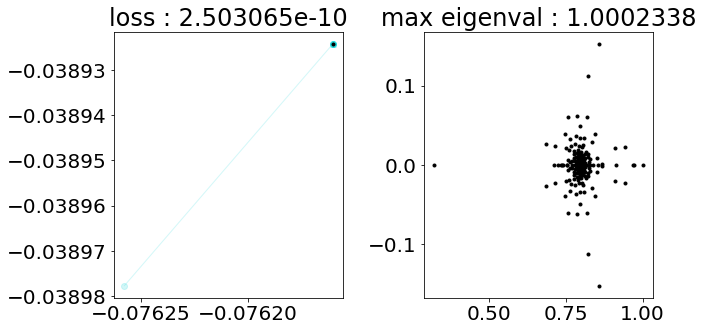

2.5690286e-10


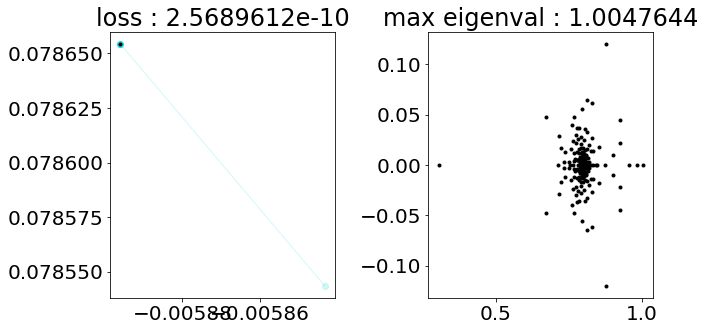

3.4252412e-10


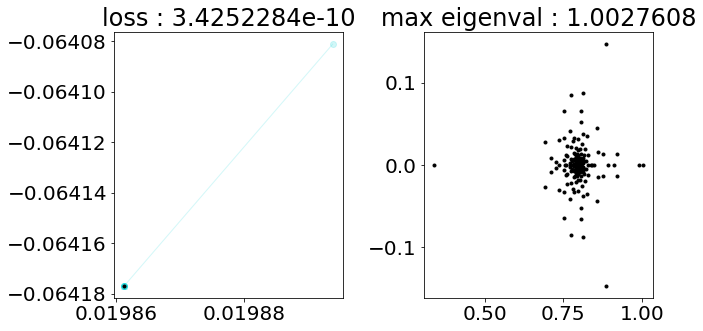

3.5498732e-10


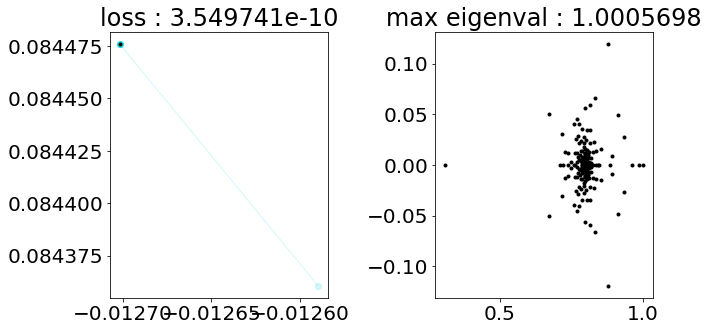

4.5361365e-10


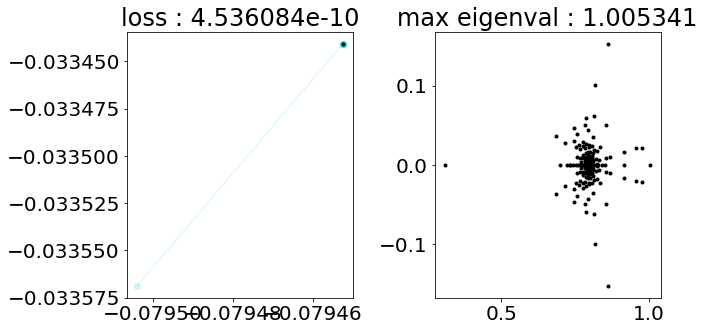

4.6206203e-10


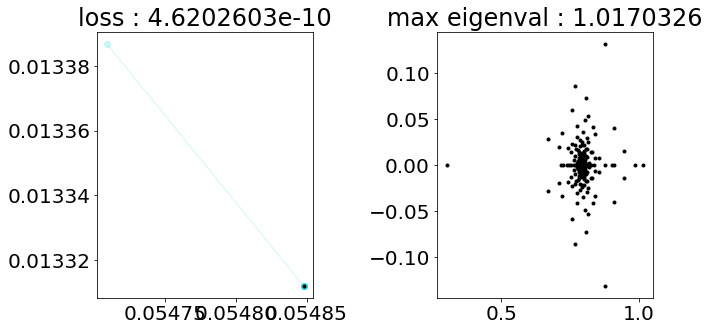

4.79351e-10


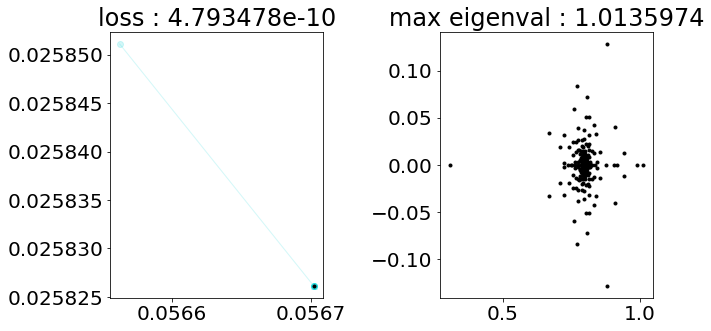

5.0037186e-10


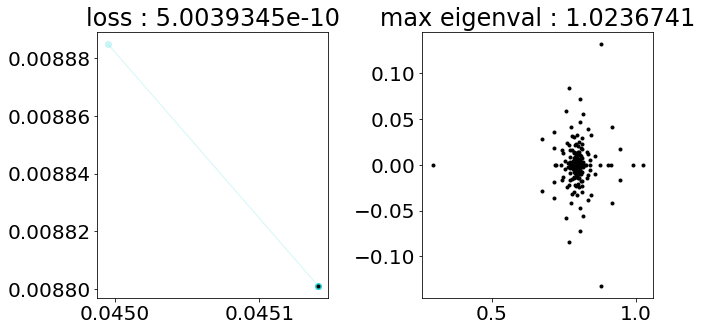

5.550321e-10


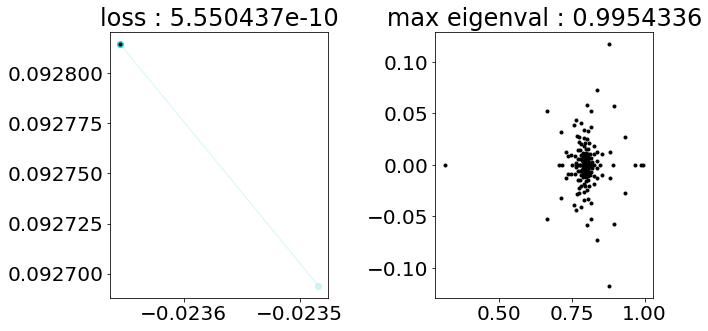

6.672939e-10


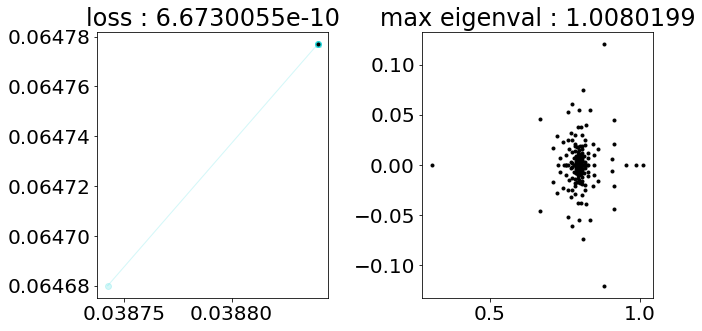

7.0965744e-10


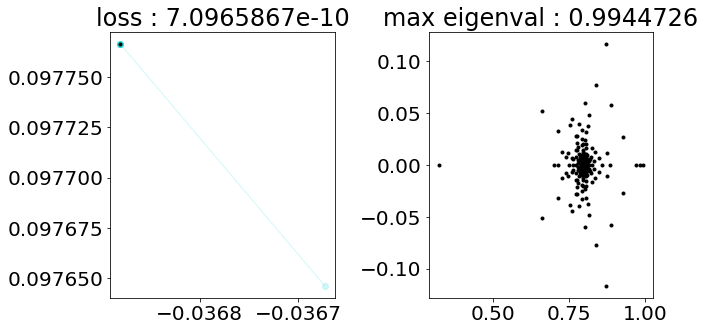

7.36818e-10


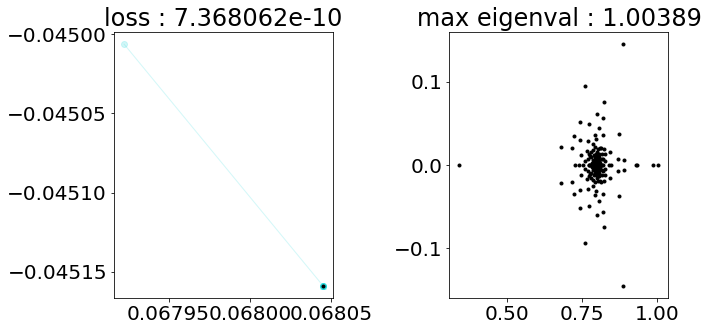

8.380795e-10


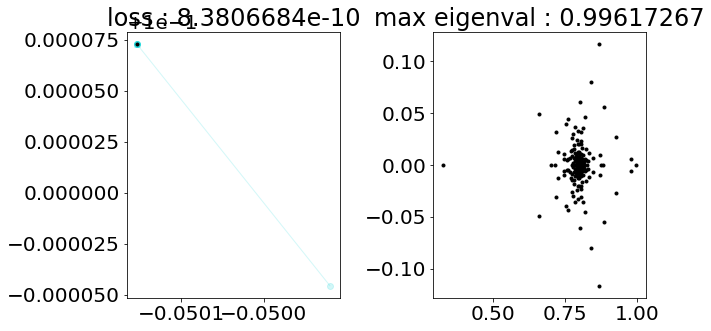

In [160]:
rule = 'delaygo'
s = 13
ut = -9
plot_1fp_jitter(model_dir_all,rule,s,ut,D,vanilla_run_at_fp,n_steps = 1,rand_step_coef=0,n_bumps = 1)
    

In [53]:
fldr = os.path.join(model_dir_all,'fps',rule)
filename = fldr +'/'+ fp_epoch + '_' +  str(ut) + '_' + str(s)+'.npz'
load_all_fps = np.load(filename)

x_star = trial.x[T[1],s,:]
rnn_fun = lambda h : rnn_vanilla(params, h, x_star, alpha)
batch_rnn_fun = vmap(rnn_fun, in_axes=(0,))
loss_fun = lambda h : np.mean((h - batch_rnn_fun(h))**2, axis=1)

In [54]:
h = load_all_fps['fps'][0]
h_new = rnn_vanilla(params, h, x_star, alpha)

In [57]:
load_all_fps['losses']

array([4.5319034e-14, 1.2924721e-11, 1.4437594e-11, 2.5860848e-11,
       7.3795928e-11, 9.3929517e-11, 9.4797059e-11, 1.0939865e-10,
       1.1329106e-10, 1.2261447e-10, 1.3642582e-10, 1.3815382e-10,
       1.3832263e-10, 1.4040963e-10, 1.4935916e-10, 1.6117098e-10,
       1.7757593e-10, 1.7869922e-10, 1.7900989e-10, 2.1195734e-10,
       3.4485254e-10, 3.6390929e-10, 3.7793080e-10, 3.7816111e-10,
       3.8449546e-10, 4.0907833e-10, 4.5983561e-10, 4.6619025e-10,
       5.8571603e-10, 6.1760691e-10, 6.6821637e-10, 6.9336464e-10,
       7.4412748e-10, 7.4504514e-10, 7.4766032e-10, 8.4726826e-10,
       8.9785340e-10], dtype=float32)

In [56]:
loss_fun(load_all_fps['fps'])

DeviceArray([3.2122816e-07, 3.3879917e-07, 4.7506322e-07, 3.1494022e-07,
             3.0923701e-07, 4.7202559e-07, 4.7594185e-07, 2.8663200e-07,
             5.2242365e-07, 3.2553515e-07, 4.6343868e-07, 4.8359493e-07,
             4.5623804e-07, 3.0807217e-07, 4.4298656e-07, 3.3127810e-07,
             3.0961274e-07, 5.0004383e-07, 3.2416483e-07, 4.1021619e-07,
             3.1463469e-07, 3.3335940e-07, 4.4222440e-07, 4.6865614e-07,
             4.8317207e-07, 2.5394849e-07, 2.5472065e-07, 3.9127258e-07,
             5.7487068e-07, 4.3621466e-07, 5.7375348e-07, 3.8044544e-07,
             3.4384246e-07, 5.4181982e-07, 3.6993268e-07, 4.3496937e-07,
             3.5359886e-07], dtype=float32)

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


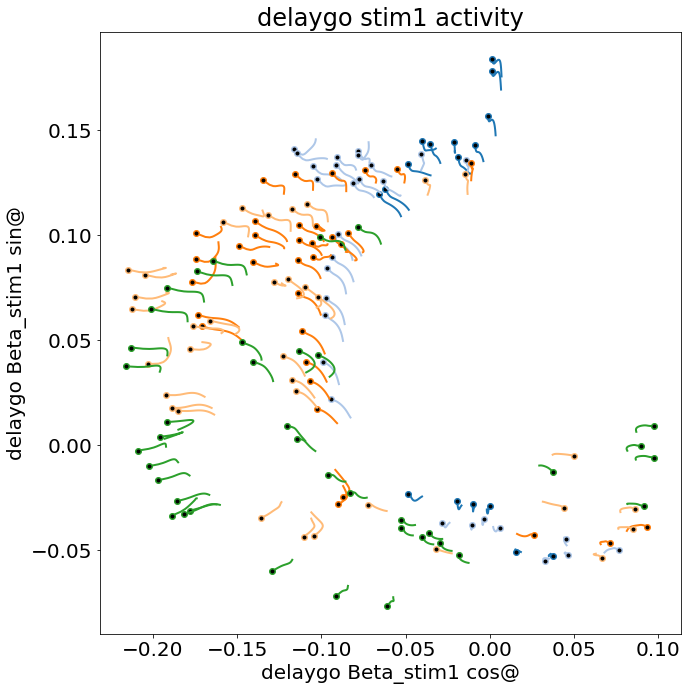

In [26]:
rule_master = 'delaygo'
rule = 'delaygo'

model = Model(model_dir_all)
with tf.Session() as sess:

    model.saver.restore(sess,ckpt_n_dir)
    # get all connection weights and biases as tensorflow variables
    var_list = model.var_list
    # evaluate the parameters after training
    params = [sess.run(var) for var in var_list]
    # get hparams
    hparams = model.hp
    trial_master = generate_trials(rule_master, hparams, mode = 'test', batch_size = 400, noise_on=False, delay_fac =1)
    feed_dict = tools.gen_feed_dict(model, trial_master, hparams)
    h_tf = sess.run(model.h, feed_dict=feed_dict) #(n_time, n_trials, n_neuron)
        
Beta_epoch = generate_Beta_epoch(h_tf,trial_master)
X_pca = Beta_epoch['stim1']    
D = np.concatenate((np.expand_dims(X_pca[:,0],axis=1),np.expand_dims(X_pca[:,1],axis=1)),axis = 1)
trial = generate_trials(rule, hparams, mode='test', noise_on=False, batch_size = 128, delay_fac =1)


fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')

num_trials = np.shape(trial.x)[1]
T = range(trial.epochs[fp_epoch][0],trial.epochs[fp_epoch][1]-1)

for s in range(10):#range(0,num_trials,4):
    filename = fldr +'/'+ fp_epoch + '_' +  str(-9) + '_' + str(s)+'.npz'
    load_all_fps = np.load(filename)
    
    x_star = trial.x[T,s,:]
    c = cmap(s/num_trials)

    for nfp in range(np.shape(load_all_fps['fps'])[0]):
        h0 = np.squeeze(load_all_fps['fps'][nfp,:])

        h_t = vanilla_run_at_fp(params, x_star, h0, alpha)

        X_trial = onp.dot(h_t,D)
        plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 2)

        X_trial = onp.dot(h0.T,D)
        plt.plot(X_trial[0],X_trial[1],'o',c = c, linewidth = 2)
        plt.plot(X_trial[0],X_trial[1],'.k', linewidth = 2)
        
plt.xlabel(rule_master + ' Beta_' + fp_epoch + ' cos@')
plt.ylabel(rule_master + ' Beta_' + fp_epoch + ' sin@') 
plt.title(rule + ' '+ fp_epoch+' activity')    
plt.show()

Variables being optimized:
<tf.Variable 'rnn/leaky_rnn_cell/kernel:0' shape=(281, 256) dtype=float32_ref>
<tf.Variable 'rnn/leaky_rnn_cell/bias:0' shape=(256,) dtype=float32_ref>
<tf.Variable 'output/weights:0' shape=(256, 3) dtype=float32_ref>
<tf.Variable 'output/biases:0' shape=(3,) dtype=float32_ref>
INFO:tensorflow:Restoring parameters from /Users/lauradriscoll/Documents/data/rnn/multitask/crystals/softplus/l2h00001/0/ckpts/model.ckpt-1372000


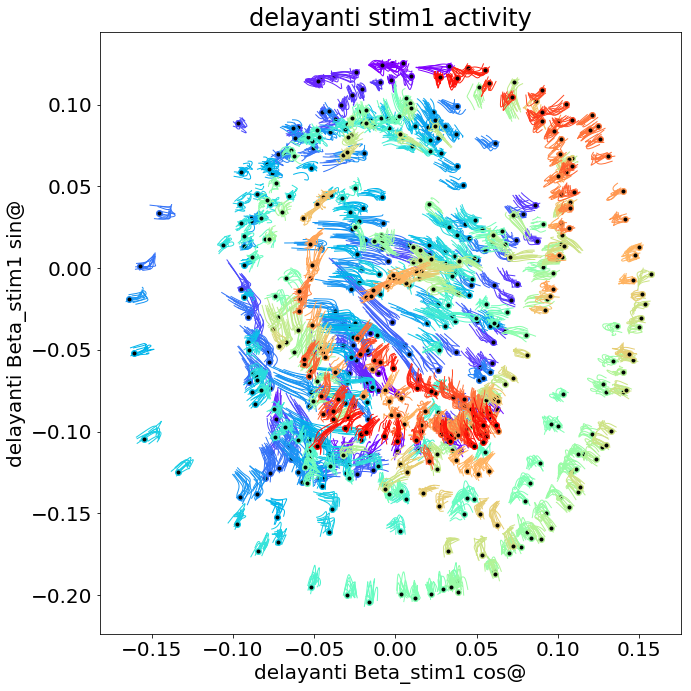

In [247]:
rule_master = 'delayanti'
rule = 'delayanti'
rand_step_coef = .002

model = Model(model_dir_all)
with tf.Session() as sess:

    model.saver.restore(sess,ckpt_n_dir)
    # get all connection weights and biases as tensorflow variables
    var_list = model.var_list
    # evaluate the parameters after training
    params = [sess.run(var) for var in var_list]
    # get hparams
    hparams = model.hp
    trial_master = generate_trials(rule_master, hparams, mode = 'test', batch_size = 400, noise_on=False, delay_fac =1)
    feed_dict = tools.gen_feed_dict(model, trial_master, hparams)
    h_tf = sess.run(model.h, feed_dict=feed_dict) #(n_time, n_trials, n_neuron)
        
Beta_epoch = generate_Beta_epoch(h_tf,trial_master)
X_pca = Beta_epoch['stim1']    
D = np.concatenate((np.expand_dims(X_pca[:,0],axis=1),np.expand_dims(X_pca[:,1],axis=1)),axis = 1)
trial = generate_trials(rule, hparams, mode='test', noise_on=False, batch_size = 128, delay_fac =1)
fig = plt.figure(figsize=(10,10),tight_layout=True,facecolor='white')

num_trials = np.shape(trial.x)[1]
T = range(trial.epochs[fp_epoch][0],trial.epochs[fp_epoch][1]-1)
N = np.shape(params[0])[1]

for s in range(num_trials):
    filename = fldr +'/'+ fp_epoch + '_' +  str(-9) + '_' + str(s)+'.npz'
    load_all_fps = np.load(filename)
    
    x_star = trial.x[T,s,:]
    c = cmap(s/num_trials)

    for nfp in range(np.shape(load_all_fps['fps'])[0]):
        h0 = np.squeeze(load_all_fps['fps'][nfp,:])

        for bump_num in range(10):
            h = h0 + rand_step_coef*npr.randn(N)
            h_t = vanilla_run_at_fp(params, x_star, h, alpha)

            X_trial = onp.dot(h_t,D)
            plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 1)

        X_trial = onp.dot(h0.T,D)
        plt.plot(X_trial[0],X_trial[1],'o',c = c, linewidth = 2)
        plt.plot(X_trial[0],X_trial[1],'.k', linewidth = 2)
        
plt.xlabel(rule_master + ' Beta_' + fp_epoch + ' cos@')
plt.ylabel(rule_master + ' Beta_' + fp_epoch + ' sin@') 
plt.title(rule + ' '+ fp_epoch+' activity')    
plt.show()    
plt.show()

In [82]:
q = np.diff(h_t,n=1,axis = 0)
np.shape(h_t)

(25, 256)

In [87]:
np.asarray(h_t)

ValueError: All input arrays must have the same shape.

In [107]:
np.shape(h_t[2] - h_t[1])

(256, 1)

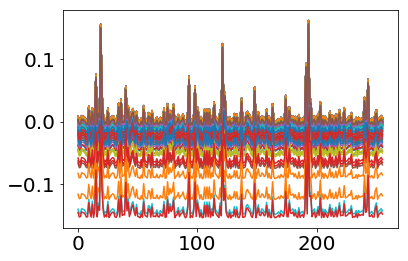

9.4685255e-09


In [110]:
# def q_step1(h_t):

plt.plot(h_t[1] - h_t[0])
plt.show()
print(load_all_fps['losses'][nfp])

before: 4.458055e-07 2.0595836e-10
before: 4.458055e-07 2.0595836e-10
before: 4.458055e-07 2.0595836e-10
before: 4.458055e-07 2.0595836e-10
before: 4.458055e-07 2.0595836e-10
before: 4.458055e-07 2.0595836e-10
before: 4.458055e-07 2.0595836e-10
before: 4.458055e-07 2.0595836e-10
before: 4.458055e-07 2.0595836e-10
before: 4.458055e-07 2.0595836e-10


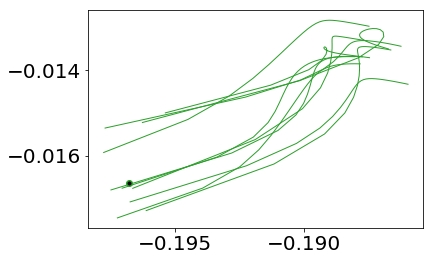

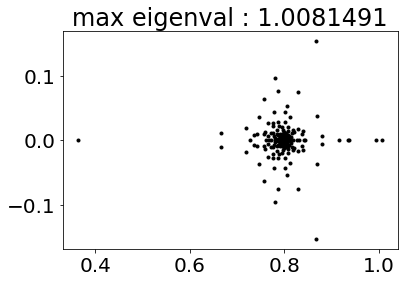

before: 4.104862e-07 2.8502686e-10
before: 4.104862e-07 2.8502686e-10
before: 4.104862e-07 2.8502686e-10
before: 4.104862e-07 2.8502686e-10
before: 4.104862e-07 2.8502686e-10
before: 4.104862e-07 2.8502686e-10
before: 4.104862e-07 2.8502686e-10
before: 4.104862e-07 2.8502686e-10
before: 4.104862e-07 2.8502686e-10
before: 4.104862e-07 2.8502686e-10


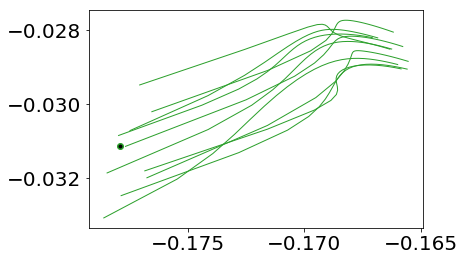

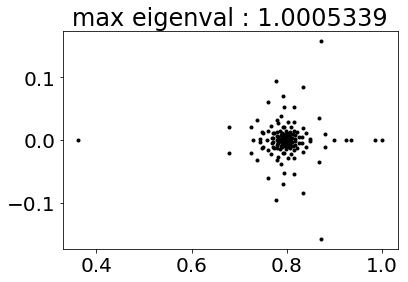

before: 4.0217589e-07 3.1863664e-10
before: 4.0217589e-07 3.1863664e-10
before: 4.0217589e-07 3.1863664e-10
before: 4.0217589e-07 3.1863664e-10
before: 4.0217589e-07 3.1863664e-10
before: 4.0217589e-07 3.1863664e-10
before: 4.0217589e-07 3.1863664e-10
before: 4.0217589e-07 3.1863664e-10
before: 4.0217589e-07 3.1863664e-10
before: 4.0217589e-07 3.1863664e-10


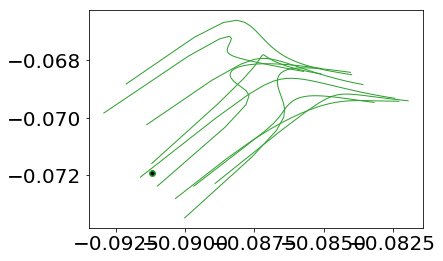

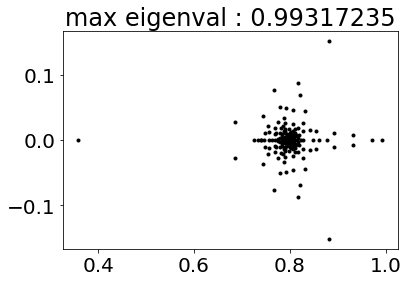

before: 4.1968912e-07 3.3921432e-10
before: 4.1968912e-07 3.3921432e-10
before: 4.1968912e-07 3.3921432e-10
before: 4.1968912e-07 3.3921432e-10
before: 4.1968912e-07 3.3921432e-10
before: 4.1968912e-07 3.3921432e-10
before: 4.1968912e-07 3.3921432e-10
before: 4.1968912e-07 3.3921432e-10
before: 4.1968912e-07 3.3921432e-10
before: 4.1968912e-07 3.3921432e-10


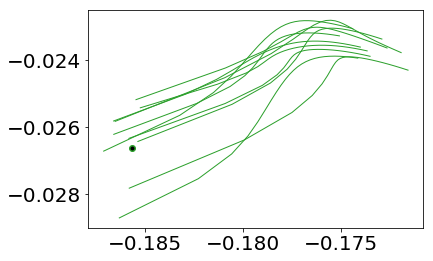

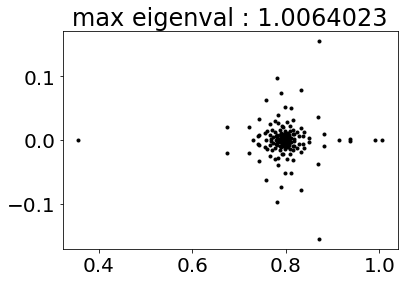

before: 3.8962781e-07 3.3990086e-10
before: 3.8962781e-07 3.3990086e-10
before: 3.8962781e-07 3.3990086e-10
before: 3.8962781e-07 3.3990086e-10
before: 3.8962781e-07 3.3990086e-10
before: 3.8962781e-07 3.3990086e-10
before: 3.8962781e-07 3.3990086e-10
before: 3.8962781e-07 3.3990086e-10
before: 3.8962781e-07 3.3990086e-10
before: 3.8962781e-07 3.3990086e-10


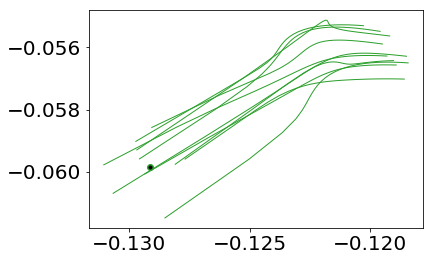

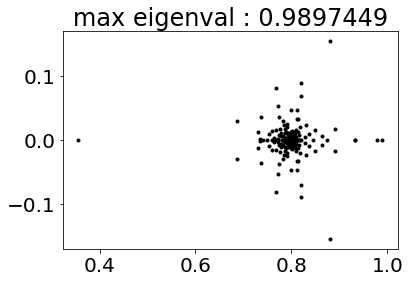

before: 5.513404e-07 3.9577844e-10
before: 5.513404e-07 3.9577844e-10
before: 5.513404e-07 3.9577844e-10
before: 5.513404e-07 3.9577844e-10
before: 5.513404e-07 3.9577844e-10
before: 5.513404e-07 3.9577844e-10
before: 5.513404e-07 3.9577844e-10
before: 5.513404e-07 3.9577844e-10
before: 5.513404e-07 3.9577844e-10
before: 5.513404e-07 3.9577844e-10


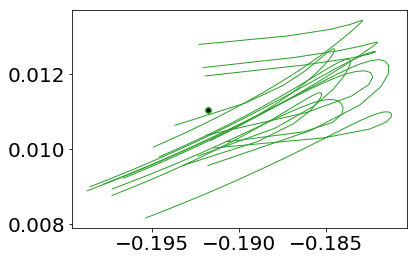

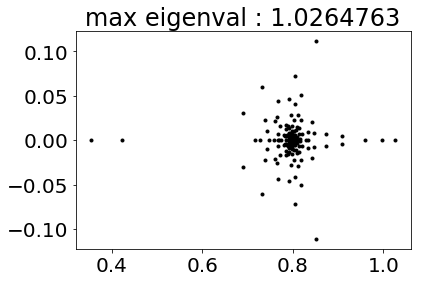

before: 4.5952092e-07 4.059449e-10
before: 4.5952092e-07 4.059449e-10
before: 4.5952092e-07 4.059449e-10
before: 4.5952092e-07 4.059449e-10
before: 4.5952092e-07 4.059449e-10
before: 4.5952092e-07 4.059449e-10
before: 4.5952092e-07 4.059449e-10
before: 4.5952092e-07 4.059449e-10
before: 4.5952092e-07 4.059449e-10
before: 4.5952092e-07 4.059449e-10


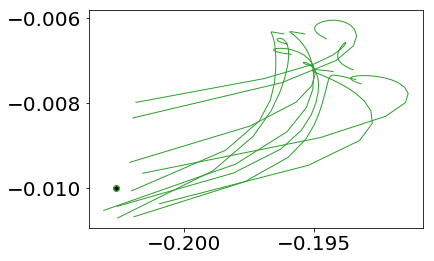

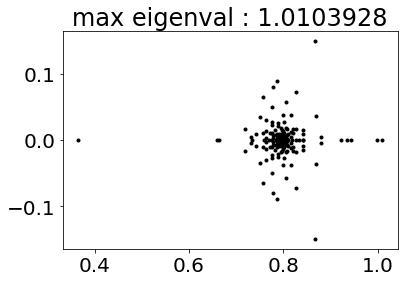

before: 4.88048e-07 5.773178e-10
before: 4.88048e-07 5.773178e-10
before: 4.88048e-07 5.773178e-10
before: 4.88048e-07 5.773178e-10
before: 4.88048e-07 5.773178e-10
before: 4.88048e-07 5.773178e-10
before: 4.88048e-07 5.773178e-10
before: 4.88048e-07 5.773178e-10
before: 4.88048e-07 5.773178e-10
before: 4.88048e-07 5.773178e-10


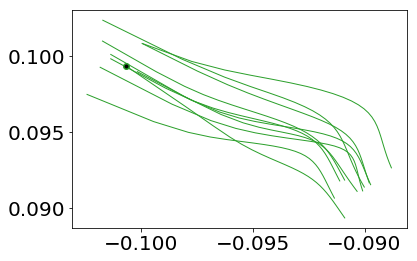

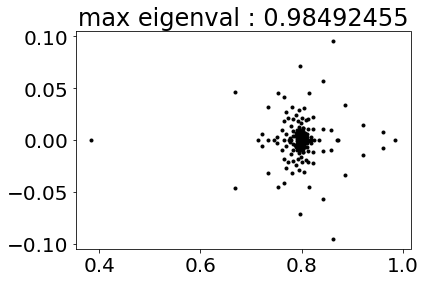

before: 4.6081126e-07 5.9057753e-10
before: 4.6081126e-07 5.9057753e-10
before: 4.6081126e-07 5.9057753e-10
before: 4.6081126e-07 5.9057753e-10
before: 4.6081126e-07 5.9057753e-10
before: 4.6081126e-07 5.9057753e-10
before: 4.6081126e-07 5.9057753e-10
before: 4.6081126e-07 5.9057753e-10
before: 4.6081126e-07 5.9057753e-10
before: 4.6081126e-07 5.9057753e-10


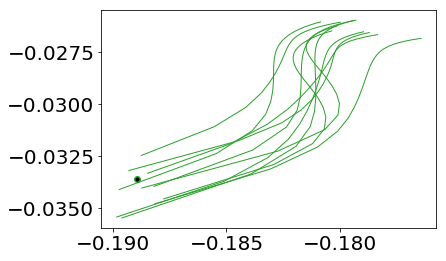

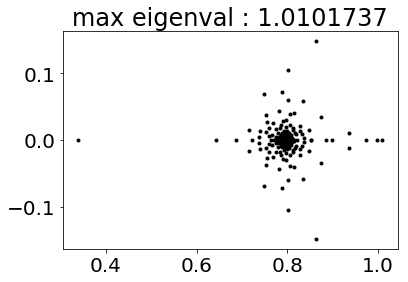

before: 5.5629016e-07 6.027132e-10
before: 5.5629016e-07 6.027132e-10
before: 5.5629016e-07 6.027132e-10
before: 5.5629016e-07 6.027132e-10
before: 5.5629016e-07 6.027132e-10
before: 5.5629016e-07 6.027132e-10
before: 5.5629016e-07 6.027132e-10
before: 5.5629016e-07 6.027132e-10
before: 5.5629016e-07 6.027132e-10
before: 5.5629016e-07 6.027132e-10


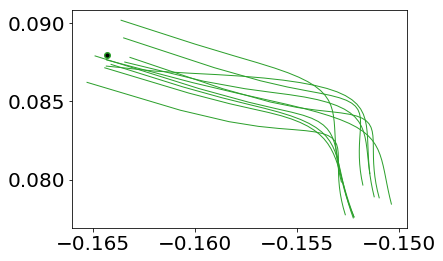

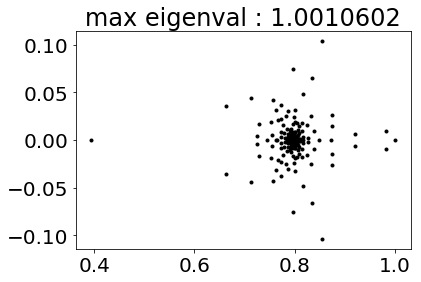

before: 5.409068e-07 6.058357e-10
before: 5.409068e-07 6.058357e-10
before: 5.409068e-07 6.058357e-10
before: 5.409068e-07 6.058357e-10
before: 5.409068e-07 6.058357e-10
before: 5.409068e-07 6.058357e-10
before: 5.409068e-07 6.058357e-10
before: 5.409068e-07 6.058357e-10
before: 5.409068e-07 6.058357e-10
before: 5.409068e-07 6.058357e-10


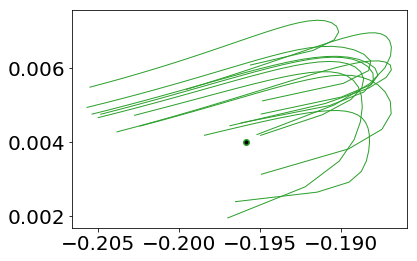

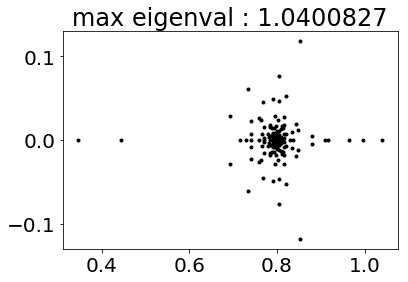

before: 4.2291123e-07 6.199845e-10
before: 4.2291123e-07 6.199845e-10
before: 4.2291123e-07 6.199845e-10
before: 4.2291123e-07 6.199845e-10
before: 4.2291123e-07 6.199845e-10
before: 4.2291123e-07 6.199845e-10
before: 4.2291123e-07 6.199845e-10
before: 4.2291123e-07 6.199845e-10
before: 4.2291123e-07 6.199845e-10
before: 4.2291123e-07 6.199845e-10


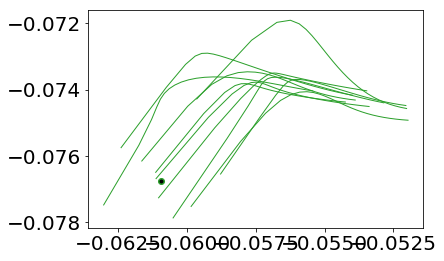

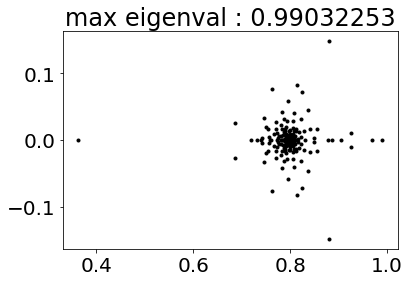

before: 6.190329e-07 6.6154265e-10
before: 6.190329e-07 6.6154265e-10
before: 6.190329e-07 6.6154265e-10
before: 6.190329e-07 6.6154265e-10
before: 6.190329e-07 6.6154265e-10
before: 6.190329e-07 6.6154265e-10
before: 6.190329e-07 6.6154265e-10
before: 6.190329e-07 6.6154265e-10
before: 6.190329e-07 6.6154265e-10
before: 6.190329e-07 6.6154265e-10


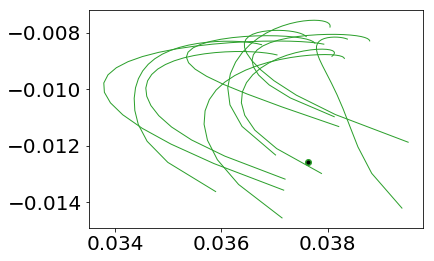

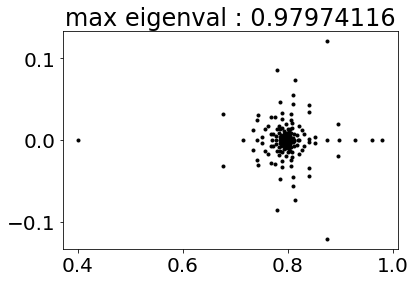

before: 4.177296e-07 7.0204115e-10
before: 4.177296e-07 7.0204115e-10
before: 4.177296e-07 7.0204115e-10
before: 4.177296e-07 7.0204115e-10
before: 4.177296e-07 7.0204115e-10
before: 4.177296e-07 7.0204115e-10
before: 4.177296e-07 7.0204115e-10
before: 4.177296e-07 7.0204115e-10
before: 4.177296e-07 7.0204115e-10
before: 4.177296e-07 7.0204115e-10


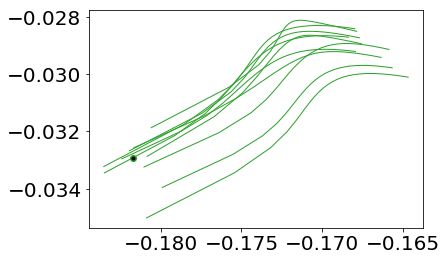

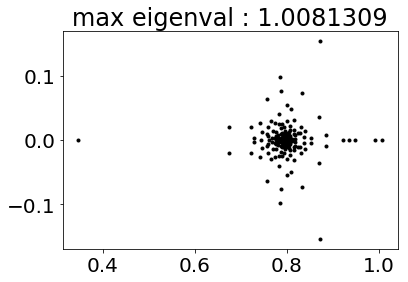

before: 5.517946e-07 7.5943263e-10
before: 5.517946e-07 7.5943263e-10
before: 5.517946e-07 7.5943263e-10
before: 5.517946e-07 7.5943263e-10
before: 5.517946e-07 7.5943263e-10
before: 5.517946e-07 7.5943263e-10
before: 5.517946e-07 7.5943263e-10
before: 5.517946e-07 7.5943263e-10
before: 5.517946e-07 7.5943263e-10
before: 5.517946e-07 7.5943263e-10


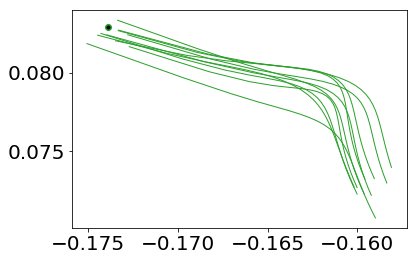

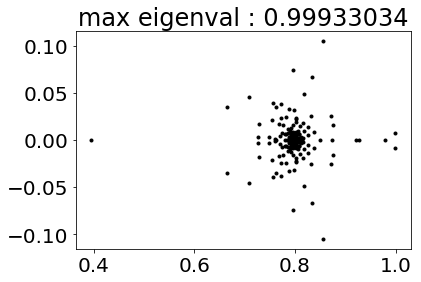

before: 5.6260075e-07 7.6210865e-10
before: 5.6260075e-07 7.6210865e-10
before: 5.6260075e-07 7.6210865e-10
before: 5.6260075e-07 7.6210865e-10
before: 5.6260075e-07 7.6210865e-10
before: 5.6260075e-07 7.6210865e-10
before: 5.6260075e-07 7.6210865e-10
before: 5.6260075e-07 7.6210865e-10
before: 5.6260075e-07 7.6210865e-10
before: 5.6260075e-07 7.6210865e-10


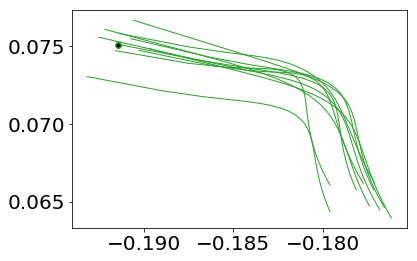

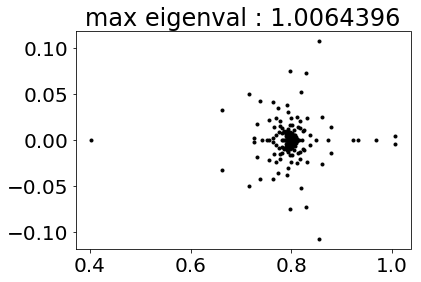

before: 5.5143295e-07 7.8841933e-10
before: 5.5143295e-07 7.8841933e-10
before: 5.5143295e-07 7.8841933e-10
before: 5.5143295e-07 7.8841933e-10
before: 5.5143295e-07 7.8841933e-10
before: 5.5143295e-07 7.8841933e-10
before: 5.5143295e-07 7.8841933e-10
before: 5.5143295e-07 7.8841933e-10
before: 5.5143295e-07 7.8841933e-10
before: 5.5143295e-07 7.8841933e-10


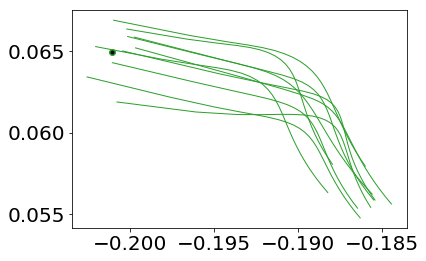

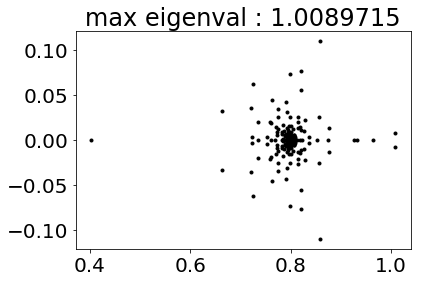

before: 5.290858e-07 7.925599e-10
before: 5.290858e-07 7.925599e-10
before: 5.290858e-07 7.925599e-10
before: 5.290858e-07 7.925599e-10
before: 5.290858e-07 7.925599e-10
before: 5.290858e-07 7.925599e-10
before: 5.290858e-07 7.925599e-10
before: 5.290858e-07 7.925599e-10
before: 5.290858e-07 7.925599e-10
before: 5.290858e-07 7.925599e-10


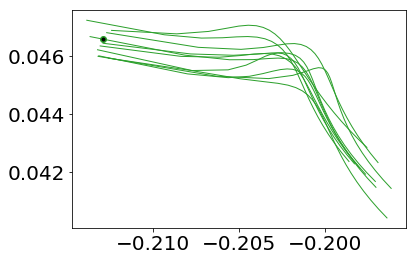

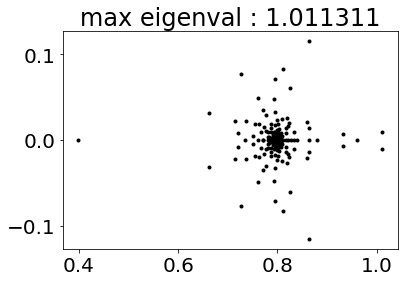

before: 4.7228968e-07 8.420992e-10
before: 4.7228968e-07 8.420992e-10
before: 4.7228968e-07 8.420992e-10
before: 4.7228968e-07 8.420992e-10
before: 4.7228968e-07 8.420992e-10
before: 4.7228968e-07 8.420992e-10
before: 4.7228968e-07 8.420992e-10
before: 4.7228968e-07 8.420992e-10
before: 4.7228968e-07 8.420992e-10
before: 4.7228968e-07 8.420992e-10


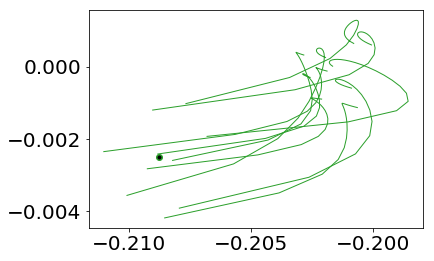

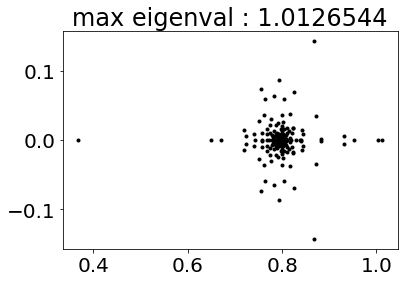

before: 5.213036e-07 8.5142704e-10
before: 5.213036e-07 8.5142704e-10
before: 5.213036e-07 8.5142704e-10
before: 5.213036e-07 8.5142704e-10
before: 5.213036e-07 8.5142704e-10
before: 5.213036e-07 8.5142704e-10
before: 5.213036e-07 8.5142704e-10
before: 5.213036e-07 8.5142704e-10
before: 5.213036e-07 8.5142704e-10
before: 5.213036e-07 8.5142704e-10


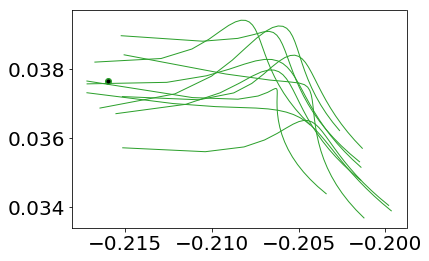

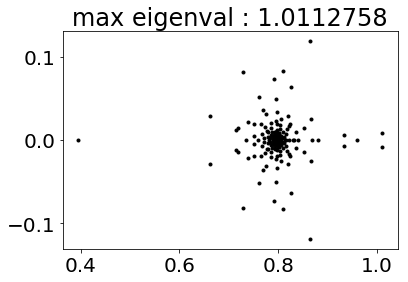

before: 4.817209e-07 9.050121e-10
before: 4.817209e-07 9.050121e-10
before: 4.817209e-07 9.050121e-10
before: 4.817209e-07 9.050121e-10
before: 4.817209e-07 9.050121e-10
before: 4.817209e-07 9.050121e-10
before: 4.817209e-07 9.050121e-10
before: 4.817209e-07 9.050121e-10
before: 4.817209e-07 9.050121e-10
before: 4.817209e-07 9.050121e-10


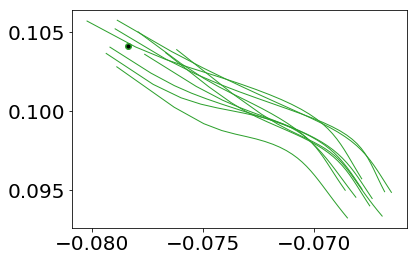

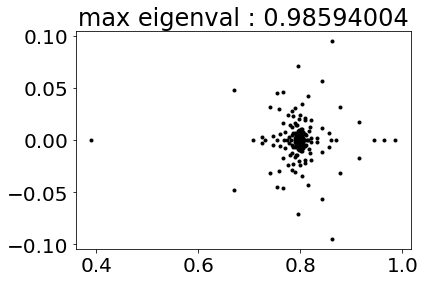

In [25]:
cmap=plt.get_cmap('tab20')
rand_step_coef = .001

trial = generate_trials('delayanti', hparams, mode='test', noise_on=False, batch_size = 128, delay_fac =1)
# Input during fixed point epoch
x_star = trial.x[trial.epochs[fp_epoch][1]-1,0,:]  

# Make a one parameter function of thie hidden state, useful for jacobians.
rnn_fun = lambda h : rnn_vanilla(params, h, x_star, alpha)
batch_rnn_fun = vmap(rnn_fun, in_axes=(0,))

s = 8
fp_epoch = 'stim1'

fldr = os.path.join(model_dir_all,'fps',rule)
filename = fldr +'/'+ fp_epoch + '_' +  str(-9) + '_' + str(s)+'.npz'
load_all_fps = np.load(filename)
sorted_fps, eig_decomps = eig_decomp(load_all_fps['fps'])

T = range(trial.epochs[fp_epoch][0],trial.epochs[fp_epoch][1]-1)
x_star = trial.x[T,s,:]
c = cmap(s/num_trials)

for nfp in range(np.shape(load_all_fps['fps'])[0]):
    h0 = np.squeeze(load_all_fps['fps'][nfp,:])

    for bump_num in range(10):
        h = h0 + rand_step_coef*npr.randn(N)
        h_t = vanilla_run_at_fp(params, x_star, h, alpha)
        
        h_new = rnn_vanilla(params, h0, x_star[0,:], alpha)
        print('before:',np.mean((h_new - h0)**2),load_all_fps['losses'][nfp])

        X_trial = onp.dot(h_t,D)
        plt.plot(X_trial[:,0],X_trial[:,1],'-',c = c, linewidth = 1)

    X_trial = onp.dot(h0.T,D)
    plt.plot(X_trial[0],X_trial[1],'o',c = c, linewidth = 2)
    plt.plot(X_trial[0],X_trial[1],'.k', linewidth = 2)
    plt.show()

    plt.plot(eig_decomps[nfp]['evals'].real,eig_decomps[nfp]['evals'].imag,'.k')
    plt.title('max eigenval : ' +str(np.max(eig_decomps[nfp]['evals'].real)))
    plt.show()



In [196]:
rule = 'delaygo'
fldr = os.path.join(model_dir_all,'golub_fixed_pts',rule)
fp_epoch = 'go1'
f = '_0.0'
filename = fldr +'/'+ fp_epoch + f + '.npy'
load_all_fps = np.load(filename)

In [199]:
print(load_all_fps)

{'qstar': array([2.71714498e-07, 2.72569309e-07, 3.26789291e-07, 3.26680180e-07,
       3.25066082e-07, 3.22543883e-07, 3.18086109e-07, 3.17809906e-07,
       3.16471215e-07, 3.14760342e-07, 3.20685444e-07, 3.19066288e-07,
       3.08584333e-07, 3.17474132e-07, 3.11685540e-07, 3.08267147e-07,
       2.96812289e-07, 2.94845620e-07, 3.18662785e-07, 3.37076528e-07,
       3.20169818e-07, 2.19390245e-07, 2.67549979e-07, 2.41679061e-07,
       2.40846362e-07, 2.64961756e-07, 2.45205911e-07, 2.47953494e-07,
       2.45882916e-07, 2.36549454e-07, 2.45060789e-07, 2.26247266e-07,
       2.32429755e-07, 2.37582299e-07, 2.17905807e-07, 2.43896608e-07,
       2.18845997e-07, 2.04882895e-07, 2.29713962e-07, 2.18467335e-07,
       2.88749106e-07, 2.89734288e-07, 3.09782507e-07, 3.08921955e-07,
       3.24911781e-07, 4.46116417e-07, 3.40873868e-07, 3.54110512e-07,
       3.61066327e-07, 3.69273266e-07, 3.83674148e-07, 3.98988732e-07,
       4.42851842e-07, 4.43002421e-07, 4.77052765e-07, 3.35737070e-

In [201]:
for epoch in trial.epochs.keys():
    print(epoch)

delay1
stim1
go1
fix1


NameError: name 'fp_tols' is not defined

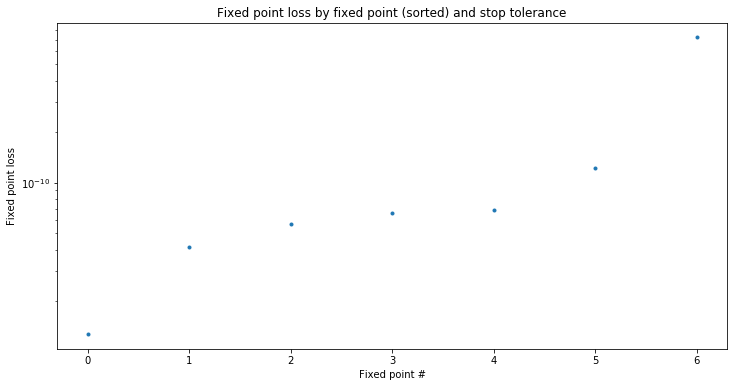

<Figure size 864x288 with 0 Axes>

In [21]:
f1 = plt.figure(figsize=(12,6))

plt.semilogy(load_all_fps['losses'],'.'); 
plt.xlabel('Fixed point #')
plt.ylabel('Fixed point loss');
plt.title('Fixed point loss by fixed point (sorted) and stop tolerance')

f2 = plt.figure(figsize=(12,4))

pidx = 1
nfp_tols = len(fp_tols)
for tol_idx, tol in enumerate(fp_tols):
    plt.subplot(1, nfp_tols, pidx); pidx += 1
    plt.hist(onp.log10(fp_loss_fun(all_fps[tol]['fps'])), 50);
    plt.xlabel('log10(FP loss)')
    plt.title('Tolerance: ' + str(tol));

In [269]:
load_all_fps['hps']

array({'opt_print_every': 100, 'adam_eps': 1e-05, 'adam_b1': 0.9, 'adam_b2': 0.999, 'unique_tol': 0.025, 'noise_var': 0.0001, 'decay_factor': 0.9999, 'decay_steps': 1, 'step_size': 0.5, 'fp_opt_stop_tol': 1e-09, 'num_batches': 10000, 'outlier_tol': 1.0, 'fp_tol': 1e-09},
      dtype=object)